In [1]:
import os
from glob import glob

import random
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
import torch.utils.data as data
from torchvision import datasets, transforms
import matplotlib.pyplot as plt
from torch.utils.data import Dataset, DataLoader
import unet_model as UNET
import cv2
import csv
from helper import load_obj
from scipy.spatial.transform import Rotation as R
from numpy.linalg import inv

import numpy as np
from PIL import Image
import warnings
warnings.filterwarnings(action='ignore')
#torch.backends.cudnn.benchmark = False

# Hyperparameter

In [2]:
print('Num_GPU :', torch.cuda.device_count())

no_cuda = False
use_cuda = not no_cuda and torch.cuda.is_available()
device = torch.device("cuda" if use_cuda else "cpu")
Tensor = torch.cuda.FloatTensor if use_cuda else torch.Tensor

params = {
    'batch_size':2 * torch.cuda.device_count(),
    'test_batch_size':2 * torch.cuda.device_count(),
    'input_size':256,
    'resize_scale':280,
    'crop_size':256,
    'fliplr':False,
    'rot':True,
    #model params
    'epoch_count':1,
    'epochs':200,
    'log_interval':100,
    'lr':0.0003,
    'dataroot':'C:/Users/IVCL/Desktop/crane',
}

Num_GPU : 2


# Utils

In [3]:
def to_np(x):
    return x.data.cpu().numpy()
        
def plot_train_result(test_image, epoch, save=False,  show=True, fig_size=(15, 15)):
    plt.figure(figsize=fig_size)
    imgs = [to_np(test_image[0]), to_np(test_image[1]), test_image[2], to_np(test_image[3]), test_image[4],
           to_np(test_image[5]), test_image[6]]
    title = ["Test Image", "Test Mask", "Predicted Mask", "Test U Mask", "Predicted U Mask", "Test V Mask", "Predicted V Mask"]
        
    plt.subplot(1, 7, 1)
    plt.title(title[0])
    img = imgs[0]
    img = img.squeeze()
    img = (((img - img.min()) * 255) / (img.max() - img.min())).transpose(1, 2, 0).astype(np.uint8)
    plt.imshow(img)
    plt.axis('off')

    plt.subplot(1, 7, 2)
    plt.title(title[1])
    img = imgs[1]
    img = img.squeeze()
    img = (((img - img.min()) * 255) / (img.max() - img.min()))
    plt.imshow(img, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 7, 3)
    plt.title(title[2])
    img = imgs[2]
    img = img.squeeze()
    img = to_np(torch.argmax(img, dim=0))
    plt.imshow(img, cmap='gray')
    plt.axis('off')
    
    plt.subplot(1, 7, 4)
    plt.title(title[3])
    img = imgs[3]
    img = img.squeeze()
    img = (((img - img.min()) * 255) / (img.max() - img.min()))
    plt.imshow(img, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 7, 5)
    plt.title(title[4])
    img = imgs[4]
    img = img.squeeze()
    img = to_np(torch.argmax(img, dim=0))
    plt.imshow(img, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 7, 6)
    plt.title(title[5])
    img = imgs[5]
    img = img.squeeze()
    img = (((img - img.min()) * 255) / (img.max() - img.min()))
    plt.imshow(img, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 7, 7)
    plt.title(title[6])
    img = imgs[6]
    img = img.squeeze()
    img = to_np(torch.argmax(img, dim=0))
    plt.imshow(img, cmap='gray')
    plt.axis('off')
    
    # save figure
    if save:
        save_fn = './img_per_epoch/epoch_{:d}'.format(epoch+1) + '.png'
        fig.savefig(save_fn)

    if show:
        plt.show()
    else:
        plt.close()

# Model

In [4]:
correspondence_block = UNET.UNet(
        n_channels=3, out_channels_id=2, out_channels_uv=256, bilinear=True)
correspondence_block = nn.DataParallel(correspondence_block)
correspondence_block.to(device)

DataParallel(
  (module): UNet(
    (inc): DoubleConv(
      (double_conv): Sequential(
        (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (5): ReLU(inplace=True)
      )
    )
    (down1): Down(
      (maxpool_conv): Sequential(
        (0): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
        (1): DoubleConv(
          (double_conv): Sequential(
            (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): ReLU(inplace=True)
            (3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), p

# Preprocess

In [5]:
train_image_paths = glob(params['dataroot'] + '/image_coco_512_aug/*.png')[2001:]
train_mask_paths = glob(params['dataroot'] + '/mask_coco_512/*.png')[2001:]
train_u_mask_paths = glob(params['dataroot'] + '/U_mask_coco_512/*.png')[2001:]
train_v_mask_paths = glob(params['dataroot'] + '/V_mask_coco_512/*.png')[2001:]

val_image_paths = glob(params['dataroot'] + '/image_coco_512_aug/*.png')[:2001]
val_mask_paths = glob(params['dataroot'] + '/mask_coco_512/*.png')[:2001]
val_u_mask_paths = glob(params['dataroot'] + '/U_mask_coco_512/*.png')[:2001]
val_v_mask_paths = glob(params['dataroot'] + '/V_mask_coco_512/*.png')[:2001]

test_image_paths = glob(params['dataroot'] + '/real_image/*.png')
test_mask_paths = glob(params['dataroot'] + '/real_mask/*.png')

In [6]:
class DatasetFromFolder(data.Dataset):
    def __init__(self, image_dir, mask_dir, u_mask_dir, v_mask_dir, transform=None, resize_scale=None, rot=None, crop_size=None,
                 fliplr=False):
        super(DatasetFromFolder, self).__init__()
        self.image_path = image_dir
        self.mask_path = mask_dir
        self.u_mask_path = u_mask_dir
        self.v_mask_path = v_mask_dir
        
        self.transform = transform
        
        self.resize_scale = resize_scale
        self.rot = rot
        self.crop_size = crop_size
        self.fliplr = fliplr

    def __getitem__(self, index):
        # Load Image
        img_fn = self.image_path[index]
        mask_fn = self.mask_path[index]
        u_mask_fn = self.u_mask_path[index]
        v_mask_fn = self.v_mask_path[index]
        
        img = cv2.imread(img_fn)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        mask = cv2.imread(mask_fn, cv2.IMREAD_GRAYSCALE)
        u_mask = cv2.imread(u_mask_fn, cv2.IMREAD_GRAYSCALE)
        v_mask = cv2.imread(v_mask_fn, cv2.IMREAD_GRAYSCALE)
        
        seed = random.randint(1, 1000)
        random.seed(seed)
                          
        # preprocessing
        if self.resize_scale:
            img = cv2.resize(img, (self.resize_scale, self.resize_scale), cv2.INTER_CUBIC)
            mask = cv2.resize(mask, (self.resize_scale, self.resize_scale), cv2.INTER_CUBIC)
            u_mask = cv2.resize(u_mask, (self.resize_scale, self.resize_scale), cv2.INTER_CUBIC)
            v_mask = cv2.resize(v_mask, (self.resize_scale, self.resize_scale), cv2.INTER_CUBIC)
                   
        if self.crop_size:
            x = random.randint(0, self.resize_scale - self.crop_size)
            y = random.randint(0, self.resize_scale - self.crop_size)
            img = img[x:x + self.crop_size, y:y + self.crop_size]
            mask = mask[x:x + self.crop_size, y:y + self.crop_size]
            u_mask = u_mask[x:x + self.crop_size, y:y + self.crop_size]
            v_mask = v_mask[x:x + self.crop_size, y:y + self.crop_size]
        
        if self.rot:
            height, width, channel = img.shape
            temp_img = img
            angle = random.randint(-15, 15)
            matrix = cv2.getRotationMatrix2D((width/2, height/2), angle, 1)
            img = cv2.warpAffine(img, matrix, (width, height))
            for i in range(height):
                for j in range(width):
                    if img[i,j,0]==0 and img[i,j,1]==0 and img[i,j,2]==0:
                        img[i,j]=temp_img[i,j]
            mask = cv2.warpAffine(mask, matrix, (width, height))
            u_mask = cv2.warpAffine(u_mask, matrix, (width, height))
            v_mask = cv2.warpAffine(v_mask, matrix, (width, height))
        
        if self.fliplr:
            if random.random() < 0.5:
                img = cv2.flip(img, 1)
                mask = cv2.flip(mask, 1)
                u_mask = cv2.flip(u_mask, 1)
                v_mask = cv2.flip(v_mask, 1)
        
        mask = np.where(mask>0,1.0,0)
               
        if self.transform is not None:
            img = self.transform(img)
        else:
            transform = transforms.ToTensor()
            img = transform(img)
        mask = (torch.from_numpy(mask)).type(torch.double)
        u_mask = (torch.from_numpy(u_mask)).type(torch.int64)
        v_mask = (torch.from_numpy(v_mask)).type(torch.int64)        
        
        return img, mask, u_mask, v_mask
                                              
    def __len__(self):
        return len(self.image_path)

In [7]:
transform = transforms.Compose([transforms.ToTensor(),
                                transforms.ToPILImage(),
                                transforms.ColorJitter(brightness=(0.2,1), contrast=(0.3,2), saturation=(0.2,2), hue=(-0.1,0.1)),
                                transforms.ToTensor()])

train_data = DatasetFromFolder(train_image_paths, train_mask_paths, train_u_mask_paths, train_v_mask_paths, transform=transform,
                               resize_scale=params['resize_scale'], rot=params['rot'], crop_size=params['crop_size'],
                               fliplr=params['fliplr'])
train_data_loader = torch.utils.data.DataLoader(dataset=train_data, batch_size=params['batch_size'], shuffle=True)

val_data = DatasetFromFolder(val_image_paths, val_mask_paths, val_u_mask_paths, val_v_mask_paths, transform=None,
                             resize_scale=params['input_size'])
val_data_loader = torch.utils.data.DataLoader(dataset=val_data, batch_size=params['test_batch_size'], shuffle=False)

In [8]:
for i, (data, mask, u_mask, v_mask) in enumerate(train_data_loader):
    if i == 0:
        print(data[0].shape, mask[0].shape, u_mask[0].shape, v_mask[0].shape)
        break

torch.Size([3, 256, 256]) torch.Size([256, 256]) torch.Size([256, 256]) torch.Size([256, 256])


(-0.5, 255.5, 255.5, -0.5)

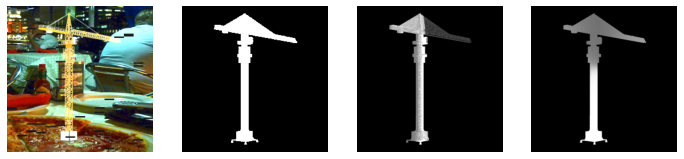

In [9]:
# Get specific val images
val_image, val_mask, val_u_mask, val_v_mask = val_data.__getitem__(5) # Convert to 4d tensor (BxNxHxW)
val_image = val_image.unsqueeze(0)

val_data_image = ((val_image - val_image.min()) / (val_image.max() - val_image.min()))

plt.figure(figsize=(12,12))
plt.subplot(1,4,1)
plt.imshow(val_data_image[0].permute(1,2,0))
plt.axis('off')
plt.subplot(1,4,2)
plt.imshow(val_mask,'gray')
plt.axis('off')
plt.subplot(1,4,3)
plt.imshow(val_u_mask,'gray')
plt.axis('off')
plt.subplot(1,4,4)
plt.imshow(val_v_mask,'gray')
plt.axis('off')

# Optimization

In [10]:
# setup optimizer
optimizer = optim.Adam(correspondence_block.parameters(), lr=params['lr'], weight_decay=3e-5)
criterion_m = nn.CrossEntropyLoss()
criterion_u = nn.CrossEntropyLoss()
criterion_v = nn.CrossEntropyLoss()

# Visualization

In [11]:
def visualization(model, test_path):
    model.eval()
    model.to(device)
    transform = transforms.Compose([transforms.ToTensor(),
                                transforms.ColorJitter(brightness=0, contrast=0, saturation=0, hue=0)])

    image = cv2.imread(test_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image = cv2.resize(image, (params['input_size'], params['input_size']), cv2.INTER_CUBIC)
    image= transform(image).unsqueeze_(0)
    mask, u_mask, v_mask = model(image)

    mask = mask.squeeze()
    mask_out = to_np(torch.argmax(mask, dim=0))
    
    u_mask = u_mask.squeeze()
    u_mask_out = to_np(torch.argmax(u_mask, dim=0))   
    
    v_mask = v_mask.squeeze()
    v_mask_out = to_np(torch.argmax(v_mask, dim=0)) 
    
    test_image = plt.imread(test_path)
    
    plt.figure(figsize=(12,12))
    display_list = [test_image, mask_out, u_mask_out, v_mask_out]
    title = ['Input Image', 'Predicted Mask', 'Predicted U Mask', 'Predicted V Mask']
       
    plt.subplot(1, 4, 1)
    plt.title(title[0])
    plt.imshow(display_list[0])
    plt.axis('off')
        
    plt.subplot(1, 4, 2)
    plt.title(title[1])
    plt.imshow(display_list[1], 'gray')
    plt.axis('off')
    
    plt.subplot(1, 4, 3)
    plt.title(title[2])
    plt.imshow(display_list[2], 'gray')
    plt.axis('off')
    
    plt.subplot(1, 4, 4)
    plt.title(title[3])
    plt.imshow(display_list[3], 'gray')
    plt.axis('off') 
    
    plt.show()

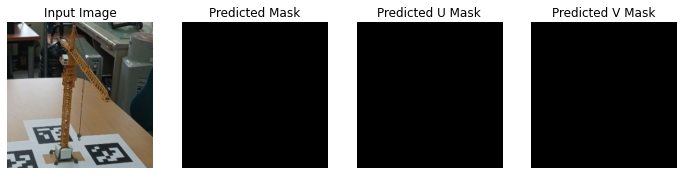

In [12]:
test_path = 'C:/Users/IVCL/Desktop/crane/real_image_crop/creal_0065.png'
visualization(correspondence_block, test_path)

# Training

In [13]:
checkpoint_path = './checkpoints/cpb_unet_aug2'

===> Epoch[1/200](0/500): Loss_Mask: 0.8260	Loss_U_Mask: 5.5863	Loss_V_Mask: 5.5868
===> Epoch[1/200](100/500): Loss_Mask: 0.3494	Loss_U_Mask: 1.0165	Loss_V_Mask: 0.8571
===> Epoch[1/200](200/500): Loss_Mask: 0.2223	Loss_U_Mask: 0.9135	Loss_V_Mask: 0.7186
===> Epoch[1/200](300/500): Loss_Mask: 0.1055	Loss_U_Mask: 0.7155	Loss_V_Mask: 0.5249
===> Epoch[1/200](400/500): Loss_Mask: 0.1407	Loss_U_Mask: 0.7024	Loss_V_Mask: 0.5639
===> Epoch[1/200](500/500): Loss_Mask: 0.0865	Loss_U_Mask: 0.6880	Loss_V_Mask: 0.4870
Val_Loss_Mask: 0.1603	Val_U_Loss_Mask: 0.6268	Val_V_Loss_Mask: 0.4622


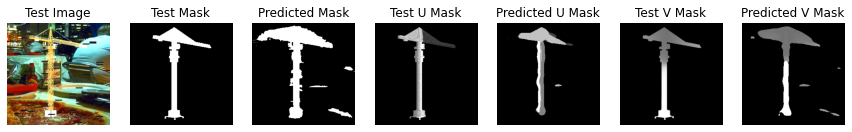

===> Epoch[2/200](0/500): Loss_Mask: 0.1197	Loss_U_Mask: 0.6465	Loss_V_Mask: 0.4899
===> Epoch[2/200](100/500): Loss_Mask: 0.0734	Loss_U_Mask: 0.6517	Loss_V_Mask: 0.4559
===> Epoch[2/200](200/500): Loss_Mask: 0.0702	Loss_U_Mask: 0.5591	Loss_V_Mask: 0.3890
===> Epoch[2/200](300/500): Loss_Mask: 0.0720	Loss_U_Mask: 0.5633	Loss_V_Mask: 0.3956
===> Epoch[2/200](400/500): Loss_Mask: 0.0731	Loss_U_Mask: 0.5301	Loss_V_Mask: 0.3820
===> Epoch[2/200](500/500): Loss_Mask: 0.1000	Loss_U_Mask: 0.6173	Loss_V_Mask: 0.4363
Val_Loss_Mask: 0.0762	Val_U_Loss_Mask: 0.5352	Val_V_Loss_Mask: 0.3700


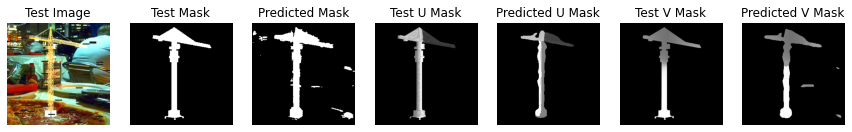

===> Epoch[3/200](0/500): Loss_Mask: 0.1046	Loss_U_Mask: 0.6455	Loss_V_Mask: 0.4621
===> Epoch[3/200](100/500): Loss_Mask: 0.0694	Loss_U_Mask: 0.6901	Loss_V_Mask: 0.4683
===> Epoch[3/200](200/500): Loss_Mask: 0.0511	Loss_U_Mask: 0.5166	Loss_V_Mask: 0.3536
===> Epoch[3/200](300/500): Loss_Mask: 0.0513	Loss_U_Mask: 0.6774	Loss_V_Mask: 0.4093
===> Epoch[3/200](400/500): Loss_Mask: 0.0608	Loss_U_Mask: 0.6401	Loss_V_Mask: 0.4171
===> Epoch[3/200](500/500): Loss_Mask: 0.0350	Loss_U_Mask: 0.6038	Loss_V_Mask: 0.3707
Val_Loss_Mask: 0.1045	Val_U_Loss_Mask: 0.5686	Val_V_Loss_Mask: 0.3943


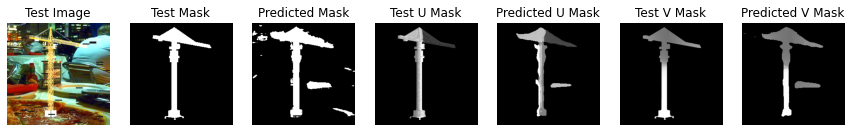

===> Epoch[4/200](0/500): Loss_Mask: 0.0274	Loss_U_Mask: 0.5605	Loss_V_Mask: 0.3402
===> Epoch[4/200](100/500): Loss_Mask: 0.0562	Loss_U_Mask: 0.6936	Loss_V_Mask: 0.4280
===> Epoch[4/200](200/500): Loss_Mask: 0.0619	Loss_U_Mask: 0.6716	Loss_V_Mask: 0.4161
===> Epoch[4/200](300/500): Loss_Mask: 0.0562	Loss_U_Mask: 0.6259	Loss_V_Mask: 0.3589
===> Epoch[4/200](400/500): Loss_Mask: 0.0308	Loss_U_Mask: 0.6286	Loss_V_Mask: 0.3265
===> Epoch[4/200](500/500): Loss_Mask: 0.0865	Loss_U_Mask: 0.5615	Loss_V_Mask: 0.3836
Val_Loss_Mask: 0.0615	Val_U_Loss_Mask: 0.4915	Val_V_Loss_Mask: 0.2834


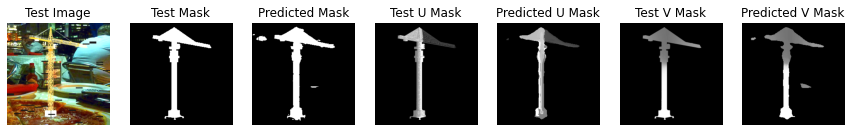

===> Epoch[5/200](0/500): Loss_Mask: 0.0538	Loss_U_Mask: 0.5843	Loss_V_Mask: 0.3423
===> Epoch[5/200](100/500): Loss_Mask: 0.0310	Loss_U_Mask: 0.5988	Loss_V_Mask: 0.3267
===> Epoch[5/200](200/500): Loss_Mask: 0.0335	Loss_U_Mask: 0.5677	Loss_V_Mask: 0.3150
===> Epoch[5/200](300/500): Loss_Mask: 0.0387	Loss_U_Mask: 0.6006	Loss_V_Mask: 0.3246
===> Epoch[5/200](400/500): Loss_Mask: 0.0547	Loss_U_Mask: 0.5437	Loss_V_Mask: 0.3635
===> Epoch[5/200](500/500): Loss_Mask: 0.0328	Loss_U_Mask: 0.5091	Loss_V_Mask: 0.2877
Val_Loss_Mask: 0.0438	Val_U_Loss_Mask: 0.4717	Val_V_Loss_Mask: 0.2547


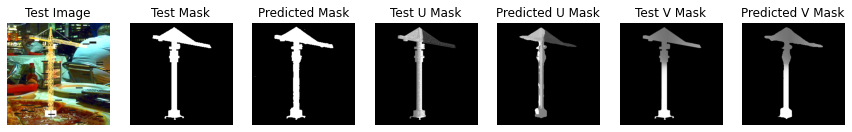

===> Epoch[6/200](0/500): Loss_Mask: 0.0480	Loss_U_Mask: 0.5656	Loss_V_Mask: 0.3300
===> Epoch[6/200](100/500): Loss_Mask: 0.0260	Loss_U_Mask: 0.5518	Loss_V_Mask: 0.3080
===> Epoch[6/200](200/500): Loss_Mask: 0.0250	Loss_U_Mask: 0.5241	Loss_V_Mask: 0.2642
===> Epoch[6/200](300/500): Loss_Mask: 0.0278	Loss_U_Mask: 0.6065	Loss_V_Mask: 0.2991
===> Epoch[6/200](400/500): Loss_Mask: 0.0224	Loss_U_Mask: 0.5709	Loss_V_Mask: 0.2792
===> Epoch[6/200](500/500): Loss_Mask: 0.0294	Loss_U_Mask: 0.5061	Loss_V_Mask: 0.2951
Val_Loss_Mask: 0.0480	Val_U_Loss_Mask: 0.4654	Val_V_Loss_Mask: 0.2474


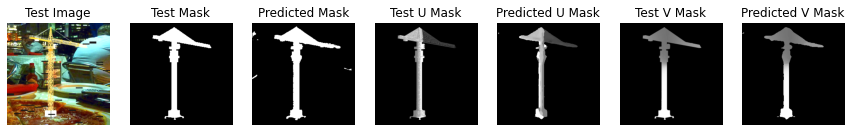

===> Epoch[7/200](0/500): Loss_Mask: 0.0232	Loss_U_Mask: 0.5886	Loss_V_Mask: 0.2911
===> Epoch[7/200](100/500): Loss_Mask: 0.0190	Loss_U_Mask: 0.5853	Loss_V_Mask: 0.2784
===> Epoch[7/200](200/500): Loss_Mask: 0.0268	Loss_U_Mask: 0.5420	Loss_V_Mask: 0.2788
===> Epoch[7/200](300/500): Loss_Mask: 0.0264	Loss_U_Mask: 0.4596	Loss_V_Mask: 0.2631
===> Epoch[7/200](400/500): Loss_Mask: 0.0214	Loss_U_Mask: 0.5727	Loss_V_Mask: 0.2707
===> Epoch[7/200](500/500): Loss_Mask: 0.0341	Loss_U_Mask: 0.5572	Loss_V_Mask: 0.2977
Val_Loss_Mask: 0.0424	Val_U_Loss_Mask: 0.4597	Val_V_Loss_Mask: 0.2414


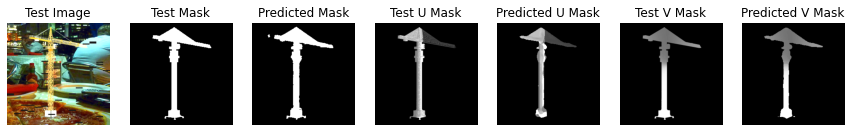

===> Epoch[8/200](0/500): Loss_Mask: 0.0211	Loss_U_Mask: 0.4693	Loss_V_Mask: 0.2476
===> Epoch[8/200](100/500): Loss_Mask: 0.0205	Loss_U_Mask: 0.4820	Loss_V_Mask: 0.2494
===> Epoch[8/200](200/500): Loss_Mask: 0.0224	Loss_U_Mask: 0.5075	Loss_V_Mask: 0.2689
===> Epoch[8/200](300/500): Loss_Mask: 0.0260	Loss_U_Mask: 0.5155	Loss_V_Mask: 0.2757
===> Epoch[8/200](400/500): Loss_Mask: 0.0200	Loss_U_Mask: 0.5907	Loss_V_Mask: 0.2644
===> Epoch[8/200](500/500): Loss_Mask: 0.0255	Loss_U_Mask: 0.4531	Loss_V_Mask: 0.2404
Val_Loss_Mask: 0.0387	Val_U_Loss_Mask: 0.4557	Val_V_Loss_Mask: 0.2280


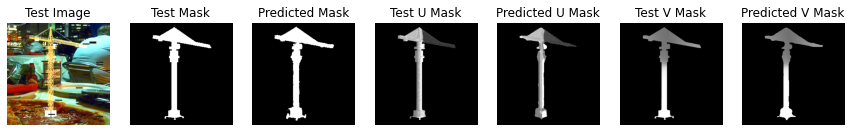

===> Epoch[9/200](0/500): Loss_Mask: 0.0365	Loss_U_Mask: 0.6018	Loss_V_Mask: 0.3144
===> Epoch[9/200](100/500): Loss_Mask: 0.0327	Loss_U_Mask: 0.5749	Loss_V_Mask: 0.3025
===> Epoch[9/200](200/500): Loss_Mask: 0.0167	Loss_U_Mask: 0.5523	Loss_V_Mask: 0.2496
===> Epoch[9/200](300/500): Loss_Mask: 0.0205	Loss_U_Mask: 0.4884	Loss_V_Mask: 0.2383
===> Epoch[9/200](400/500): Loss_Mask: 0.0468	Loss_U_Mask: 0.6353	Loss_V_Mask: 0.3299
===> Epoch[9/200](500/500): Loss_Mask: 0.0249	Loss_U_Mask: 0.5342	Loss_V_Mask: 0.2805
Val_Loss_Mask: 0.0441	Val_U_Loss_Mask: 0.4505	Val_V_Loss_Mask: 0.2256


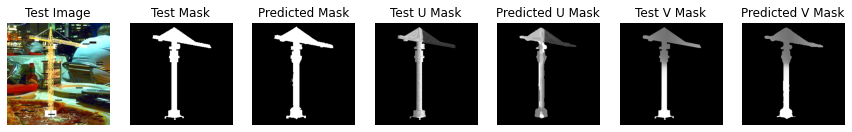

===> Epoch[10/200](0/500): Loss_Mask: 0.0220	Loss_U_Mask: 0.4566	Loss_V_Mask: 0.2316
===> Epoch[10/200](100/500): Loss_Mask: 0.0351	Loss_U_Mask: 0.5411	Loss_V_Mask: 0.2888
===> Epoch[10/200](200/500): Loss_Mask: 0.0210	Loss_U_Mask: 0.4740	Loss_V_Mask: 0.2506
===> Epoch[10/200](300/500): Loss_Mask: 0.0291	Loss_U_Mask: 0.5097	Loss_V_Mask: 0.3076
===> Epoch[10/200](400/500): Loss_Mask: 0.0203	Loss_U_Mask: 0.5829	Loss_V_Mask: 0.2612
===> Epoch[10/200](500/500): Loss_Mask: 0.0143	Loss_U_Mask: 0.4922	Loss_V_Mask: 0.2364
Val_Loss_Mask: 0.0332	Val_U_Loss_Mask: 0.4407	Val_V_Loss_Mask: 0.2111


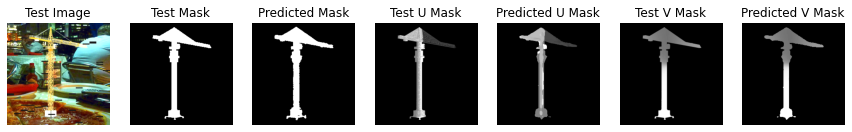

===> Epoch[11/200](0/500): Loss_Mask: 0.0203	Loss_U_Mask: 0.4725	Loss_V_Mask: 0.2368
===> Epoch[11/200](100/500): Loss_Mask: 0.0162	Loss_U_Mask: 0.4881	Loss_V_Mask: 0.2343
===> Epoch[11/200](200/500): Loss_Mask: 0.0262	Loss_U_Mask: 0.5430	Loss_V_Mask: 0.2564
===> Epoch[11/200](300/500): Loss_Mask: 0.0387	Loss_U_Mask: 0.5808	Loss_V_Mask: 0.2793
===> Epoch[11/200](400/500): Loss_Mask: 0.0160	Loss_U_Mask: 0.4675	Loss_V_Mask: 0.2371
===> Epoch[11/200](500/500): Loss_Mask: 0.0223	Loss_U_Mask: 0.5970	Loss_V_Mask: 0.2717
Val_Loss_Mask: 0.0388	Val_U_Loss_Mask: 0.4375	Val_V_Loss_Mask: 0.2071


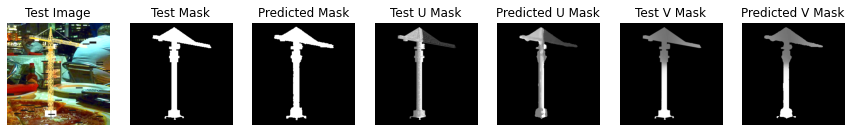

===> Epoch[12/200](0/500): Loss_Mask: 0.0690	Loss_U_Mask: 0.4805	Loss_V_Mask: 0.3109
===> Epoch[12/200](100/500): Loss_Mask: 0.0282	Loss_U_Mask: 0.5914	Loss_V_Mask: 0.2714
===> Epoch[12/200](200/500): Loss_Mask: 0.0586	Loss_U_Mask: 0.5993	Loss_V_Mask: 0.3230
===> Epoch[12/200](300/500): Loss_Mask: 0.0140	Loss_U_Mask: 0.4261	Loss_V_Mask: 0.2348
===> Epoch[12/200](400/500): Loss_Mask: 0.0207	Loss_U_Mask: 0.5461	Loss_V_Mask: 0.2612
===> Epoch[12/200](500/500): Loss_Mask: 0.0166	Loss_U_Mask: 0.4806	Loss_V_Mask: 0.2252
Val_Loss_Mask: 0.0401	Val_U_Loss_Mask: 0.4414	Val_V_Loss_Mask: 0.2138


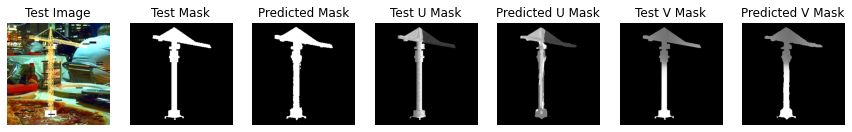

===> Epoch[13/200](0/500): Loss_Mask: 0.0373	Loss_U_Mask: 0.5494	Loss_V_Mask: 0.2914
===> Epoch[13/200](100/500): Loss_Mask: 0.0360	Loss_U_Mask: 0.6056	Loss_V_Mask: 0.2791
===> Epoch[13/200](200/500): Loss_Mask: 0.0231	Loss_U_Mask: 0.4794	Loss_V_Mask: 0.2460
===> Epoch[13/200](300/500): Loss_Mask: 0.0278	Loss_U_Mask: 0.5205	Loss_V_Mask: 0.2535
===> Epoch[13/200](400/500): Loss_Mask: 0.0180	Loss_U_Mask: 0.4944	Loss_V_Mask: 0.2433
===> Epoch[13/200](500/500): Loss_Mask: 0.0221	Loss_U_Mask: 0.4775	Loss_V_Mask: 0.2582
Val_Loss_Mask: 0.0335	Val_U_Loss_Mask: 0.4355	Val_V_Loss_Mask: 0.2088


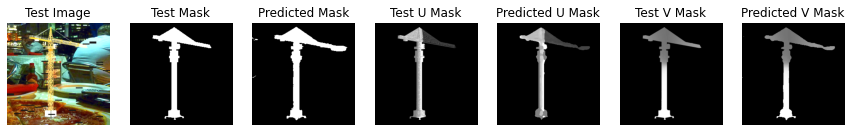

===> Epoch[14/200](0/500): Loss_Mask: 0.0205	Loss_U_Mask: 0.5226	Loss_V_Mask: 0.2451
===> Epoch[14/200](100/500): Loss_Mask: 0.0176	Loss_U_Mask: 0.4680	Loss_V_Mask: 0.2358
===> Epoch[14/200](200/500): Loss_Mask: 0.0519	Loss_U_Mask: 0.5284	Loss_V_Mask: 0.2689
===> Epoch[14/200](300/500): Loss_Mask: 0.0257	Loss_U_Mask: 0.4466	Loss_V_Mask: 0.2554
===> Epoch[14/200](400/500): Loss_Mask: 0.0569	Loss_U_Mask: 0.5726	Loss_V_Mask: 0.3769
===> Epoch[14/200](500/500): Loss_Mask: 0.0183	Loss_U_Mask: 0.5185	Loss_V_Mask: 0.2387
Val_Loss_Mask: 0.0301	Val_U_Loss_Mask: 0.4356	Val_V_Loss_Mask: 0.2018


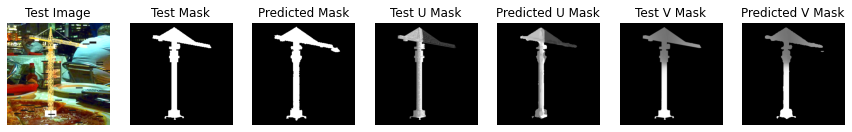

===> Epoch[15/200](0/500): Loss_Mask: 0.0199	Loss_U_Mask: 0.5094	Loss_V_Mask: 0.2265
===> Epoch[15/200](100/500): Loss_Mask: 0.0162	Loss_U_Mask: 0.5058	Loss_V_Mask: 0.2475
===> Epoch[15/200](200/500): Loss_Mask: 0.0205	Loss_U_Mask: 0.6188	Loss_V_Mask: 0.2667
===> Epoch[15/200](300/500): Loss_Mask: 0.0219	Loss_U_Mask: 0.4485	Loss_V_Mask: 0.2451
===> Epoch[15/200](400/500): Loss_Mask: 0.0210	Loss_U_Mask: 0.5465	Loss_V_Mask: 0.2690
===> Epoch[15/200](500/500): Loss_Mask: 0.0265	Loss_U_Mask: 0.5783	Loss_V_Mask: 0.2626
Val_Loss_Mask: 0.0297	Val_U_Loss_Mask: 0.4332	Val_V_Loss_Mask: 0.2002


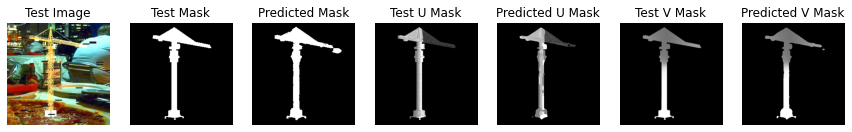

===> Epoch[16/200](0/500): Loss_Mask: 0.0409	Loss_U_Mask: 0.5251	Loss_V_Mask: 0.2846
===> Epoch[16/200](100/500): Loss_Mask: 0.0196	Loss_U_Mask: 0.5119	Loss_V_Mask: 0.2466
===> Epoch[16/200](200/500): Loss_Mask: 0.0180	Loss_U_Mask: 0.4682	Loss_V_Mask: 0.2252
===> Epoch[16/200](300/500): Loss_Mask: 0.0265	Loss_U_Mask: 0.4526	Loss_V_Mask: 0.2558
===> Epoch[16/200](400/500): Loss_Mask: 0.0234	Loss_U_Mask: 0.5535	Loss_V_Mask: 0.2695
===> Epoch[16/200](500/500): Loss_Mask: 0.0201	Loss_U_Mask: 0.5361	Loss_V_Mask: 0.2687
Val_Loss_Mask: 0.0286	Val_U_Loss_Mask: 0.4334	Val_V_Loss_Mask: 0.2037


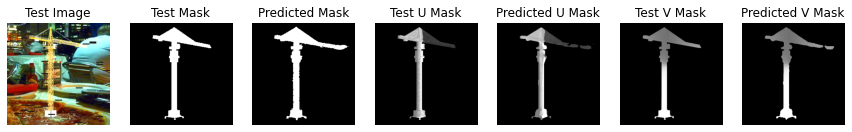

===> Epoch[17/200](0/500): Loss_Mask: 0.0239	Loss_U_Mask: 0.5400	Loss_V_Mask: 0.2529
===> Epoch[17/200](100/500): Loss_Mask: 0.0156	Loss_U_Mask: 0.5679	Loss_V_Mask: 0.2325
===> Epoch[17/200](200/500): Loss_Mask: 0.0326	Loss_U_Mask: 0.4969	Loss_V_Mask: 0.2588
===> Epoch[17/200](300/500): Loss_Mask: 0.0396	Loss_U_Mask: 0.4611	Loss_V_Mask: 0.2826
===> Epoch[17/200](400/500): Loss_Mask: 0.0486	Loss_U_Mask: 0.5090	Loss_V_Mask: 0.2751
===> Epoch[17/200](500/500): Loss_Mask: 0.0158	Loss_U_Mask: 0.3708	Loss_V_Mask: 0.2071
Val_Loss_Mask: 0.0309	Val_U_Loss_Mask: 0.4282	Val_V_Loss_Mask: 0.1992


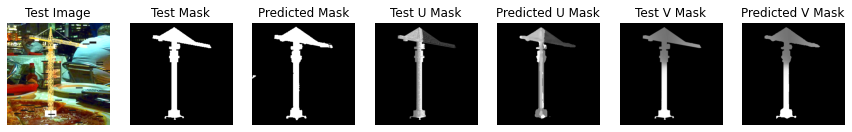

===> Epoch[18/200](0/500): Loss_Mask: 0.0261	Loss_U_Mask: 0.4863	Loss_V_Mask: 0.2548
===> Epoch[18/200](100/500): Loss_Mask: 0.0590	Loss_U_Mask: 0.4567	Loss_V_Mask: 0.2775
===> Epoch[18/200](200/500): Loss_Mask: 0.0138	Loss_U_Mask: 0.3933	Loss_V_Mask: 0.2141
===> Epoch[18/200](300/500): Loss_Mask: 0.0185	Loss_U_Mask: 0.5002	Loss_V_Mask: 0.2445
===> Epoch[18/200](400/500): Loss_Mask: 0.0200	Loss_U_Mask: 0.5186	Loss_V_Mask: 0.2452
===> Epoch[18/200](500/500): Loss_Mask: 0.0652	Loss_U_Mask: 0.6106	Loss_V_Mask: 0.3360
Val_Loss_Mask: 0.0310	Val_U_Loss_Mask: 0.4391	Val_V_Loss_Mask: 0.1997


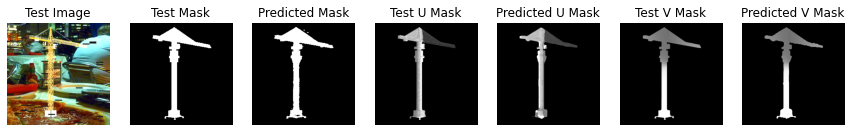

===> Epoch[19/200](0/500): Loss_Mask: 0.0218	Loss_U_Mask: 0.5686	Loss_V_Mask: 0.2686
===> Epoch[19/200](100/500): Loss_Mask: 0.0631	Loss_U_Mask: 0.4681	Loss_V_Mask: 0.3077
===> Epoch[19/200](200/500): Loss_Mask: 0.0114	Loss_U_Mask: 0.5389	Loss_V_Mask: 0.2316
===> Epoch[19/200](300/500): Loss_Mask: 0.0167	Loss_U_Mask: 0.5234	Loss_V_Mask: 0.2378
===> Epoch[19/200](400/500): Loss_Mask: 0.0137	Loss_U_Mask: 0.4979	Loss_V_Mask: 0.2308
===> Epoch[19/200](500/500): Loss_Mask: 0.0185	Loss_U_Mask: 0.5748	Loss_V_Mask: 0.2466
Val_Loss_Mask: 0.0290	Val_U_Loss_Mask: 0.4304	Val_V_Loss_Mask: 0.1989


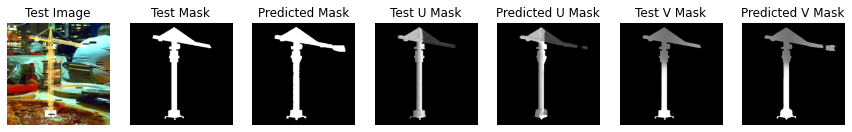

===> Epoch[20/200](0/500): Loss_Mask: 0.0196	Loss_U_Mask: 0.5888	Loss_V_Mask: 0.2479
===> Epoch[20/200](100/500): Loss_Mask: 0.0223	Loss_U_Mask: 0.5122	Loss_V_Mask: 0.2385
===> Epoch[20/200](200/500): Loss_Mask: 0.0295	Loss_U_Mask: 0.4926	Loss_V_Mask: 0.2475
===> Epoch[20/200](300/500): Loss_Mask: 0.0188	Loss_U_Mask: 0.5273	Loss_V_Mask: 0.2594
===> Epoch[20/200](400/500): Loss_Mask: 0.0274	Loss_U_Mask: 0.4517	Loss_V_Mask: 0.2521
===> Epoch[20/200](500/500): Loss_Mask: 0.0148	Loss_U_Mask: 0.4991	Loss_V_Mask: 0.2107
Val_Loss_Mask: 0.0351	Val_U_Loss_Mask: 0.4283	Val_V_Loss_Mask: 0.2047


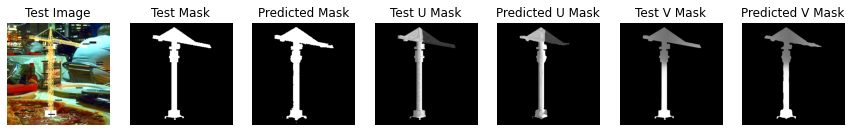

===> Epoch[21/200](0/500): Loss_Mask: 0.0217	Loss_U_Mask: 0.5357	Loss_V_Mask: 0.2350
===> Epoch[21/200](100/500): Loss_Mask: 0.0192	Loss_U_Mask: 0.4633	Loss_V_Mask: 0.2472
===> Epoch[21/200](200/500): Loss_Mask: 0.0173	Loss_U_Mask: 0.5851	Loss_V_Mask: 0.2369
===> Epoch[21/200](300/500): Loss_Mask: 0.0166	Loss_U_Mask: 0.5060	Loss_V_Mask: 0.2207
===> Epoch[21/200](400/500): Loss_Mask: 0.0170	Loss_U_Mask: 0.5025	Loss_V_Mask: 0.2295
===> Epoch[21/200](500/500): Loss_Mask: 0.0142	Loss_U_Mask: 0.4114	Loss_V_Mask: 0.2114
Val_Loss_Mask: 0.0276	Val_U_Loss_Mask: 0.4509	Val_V_Loss_Mask: 0.2103


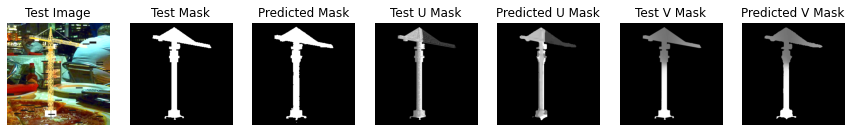

===> Epoch[22/200](0/500): Loss_Mask: 0.0355	Loss_U_Mask: 0.6042	Loss_V_Mask: 0.2790
===> Epoch[22/200](100/500): Loss_Mask: 0.0143	Loss_U_Mask: 0.5337	Loss_V_Mask: 0.2269
===> Epoch[22/200](200/500): Loss_Mask: 0.0264	Loss_U_Mask: 0.4684	Loss_V_Mask: 0.2425
===> Epoch[22/200](300/500): Loss_Mask: 0.0145	Loss_U_Mask: 0.4824	Loss_V_Mask: 0.2336
===> Epoch[22/200](400/500): Loss_Mask: 0.0204	Loss_U_Mask: 0.4693	Loss_V_Mask: 0.2516
===> Epoch[22/200](500/500): Loss_Mask: 0.0106	Loss_U_Mask: 0.4551	Loss_V_Mask: 0.2162
Val_Loss_Mask: 0.0314	Val_U_Loss_Mask: 0.4235	Val_V_Loss_Mask: 0.1999


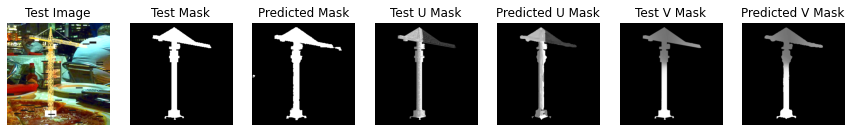

===> Epoch[23/200](0/500): Loss_Mask: 0.0176	Loss_U_Mask: 0.5169	Loss_V_Mask: 0.2384
===> Epoch[23/200](100/500): Loss_Mask: 0.0184	Loss_U_Mask: 0.4645	Loss_V_Mask: 0.2399
===> Epoch[23/200](200/500): Loss_Mask: 0.0107	Loss_U_Mask: 0.4774	Loss_V_Mask: 0.2089
===> Epoch[23/200](300/500): Loss_Mask: 0.0198	Loss_U_Mask: 0.5207	Loss_V_Mask: 0.2557
===> Epoch[23/200](400/500): Loss_Mask: 0.0463	Loss_U_Mask: 0.5833	Loss_V_Mask: 0.3283
===> Epoch[23/200](500/500): Loss_Mask: 0.0228	Loss_U_Mask: 0.5113	Loss_V_Mask: 0.2516
Val_Loss_Mask: 0.0281	Val_U_Loss_Mask: 0.4211	Val_V_Loss_Mask: 0.1922


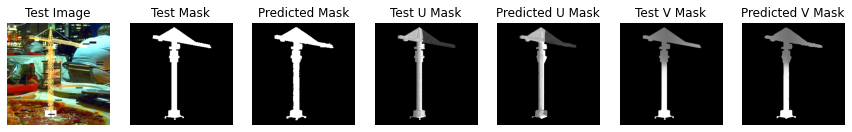

===> Epoch[24/200](0/500): Loss_Mask: 0.0223	Loss_U_Mask: 0.4914	Loss_V_Mask: 0.2349
===> Epoch[24/200](100/500): Loss_Mask: 0.0167	Loss_U_Mask: 0.4338	Loss_V_Mask: 0.2396
===> Epoch[24/200](200/500): Loss_Mask: 0.0144	Loss_U_Mask: 0.4603	Loss_V_Mask: 0.2060
===> Epoch[24/200](300/500): Loss_Mask: 0.0168	Loss_U_Mask: 0.4955	Loss_V_Mask: 0.2534
===> Epoch[24/200](400/500): Loss_Mask: 0.0144	Loss_U_Mask: 0.4501	Loss_V_Mask: 0.2145
===> Epoch[24/200](500/500): Loss_Mask: 0.0139	Loss_U_Mask: 0.5462	Loss_V_Mask: 0.2155
Val_Loss_Mask: 0.0362	Val_U_Loss_Mask: 0.4246	Val_V_Loss_Mask: 0.1937


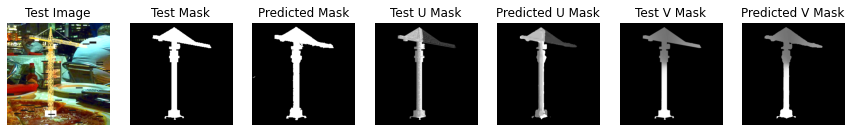

===> Epoch[25/200](0/500): Loss_Mask: 0.0239	Loss_U_Mask: 0.5232	Loss_V_Mask: 0.2483
===> Epoch[25/200](100/500): Loss_Mask: 0.0149	Loss_U_Mask: 0.4949	Loss_V_Mask: 0.2202
===> Epoch[25/200](200/500): Loss_Mask: 0.0184	Loss_U_Mask: 0.4852	Loss_V_Mask: 0.2402
===> Epoch[25/200](300/500): Loss_Mask: 0.0248	Loss_U_Mask: 0.5733	Loss_V_Mask: 0.2641
===> Epoch[25/200](400/500): Loss_Mask: 0.0170	Loss_U_Mask: 0.5101	Loss_V_Mask: 0.2299
===> Epoch[25/200](500/500): Loss_Mask: 0.0232	Loss_U_Mask: 0.4621	Loss_V_Mask: 0.2337
Val_Loss_Mask: 0.0278	Val_U_Loss_Mask: 0.4114	Val_V_Loss_Mask: 0.1933


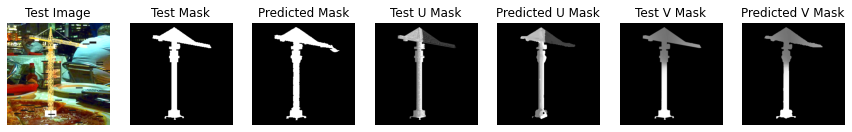

===> Epoch[26/200](0/500): Loss_Mask: 0.0157	Loss_U_Mask: 0.4379	Loss_V_Mask: 0.2250
===> Epoch[26/200](100/500): Loss_Mask: 0.0145	Loss_U_Mask: 0.5183	Loss_V_Mask: 0.2209
===> Epoch[26/200](200/500): Loss_Mask: 0.0240	Loss_U_Mask: 0.5417	Loss_V_Mask: 0.2927
===> Epoch[26/200](300/500): Loss_Mask: 0.0145	Loss_U_Mask: 0.4066	Loss_V_Mask: 0.2160
===> Epoch[26/200](400/500): Loss_Mask: 0.0335	Loss_U_Mask: 0.5304	Loss_V_Mask: 0.2563
===> Epoch[26/200](500/500): Loss_Mask: 0.0154	Loss_U_Mask: 0.4403	Loss_V_Mask: 0.2193
Val_Loss_Mask: 0.0282	Val_U_Loss_Mask: 0.4200	Val_V_Loss_Mask: 0.1972


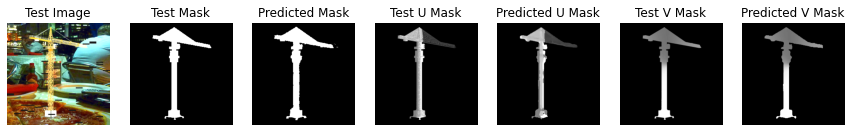

===> Epoch[27/200](0/500): Loss_Mask: 0.0166	Loss_U_Mask: 0.4049	Loss_V_Mask: 0.1968
===> Epoch[27/200](100/500): Loss_Mask: 0.0132	Loss_U_Mask: 0.5372	Loss_V_Mask: 0.2277
===> Epoch[27/200](200/500): Loss_Mask: 0.0178	Loss_U_Mask: 0.4736	Loss_V_Mask: 0.2466
===> Epoch[27/200](300/500): Loss_Mask: 0.0110	Loss_U_Mask: 0.4899	Loss_V_Mask: 0.2151
===> Epoch[27/200](400/500): Loss_Mask: 0.0130	Loss_U_Mask: 0.4558	Loss_V_Mask: 0.2149
===> Epoch[27/200](500/500): Loss_Mask: 0.0185	Loss_U_Mask: 0.5962	Loss_V_Mask: 0.2489
Val_Loss_Mask: 0.0347	Val_U_Loss_Mask: 0.4417	Val_V_Loss_Mask: 0.1959


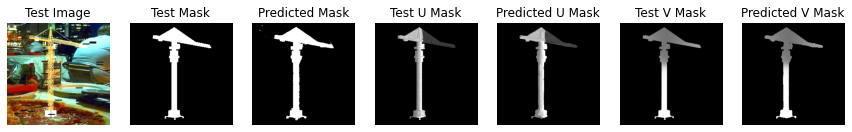

===> Epoch[28/200](0/500): Loss_Mask: 0.0114	Loss_U_Mask: 0.3878	Loss_V_Mask: 0.2009
===> Epoch[28/200](100/500): Loss_Mask: 0.0116	Loss_U_Mask: 0.3818	Loss_V_Mask: 0.2038
===> Epoch[28/200](200/500): Loss_Mask: 0.0134	Loss_U_Mask: 0.4865	Loss_V_Mask: 0.2167
===> Epoch[28/200](300/500): Loss_Mask: 0.0131	Loss_U_Mask: 0.4563	Loss_V_Mask: 0.2077
===> Epoch[28/200](400/500): Loss_Mask: 0.0126	Loss_U_Mask: 0.5302	Loss_V_Mask: 0.2347
===> Epoch[28/200](500/500): Loss_Mask: 0.0178	Loss_U_Mask: 0.4968	Loss_V_Mask: 0.2420
Val_Loss_Mask: 0.0332	Val_U_Loss_Mask: 0.4330	Val_V_Loss_Mask: 0.2042


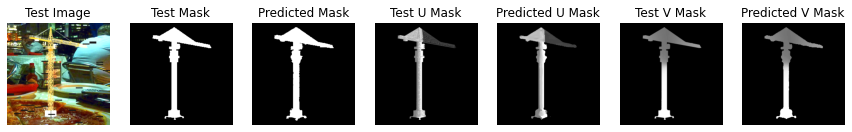

===> Epoch[29/200](0/500): Loss_Mask: 0.0169	Loss_U_Mask: 0.4750	Loss_V_Mask: 0.2287
===> Epoch[29/200](100/500): Loss_Mask: 0.0184	Loss_U_Mask: 0.5002	Loss_V_Mask: 0.2563
===> Epoch[29/200](200/500): Loss_Mask: 0.0187	Loss_U_Mask: 0.5464	Loss_V_Mask: 0.2355
===> Epoch[29/200](300/500): Loss_Mask: 0.0290	Loss_U_Mask: 0.5398	Loss_V_Mask: 0.2549
===> Epoch[29/200](400/500): Loss_Mask: 0.0265	Loss_U_Mask: 0.5684	Loss_V_Mask: 0.2469
===> Epoch[29/200](500/500): Loss_Mask: 0.0158	Loss_U_Mask: 0.3641	Loss_V_Mask: 0.2063
Val_Loss_Mask: 0.0298	Val_U_Loss_Mask: 0.4206	Val_V_Loss_Mask: 0.1903


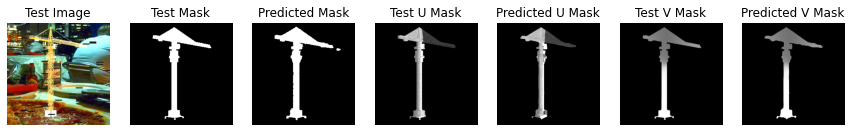

===> Epoch[30/200](0/500): Loss_Mask: 0.0190	Loss_U_Mask: 0.4966	Loss_V_Mask: 0.2113
===> Epoch[30/200](100/500): Loss_Mask: 0.0129	Loss_U_Mask: 0.4149	Loss_V_Mask: 0.2081
===> Epoch[30/200](200/500): Loss_Mask: 0.0213	Loss_U_Mask: 0.5927	Loss_V_Mask: 0.2456
===> Epoch[30/200](300/500): Loss_Mask: 0.0211	Loss_U_Mask: 0.5576	Loss_V_Mask: 0.2573
===> Epoch[30/200](400/500): Loss_Mask: 0.0124	Loss_U_Mask: 0.5252	Loss_V_Mask: 0.2316
===> Epoch[30/200](500/500): Loss_Mask: 0.0164	Loss_U_Mask: 0.5603	Loss_V_Mask: 0.2347
Val_Loss_Mask: 0.0394	Val_U_Loss_Mask: 0.4253	Val_V_Loss_Mask: 0.1951


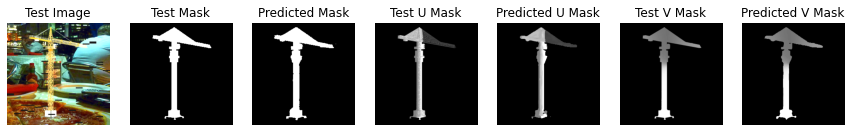

===> Epoch[31/200](0/500): Loss_Mask: 0.0255	Loss_U_Mask: 0.5962	Loss_V_Mask: 0.2477
===> Epoch[31/200](100/500): Loss_Mask: 0.0161	Loss_U_Mask: 0.3687	Loss_V_Mask: 0.2138
===> Epoch[31/200](200/500): Loss_Mask: 0.0237	Loss_U_Mask: 0.5153	Loss_V_Mask: 0.2378
===> Epoch[31/200](300/500): Loss_Mask: 0.0167	Loss_U_Mask: 0.4893	Loss_V_Mask: 0.2284
===> Epoch[31/200](400/500): Loss_Mask: 0.0121	Loss_U_Mask: 0.4497	Loss_V_Mask: 0.2016
===> Epoch[31/200](500/500): Loss_Mask: 0.0160	Loss_U_Mask: 0.5050	Loss_V_Mask: 0.2258
Val_Loss_Mask: 0.0284	Val_U_Loss_Mask: 0.4237	Val_V_Loss_Mask: 0.1857


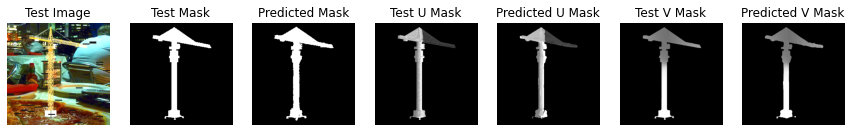

===> Epoch[32/200](0/500): Loss_Mask: 0.0191	Loss_U_Mask: 0.5012	Loss_V_Mask: 0.2230
===> Epoch[32/200](100/500): Loss_Mask: 0.0231	Loss_U_Mask: 0.5168	Loss_V_Mask: 0.2320
===> Epoch[32/200](200/500): Loss_Mask: 0.0170	Loss_U_Mask: 0.4713	Loss_V_Mask: 0.2756
===> Epoch[32/200](300/500): Loss_Mask: 0.0215	Loss_U_Mask: 0.5050	Loss_V_Mask: 0.2689
===> Epoch[32/200](400/500): Loss_Mask: 0.0200	Loss_U_Mask: 0.5086	Loss_V_Mask: 0.2257
===> Epoch[32/200](500/500): Loss_Mask: 0.0121	Loss_U_Mask: 0.4573	Loss_V_Mask: 0.1990
Val_Loss_Mask: 0.0306	Val_U_Loss_Mask: 0.4342	Val_V_Loss_Mask: 0.1873


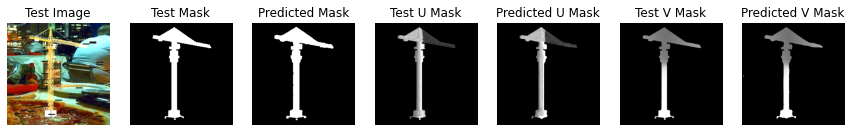

===> Epoch[33/200](0/500): Loss_Mask: 0.0123	Loss_U_Mask: 0.4456	Loss_V_Mask: 0.2055
===> Epoch[33/200](100/500): Loss_Mask: 0.0119	Loss_U_Mask: 0.5350	Loss_V_Mask: 0.2195
===> Epoch[33/200](200/500): Loss_Mask: 0.0134	Loss_U_Mask: 0.4534	Loss_V_Mask: 0.2155
===> Epoch[33/200](300/500): Loss_Mask: 0.0161	Loss_U_Mask: 0.5087	Loss_V_Mask: 0.2112
===> Epoch[33/200](400/500): Loss_Mask: 0.0110	Loss_U_Mask: 0.4093	Loss_V_Mask: 0.2100
===> Epoch[33/200](500/500): Loss_Mask: 0.0107	Loss_U_Mask: 0.3933	Loss_V_Mask: 0.2046
Val_Loss_Mask: 0.0354	Val_U_Loss_Mask: 0.4334	Val_V_Loss_Mask: 0.1940


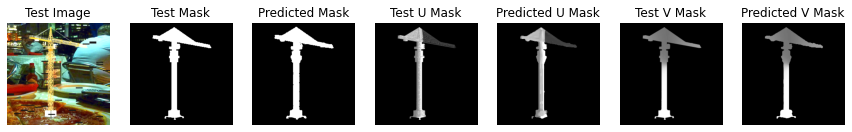

===> Epoch[34/200](0/500): Loss_Mask: 0.0135	Loss_U_Mask: 0.4340	Loss_V_Mask: 0.2051
===> Epoch[34/200](100/500): Loss_Mask: 0.0143	Loss_U_Mask: 0.4848	Loss_V_Mask: 0.2194
===> Epoch[34/200](200/500): Loss_Mask: 0.0155	Loss_U_Mask: 0.4836	Loss_V_Mask: 0.2162
===> Epoch[34/200](300/500): Loss_Mask: 0.0286	Loss_U_Mask: 0.5023	Loss_V_Mask: 0.2591
===> Epoch[34/200](400/500): Loss_Mask: 0.0164	Loss_U_Mask: 0.4923	Loss_V_Mask: 0.2184
===> Epoch[34/200](500/500): Loss_Mask: 0.0164	Loss_U_Mask: 0.4148	Loss_V_Mask: 0.2271
Val_Loss_Mask: 0.0285	Val_U_Loss_Mask: 0.4236	Val_V_Loss_Mask: 0.1876


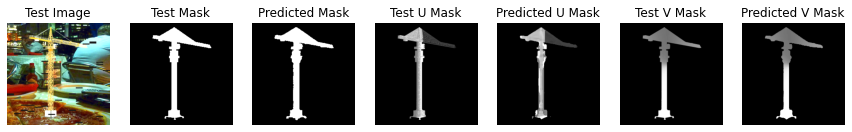

===> Epoch[35/200](0/500): Loss_Mask: 0.0380	Loss_U_Mask: 0.4912	Loss_V_Mask: 0.2493
===> Epoch[35/200](100/500): Loss_Mask: 0.0243	Loss_U_Mask: 0.5459	Loss_V_Mask: 0.2659
===> Epoch[35/200](200/500): Loss_Mask: 0.0216	Loss_U_Mask: 0.4812	Loss_V_Mask: 0.2411
===> Epoch[35/200](300/500): Loss_Mask: 0.0223	Loss_U_Mask: 0.5636	Loss_V_Mask: 0.2672
===> Epoch[35/200](400/500): Loss_Mask: 0.0150	Loss_U_Mask: 0.4660	Loss_V_Mask: 0.2138
===> Epoch[35/200](500/500): Loss_Mask: 0.0136	Loss_U_Mask: 0.4828	Loss_V_Mask: 0.2148
Val_Loss_Mask: 0.0287	Val_U_Loss_Mask: 0.4208	Val_V_Loss_Mask: 0.1862


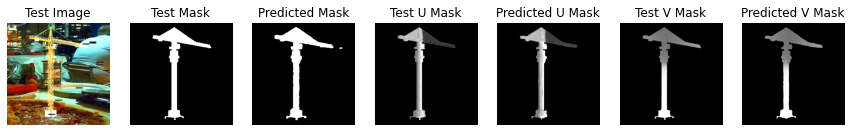

===> Epoch[36/200](0/500): Loss_Mask: 0.0198	Loss_U_Mask: 0.5634	Loss_V_Mask: 0.2233
===> Epoch[36/200](100/500): Loss_Mask: 0.0188	Loss_U_Mask: 0.5546	Loss_V_Mask: 0.2420
===> Epoch[36/200](200/500): Loss_Mask: 0.0250	Loss_U_Mask: 0.4989	Loss_V_Mask: 0.2642
===> Epoch[36/200](300/500): Loss_Mask: 0.0172	Loss_U_Mask: 0.4707	Loss_V_Mask: 0.2309
===> Epoch[36/200](400/500): Loss_Mask: 0.0109	Loss_U_Mask: 0.4524	Loss_V_Mask: 0.2091
===> Epoch[36/200](500/500): Loss_Mask: 0.0162	Loss_U_Mask: 0.5163	Loss_V_Mask: 0.2241
Val_Loss_Mask: 0.0320	Val_U_Loss_Mask: 0.4178	Val_V_Loss_Mask: 0.1903


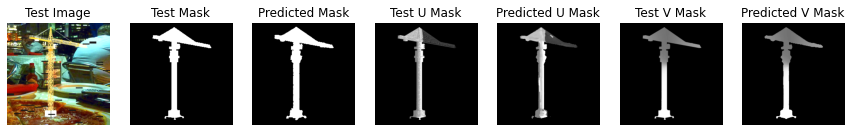

===> Epoch[37/200](0/500): Loss_Mask: 0.0152	Loss_U_Mask: 0.4976	Loss_V_Mask: 0.2050
===> Epoch[37/200](100/500): Loss_Mask: 0.0177	Loss_U_Mask: 0.5185	Loss_V_Mask: 0.2423
===> Epoch[37/200](200/500): Loss_Mask: 0.0178	Loss_U_Mask: 0.4129	Loss_V_Mask: 0.2386
===> Epoch[37/200](300/500): Loss_Mask: 0.0108	Loss_U_Mask: 0.5103	Loss_V_Mask: 0.2113
===> Epoch[37/200](400/500): Loss_Mask: 0.0282	Loss_U_Mask: 0.5000	Loss_V_Mask: 0.2581
===> Epoch[37/200](500/500): Loss_Mask: 0.0115	Loss_U_Mask: 0.4396	Loss_V_Mask: 0.2073
Val_Loss_Mask: 0.0275	Val_U_Loss_Mask: 0.4208	Val_V_Loss_Mask: 0.1874


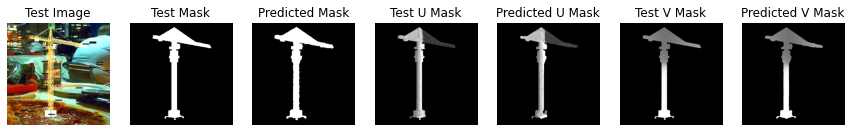

===> Epoch[38/200](0/500): Loss_Mask: 0.0133	Loss_U_Mask: 0.4341	Loss_V_Mask: 0.2040
===> Epoch[38/200](100/500): Loss_Mask: 0.0117	Loss_U_Mask: 0.4997	Loss_V_Mask: 0.2186
===> Epoch[38/200](200/500): Loss_Mask: 0.0094	Loss_U_Mask: 0.4261	Loss_V_Mask: 0.2061
===> Epoch[38/200](300/500): Loss_Mask: 0.0122	Loss_U_Mask: 0.4411	Loss_V_Mask: 0.2218
===> Epoch[38/200](400/500): Loss_Mask: 0.0202	Loss_U_Mask: 0.3691	Loss_V_Mask: 0.2181
===> Epoch[38/200](500/500): Loss_Mask: 0.0158	Loss_U_Mask: 0.5165	Loss_V_Mask: 0.2167
Val_Loss_Mask: 0.0257	Val_U_Loss_Mask: 0.4153	Val_V_Loss_Mask: 0.1817


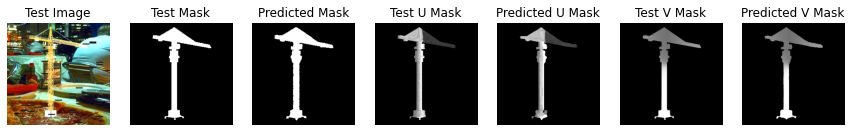

===> Epoch[39/200](0/500): Loss_Mask: 0.0184	Loss_U_Mask: 0.3915	Loss_V_Mask: 0.2054
===> Epoch[39/200](100/500): Loss_Mask: 0.0343	Loss_U_Mask: 0.4067	Loss_V_Mask: 0.2523
===> Epoch[39/200](200/500): Loss_Mask: 0.0119	Loss_U_Mask: 0.4157	Loss_V_Mask: 0.2111
===> Epoch[39/200](300/500): Loss_Mask: 0.0236	Loss_U_Mask: 0.5044	Loss_V_Mask: 0.2438
===> Epoch[39/200](400/500): Loss_Mask: 0.0131	Loss_U_Mask: 0.4600	Loss_V_Mask: 0.2195
===> Epoch[39/200](500/500): Loss_Mask: 0.0123	Loss_U_Mask: 0.4168	Loss_V_Mask: 0.2009
Val_Loss_Mask: 0.0259	Val_U_Loss_Mask: 0.4116	Val_V_Loss_Mask: 0.1846


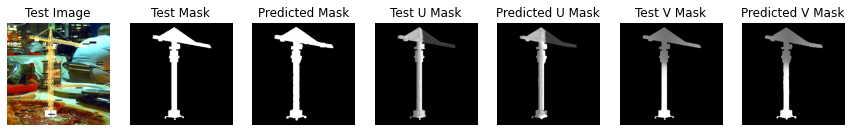

===> Epoch[40/200](0/500): Loss_Mask: 0.0172	Loss_U_Mask: 0.4745	Loss_V_Mask: 0.2359
===> Epoch[40/200](100/500): Loss_Mask: 0.0124	Loss_U_Mask: 0.4601	Loss_V_Mask: 0.2037
===> Epoch[40/200](200/500): Loss_Mask: 0.0107	Loss_U_Mask: 0.5355	Loss_V_Mask: 0.2255
===> Epoch[40/200](300/500): Loss_Mask: 0.0254	Loss_U_Mask: 0.4427	Loss_V_Mask: 0.2495
===> Epoch[40/200](400/500): Loss_Mask: 0.0160	Loss_U_Mask: 0.4731	Loss_V_Mask: 0.2359
===> Epoch[40/200](500/500): Loss_Mask: 0.0131	Loss_U_Mask: 0.5002	Loss_V_Mask: 0.2187
Val_Loss_Mask: 0.0313	Val_U_Loss_Mask: 0.4238	Val_V_Loss_Mask: 0.1991


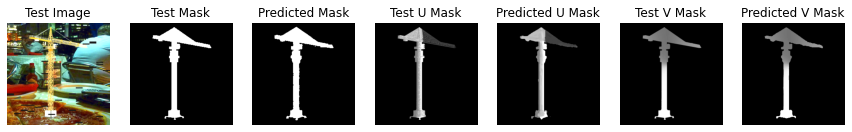

===> Epoch[41/200](0/500): Loss_Mask: 0.0138	Loss_U_Mask: 0.4585	Loss_V_Mask: 0.2290
===> Epoch[41/200](100/500): Loss_Mask: 0.0139	Loss_U_Mask: 0.5342	Loss_V_Mask: 0.2329
===> Epoch[41/200](200/500): Loss_Mask: 0.0090	Loss_U_Mask: 0.3972	Loss_V_Mask: 0.1905
===> Epoch[41/200](300/500): Loss_Mask: 0.0144	Loss_U_Mask: 0.4638	Loss_V_Mask: 0.2138
===> Epoch[41/200](400/500): Loss_Mask: 0.0143	Loss_U_Mask: 0.5510	Loss_V_Mask: 0.2282
===> Epoch[41/200](500/500): Loss_Mask: 0.0262	Loss_U_Mask: 0.5245	Loss_V_Mask: 0.2576
Val_Loss_Mask: 0.0279	Val_U_Loss_Mask: 0.4148	Val_V_Loss_Mask: 0.1856


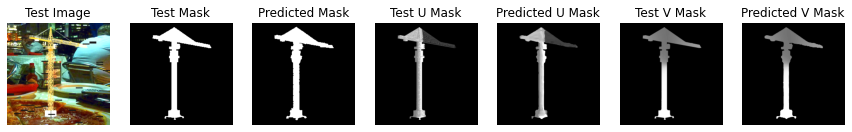

===> Epoch[42/200](0/500): Loss_Mask: 0.0194	Loss_U_Mask: 0.4187	Loss_V_Mask: 0.2194
===> Epoch[42/200](100/500): Loss_Mask: 0.0203	Loss_U_Mask: 0.5703	Loss_V_Mask: 0.2427
===> Epoch[42/200](200/500): Loss_Mask: 0.0146	Loss_U_Mask: 0.4909	Loss_V_Mask: 0.2248
===> Epoch[42/200](300/500): Loss_Mask: 0.0104	Loss_U_Mask: 0.4379	Loss_V_Mask: 0.2132
===> Epoch[42/200](400/500): Loss_Mask: 0.0179	Loss_U_Mask: 0.4670	Loss_V_Mask: 0.2239
===> Epoch[42/200](500/500): Loss_Mask: 0.0129	Loss_U_Mask: 0.4947	Loss_V_Mask: 0.2240
Val_Loss_Mask: 0.0307	Val_U_Loss_Mask: 0.4161	Val_V_Loss_Mask: 0.1948


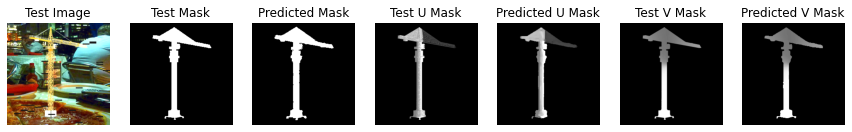

===> Epoch[43/200](0/500): Loss_Mask: 0.0930	Loss_U_Mask: 0.6298	Loss_V_Mask: 0.3429
===> Epoch[43/200](100/500): Loss_Mask: 0.0151	Loss_U_Mask: 0.5433	Loss_V_Mask: 0.2350
===> Epoch[43/200](200/500): Loss_Mask: 0.0141	Loss_U_Mask: 0.4078	Loss_V_Mask: 0.2088
===> Epoch[43/200](300/500): Loss_Mask: 0.0158	Loss_U_Mask: 0.5081	Loss_V_Mask: 0.2260
===> Epoch[43/200](400/500): Loss_Mask: 0.0116	Loss_U_Mask: 0.5364	Loss_V_Mask: 0.2083
===> Epoch[43/200](500/500): Loss_Mask: 0.0119	Loss_U_Mask: 0.4745	Loss_V_Mask: 0.2093
Val_Loss_Mask: 0.0333	Val_U_Loss_Mask: 0.4238	Val_V_Loss_Mask: 0.1902


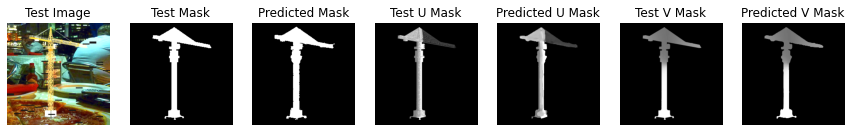

===> Epoch[44/200](0/500): Loss_Mask: 0.0153	Loss_U_Mask: 0.6101	Loss_V_Mask: 0.2208
===> Epoch[44/200](100/500): Loss_Mask: 0.0113	Loss_U_Mask: 0.4792	Loss_V_Mask: 0.2080
===> Epoch[44/200](200/500): Loss_Mask: 0.0090	Loss_U_Mask: 0.4239	Loss_V_Mask: 0.2103
===> Epoch[44/200](300/500): Loss_Mask: 0.0157	Loss_U_Mask: 0.4656	Loss_V_Mask: 0.2296
===> Epoch[44/200](400/500): Loss_Mask: 0.0190	Loss_U_Mask: 0.4045	Loss_V_Mask: 0.2536
===> Epoch[44/200](500/500): Loss_Mask: 0.0356	Loss_U_Mask: 0.5185	Loss_V_Mask: 0.2678
Val_Loss_Mask: 0.0230	Val_U_Loss_Mask: 0.4090	Val_V_Loss_Mask: 0.1814


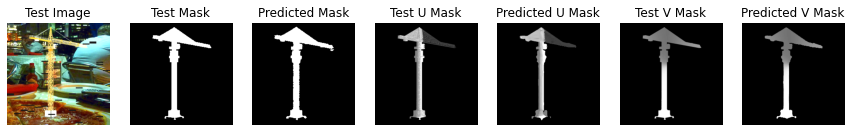

===> Epoch[45/200](0/500): Loss_Mask: 0.0142	Loss_U_Mask: 0.4539	Loss_V_Mask: 0.2084
===> Epoch[45/200](100/500): Loss_Mask: 0.0103	Loss_U_Mask: 0.3850	Loss_V_Mask: 0.2026
===> Epoch[45/200](200/500): Loss_Mask: 0.0130	Loss_U_Mask: 0.4885	Loss_V_Mask: 0.1966
===> Epoch[45/200](300/500): Loss_Mask: 0.0152	Loss_U_Mask: 0.5059	Loss_V_Mask: 0.2326
===> Epoch[45/200](400/500): Loss_Mask: 0.0111	Loss_U_Mask: 0.4191	Loss_V_Mask: 0.2067
===> Epoch[45/200](500/500): Loss_Mask: 0.0172	Loss_U_Mask: 0.4879	Loss_V_Mask: 0.2406
Val_Loss_Mask: 0.0259	Val_U_Loss_Mask: 0.4277	Val_V_Loss_Mask: 0.1892


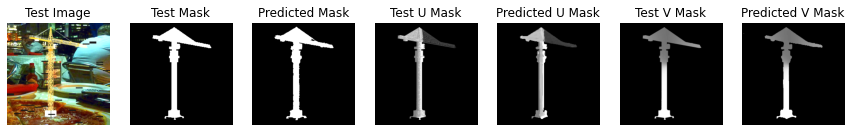

===> Epoch[46/200](0/500): Loss_Mask: 0.0268	Loss_U_Mask: 0.6017	Loss_V_Mask: 0.2578
===> Epoch[46/200](100/500): Loss_Mask: 0.0142	Loss_U_Mask: 0.4882	Loss_V_Mask: 0.2310
===> Epoch[46/200](200/500): Loss_Mask: 0.0100	Loss_U_Mask: 0.5102	Loss_V_Mask: 0.2046
===> Epoch[46/200](300/500): Loss_Mask: 0.0487	Loss_U_Mask: 0.5518	Loss_V_Mask: 0.3087
===> Epoch[46/200](400/500): Loss_Mask: 0.0290	Loss_U_Mask: 0.5346	Loss_V_Mask: 0.2554
===> Epoch[46/200](500/500): Loss_Mask: 0.0137	Loss_U_Mask: 0.4644	Loss_V_Mask: 0.2346
Val_Loss_Mask: 0.0301	Val_U_Loss_Mask: 0.4105	Val_V_Loss_Mask: 0.1813


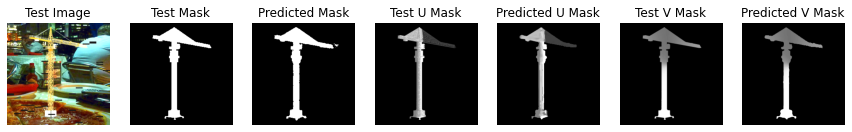

===> Epoch[47/200](0/500): Loss_Mask: 0.0148	Loss_U_Mask: 0.5521	Loss_V_Mask: 0.2087
===> Epoch[47/200](100/500): Loss_Mask: 0.0184	Loss_U_Mask: 0.5346	Loss_V_Mask: 0.2439
===> Epoch[47/200](200/500): Loss_Mask: 0.0118	Loss_U_Mask: 0.4560	Loss_V_Mask: 0.2219
===> Epoch[47/200](300/500): Loss_Mask: 0.0110	Loss_U_Mask: 0.3519	Loss_V_Mask: 0.1885
===> Epoch[47/200](400/500): Loss_Mask: 0.0154	Loss_U_Mask: 0.5019	Loss_V_Mask: 0.2061
===> Epoch[47/200](500/500): Loss_Mask: 0.0137	Loss_U_Mask: 0.4946	Loss_V_Mask: 0.2258
Val_Loss_Mask: 0.0312	Val_U_Loss_Mask: 0.4169	Val_V_Loss_Mask: 0.1832


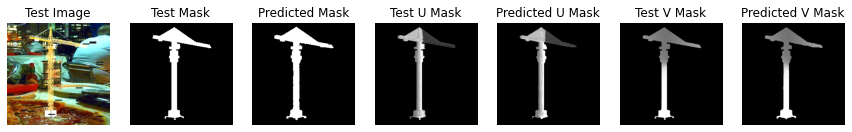

===> Epoch[48/200](0/500): Loss_Mask: 0.0140	Loss_U_Mask: 0.3751	Loss_V_Mask: 0.1995
===> Epoch[48/200](100/500): Loss_Mask: 0.0165	Loss_U_Mask: 0.4263	Loss_V_Mask: 0.2237
===> Epoch[48/200](200/500): Loss_Mask: 0.0200	Loss_U_Mask: 0.5317	Loss_V_Mask: 0.2293
===> Epoch[48/200](300/500): Loss_Mask: 0.0166	Loss_U_Mask: 0.4908	Loss_V_Mask: 0.2128
===> Epoch[48/200](400/500): Loss_Mask: 0.0162	Loss_U_Mask: 0.4723	Loss_V_Mask: 0.2374
===> Epoch[48/200](500/500): Loss_Mask: 0.0277	Loss_U_Mask: 0.5140	Loss_V_Mask: 0.2500
Val_Loss_Mask: 0.0273	Val_U_Loss_Mask: 0.4424	Val_V_Loss_Mask: 0.1965


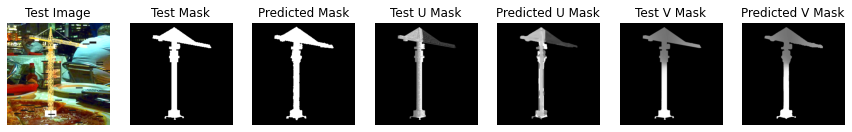

===> Epoch[49/200](0/500): Loss_Mask: 0.0121	Loss_U_Mask: 0.4394	Loss_V_Mask: 0.2072
===> Epoch[49/200](100/500): Loss_Mask: 0.0113	Loss_U_Mask: 0.4940	Loss_V_Mask: 0.2222
===> Epoch[49/200](200/500): Loss_Mask: 0.0174	Loss_U_Mask: 0.5694	Loss_V_Mask: 0.2515
===> Epoch[49/200](300/500): Loss_Mask: 0.0166	Loss_U_Mask: 0.4725	Loss_V_Mask: 0.2075
===> Epoch[49/200](400/500): Loss_Mask: 0.0140	Loss_U_Mask: 0.4737	Loss_V_Mask: 0.2128
===> Epoch[49/200](500/500): Loss_Mask: 0.0152	Loss_U_Mask: 0.3733	Loss_V_Mask: 0.2096
Val_Loss_Mask: 0.0391	Val_U_Loss_Mask: 0.4321	Val_V_Loss_Mask: 0.2003


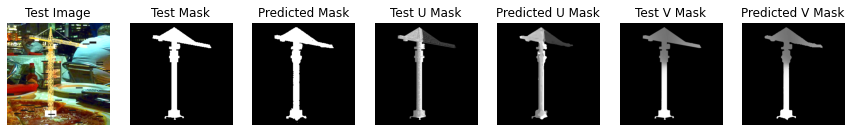

===> Epoch[50/200](0/500): Loss_Mask: 0.0140	Loss_U_Mask: 0.4510	Loss_V_Mask: 0.2012
===> Epoch[50/200](100/500): Loss_Mask: 0.0118	Loss_U_Mask: 0.4864	Loss_V_Mask: 0.2164
===> Epoch[50/200](200/500): Loss_Mask: 0.0106	Loss_U_Mask: 0.4423	Loss_V_Mask: 0.1940
===> Epoch[50/200](300/500): Loss_Mask: 0.0146	Loss_U_Mask: 0.3731	Loss_V_Mask: 0.2028
===> Epoch[50/200](400/500): Loss_Mask: 0.0117	Loss_U_Mask: 0.4977	Loss_V_Mask: 0.2054
===> Epoch[50/200](500/500): Loss_Mask: 0.0121	Loss_U_Mask: 0.4525	Loss_V_Mask: 0.2208
Val_Loss_Mask: 0.0337	Val_U_Loss_Mask: 0.4249	Val_V_Loss_Mask: 0.1891


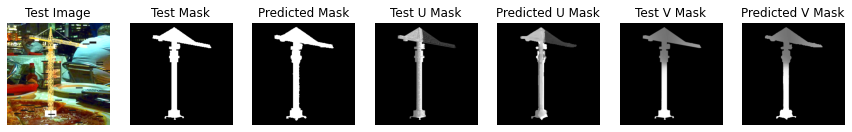

===> Epoch[51/200](0/500): Loss_Mask: 0.0249	Loss_U_Mask: 0.5340	Loss_V_Mask: 0.2215
===> Epoch[51/200](100/500): Loss_Mask: 0.0111	Loss_U_Mask: 0.4731	Loss_V_Mask: 0.2190
===> Epoch[51/200](200/500): Loss_Mask: 0.0140	Loss_U_Mask: 0.4672	Loss_V_Mask: 0.2099
===> Epoch[51/200](300/500): Loss_Mask: 0.0132	Loss_U_Mask: 0.4693	Loss_V_Mask: 0.2171
===> Epoch[51/200](400/500): Loss_Mask: 0.0107	Loss_U_Mask: 0.4436	Loss_V_Mask: 0.2035
===> Epoch[51/200](500/500): Loss_Mask: 0.0150	Loss_U_Mask: 0.3748	Loss_V_Mask: 0.2147
Val_Loss_Mask: 0.0282	Val_U_Loss_Mask: 0.4105	Val_V_Loss_Mask: 0.1840


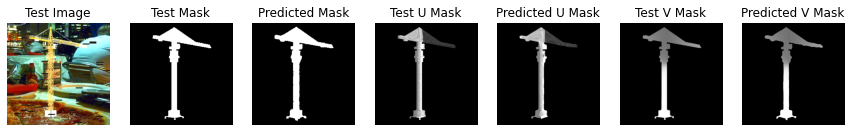

===> Epoch[52/200](0/500): Loss_Mask: 0.0215	Loss_U_Mask: 0.4318	Loss_V_Mask: 0.2213
===> Epoch[52/200](100/500): Loss_Mask: 0.0196	Loss_U_Mask: 0.4734	Loss_V_Mask: 0.2295
===> Epoch[52/200](200/500): Loss_Mask: 0.0194	Loss_U_Mask: 0.4119	Loss_V_Mask: 0.2517
===> Epoch[52/200](300/500): Loss_Mask: 0.0115	Loss_U_Mask: 0.4470	Loss_V_Mask: 0.2039
===> Epoch[52/200](400/500): Loss_Mask: 0.0123	Loss_U_Mask: 0.5186	Loss_V_Mask: 0.2129
===> Epoch[52/200](500/500): Loss_Mask: 0.0141	Loss_U_Mask: 0.5016	Loss_V_Mask: 0.2253
Val_Loss_Mask: 0.0272	Val_U_Loss_Mask: 0.4203	Val_V_Loss_Mask: 0.1811


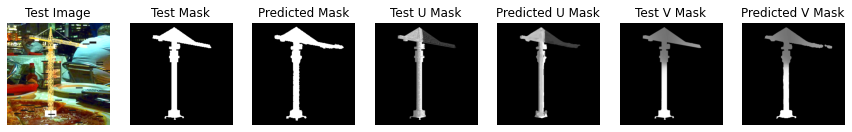

===> Epoch[53/200](0/500): Loss_Mask: 0.0139	Loss_U_Mask: 0.4289	Loss_V_Mask: 0.1972
===> Epoch[53/200](100/500): Loss_Mask: 0.0136	Loss_U_Mask: 0.4670	Loss_V_Mask: 0.2272
===> Epoch[53/200](200/500): Loss_Mask: 0.0106	Loss_U_Mask: 0.4172	Loss_V_Mask: 0.2017
===> Epoch[53/200](300/500): Loss_Mask: 0.0099	Loss_U_Mask: 0.4197	Loss_V_Mask: 0.1987
===> Epoch[53/200](400/500): Loss_Mask: 0.0140	Loss_U_Mask: 0.5115	Loss_V_Mask: 0.1994
===> Epoch[53/200](500/500): Loss_Mask: 0.0132	Loss_U_Mask: 0.5662	Loss_V_Mask: 0.2109
Val_Loss_Mask: 0.0279	Val_U_Loss_Mask: 0.4180	Val_V_Loss_Mask: 0.1962


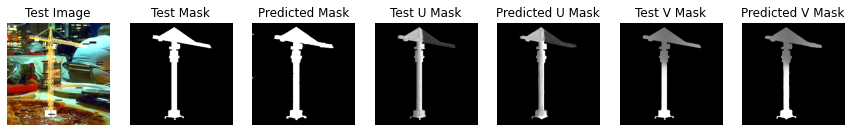

===> Epoch[54/200](0/500): Loss_Mask: 0.0165	Loss_U_Mask: 0.5178	Loss_V_Mask: 0.2112
===> Epoch[54/200](100/500): Loss_Mask: 0.0144	Loss_U_Mask: 0.4527	Loss_V_Mask: 0.2164
===> Epoch[54/200](200/500): Loss_Mask: 0.0125	Loss_U_Mask: 0.4948	Loss_V_Mask: 0.2105
===> Epoch[54/200](300/500): Loss_Mask: 0.0227	Loss_U_Mask: 0.5244	Loss_V_Mask: 0.2400
===> Epoch[54/200](400/500): Loss_Mask: 0.0139	Loss_U_Mask: 0.3924	Loss_V_Mask: 0.1949
===> Epoch[54/200](500/500): Loss_Mask: 0.0149	Loss_U_Mask: 0.4754	Loss_V_Mask: 0.2168
Val_Loss_Mask: 0.0316	Val_U_Loss_Mask: 0.4180	Val_V_Loss_Mask: 0.1918


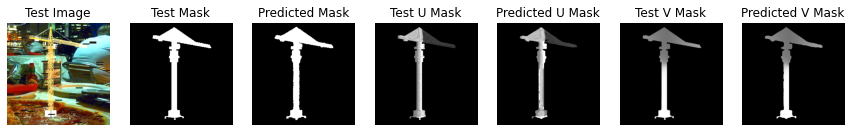

===> Epoch[55/200](0/500): Loss_Mask: 0.0296	Loss_U_Mask: 0.4971	Loss_V_Mask: 0.2482
===> Epoch[55/200](100/500): Loss_Mask: 0.0128	Loss_U_Mask: 0.5223	Loss_V_Mask: 0.2400
===> Epoch[55/200](200/500): Loss_Mask: 0.0129	Loss_U_Mask: 0.4505	Loss_V_Mask: 0.2078
===> Epoch[55/200](300/500): Loss_Mask: 0.0205	Loss_U_Mask: 0.4079	Loss_V_Mask: 0.2239
===> Epoch[55/200](400/500): Loss_Mask: 0.0124	Loss_U_Mask: 0.5369	Loss_V_Mask: 0.2139
===> Epoch[55/200](500/500): Loss_Mask: 0.0140	Loss_U_Mask: 0.4818	Loss_V_Mask: 0.2146
Val_Loss_Mask: 0.0266	Val_U_Loss_Mask: 0.4181	Val_V_Loss_Mask: 0.1813


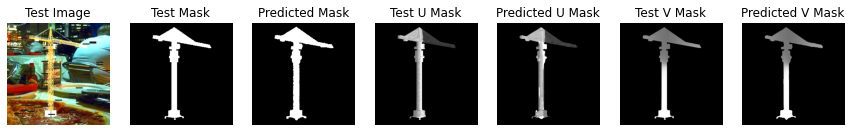

===> Epoch[56/200](0/500): Loss_Mask: 0.0172	Loss_U_Mask: 0.4659	Loss_V_Mask: 0.2038
===> Epoch[56/200](100/500): Loss_Mask: 0.0285	Loss_U_Mask: 0.4781	Loss_V_Mask: 0.2554
===> Epoch[56/200](200/500): Loss_Mask: 0.0115	Loss_U_Mask: 0.5139	Loss_V_Mask: 0.2100
===> Epoch[56/200](300/500): Loss_Mask: 0.0089	Loss_U_Mask: 0.4216	Loss_V_Mask: 0.1858
===> Epoch[56/200](400/500): Loss_Mask: 0.0104	Loss_U_Mask: 0.4678	Loss_V_Mask: 0.2069
===> Epoch[56/200](500/500): Loss_Mask: 0.0140	Loss_U_Mask: 0.5249	Loss_V_Mask: 0.2193
Val_Loss_Mask: 0.0385	Val_U_Loss_Mask: 0.4246	Val_V_Loss_Mask: 0.1967


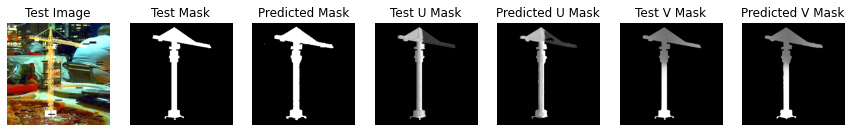

===> Epoch[57/200](0/500): Loss_Mask: 0.0170	Loss_U_Mask: 0.4633	Loss_V_Mask: 0.2190
===> Epoch[57/200](100/500): Loss_Mask: 0.0131	Loss_U_Mask: 0.5143	Loss_V_Mask: 0.2173
===> Epoch[57/200](200/500): Loss_Mask: 0.0114	Loss_U_Mask: 0.3907	Loss_V_Mask: 0.1933
===> Epoch[57/200](300/500): Loss_Mask: 0.0097	Loss_U_Mask: 0.4250	Loss_V_Mask: 0.1979
===> Epoch[57/200](400/500): Loss_Mask: 0.0161	Loss_U_Mask: 0.3906	Loss_V_Mask: 0.2147
===> Epoch[57/200](500/500): Loss_Mask: 0.0158	Loss_U_Mask: 0.3951	Loss_V_Mask: 0.2188
Val_Loss_Mask: 0.0293	Val_U_Loss_Mask: 0.4166	Val_V_Loss_Mask: 0.1846


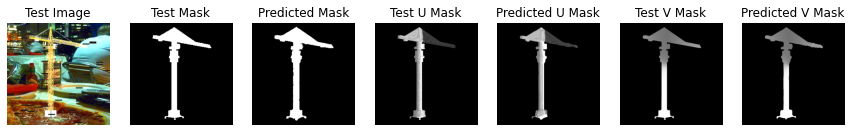

===> Epoch[58/200](0/500): Loss_Mask: 0.0247	Loss_U_Mask: 0.6197	Loss_V_Mask: 0.2577
===> Epoch[58/200](100/500): Loss_Mask: 0.0149	Loss_U_Mask: 0.4386	Loss_V_Mask: 0.2081
===> Epoch[58/200](200/500): Loss_Mask: 0.0099	Loss_U_Mask: 0.4137	Loss_V_Mask: 0.2000
===> Epoch[58/200](300/500): Loss_Mask: 0.0124	Loss_U_Mask: 0.5283	Loss_V_Mask: 0.2093
===> Epoch[58/200](400/500): Loss_Mask: 0.0093	Loss_U_Mask: 0.4335	Loss_V_Mask: 0.1960
===> Epoch[58/200](500/500): Loss_Mask: 0.0111	Loss_U_Mask: 0.5003	Loss_V_Mask: 0.2133
Val_Loss_Mask: 0.0290	Val_U_Loss_Mask: 0.4205	Val_V_Loss_Mask: 0.1808


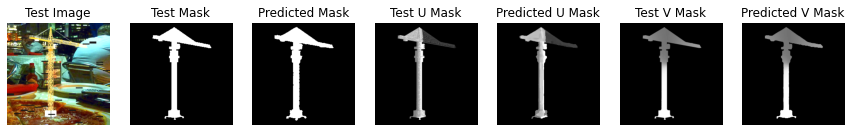

===> Epoch[59/200](0/500): Loss_Mask: 0.0405	Loss_U_Mask: 0.5723	Loss_V_Mask: 0.2589
===> Epoch[59/200](100/500): Loss_Mask: 0.0176	Loss_U_Mask: 0.5194	Loss_V_Mask: 0.2249
===> Epoch[59/200](200/500): Loss_Mask: 0.0111	Loss_U_Mask: 0.4289	Loss_V_Mask: 0.1926
===> Epoch[59/200](300/500): Loss_Mask: 0.0105	Loss_U_Mask: 0.4289	Loss_V_Mask: 0.1956
===> Epoch[59/200](400/500): Loss_Mask: 0.0130	Loss_U_Mask: 0.4661	Loss_V_Mask: 0.2234
===> Epoch[59/200](500/500): Loss_Mask: 0.0156	Loss_U_Mask: 0.4742	Loss_V_Mask: 0.2298
Val_Loss_Mask: 0.0350	Val_U_Loss_Mask: 0.4211	Val_V_Loss_Mask: 0.1923


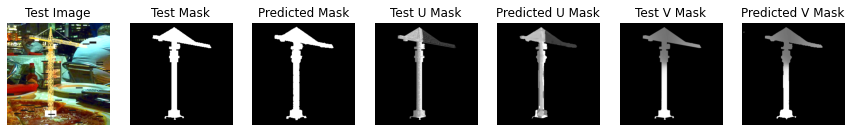

===> Epoch[60/200](0/500): Loss_Mask: 0.0153	Loss_U_Mask: 0.4159	Loss_V_Mask: 0.2082
===> Epoch[60/200](100/500): Loss_Mask: 0.0131	Loss_U_Mask: 0.5115	Loss_V_Mask: 0.2154
===> Epoch[60/200](200/500): Loss_Mask: 0.0127	Loss_U_Mask: 0.4387	Loss_V_Mask: 0.2088
===> Epoch[60/200](300/500): Loss_Mask: 0.0102	Loss_U_Mask: 0.4608	Loss_V_Mask: 0.2065
===> Epoch[60/200](400/500): Loss_Mask: 0.0108	Loss_U_Mask: 0.4593	Loss_V_Mask: 0.2028
===> Epoch[60/200](500/500): Loss_Mask: 0.0203	Loss_U_Mask: 0.4394	Loss_V_Mask: 0.2089
Val_Loss_Mask: 0.0294	Val_U_Loss_Mask: 0.4173	Val_V_Loss_Mask: 0.1864


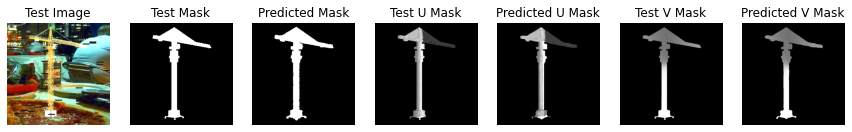

===> Epoch[61/200](0/500): Loss_Mask: 0.0133	Loss_U_Mask: 0.4596	Loss_V_Mask: 0.2213
===> Epoch[61/200](100/500): Loss_Mask: 0.0117	Loss_U_Mask: 0.5868	Loss_V_Mask: 0.2234
===> Epoch[61/200](200/500): Loss_Mask: 0.0159	Loss_U_Mask: 0.3926	Loss_V_Mask: 0.2246
===> Epoch[61/200](300/500): Loss_Mask: 0.0189	Loss_U_Mask: 0.5012	Loss_V_Mask: 0.2168
===> Epoch[61/200](400/500): Loss_Mask: 0.0128	Loss_U_Mask: 0.4731	Loss_V_Mask: 0.2248
===> Epoch[61/200](500/500): Loss_Mask: 0.0103	Loss_U_Mask: 0.4341	Loss_V_Mask: 0.2021
Val_Loss_Mask: 0.0280	Val_U_Loss_Mask: 0.4094	Val_V_Loss_Mask: 0.1870


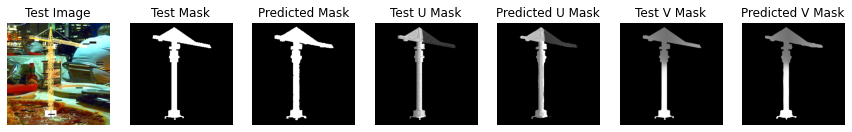

===> Epoch[62/200](0/500): Loss_Mask: 0.0176	Loss_U_Mask: 0.5147	Loss_V_Mask: 0.2341
===> Epoch[62/200](100/500): Loss_Mask: 0.0131	Loss_U_Mask: 0.4271	Loss_V_Mask: 0.2112
===> Epoch[62/200](200/500): Loss_Mask: 0.0151	Loss_U_Mask: 0.4662	Loss_V_Mask: 0.2164
===> Epoch[62/200](300/500): Loss_Mask: 0.0125	Loss_U_Mask: 0.5298	Loss_V_Mask: 0.2277
===> Epoch[62/200](400/500): Loss_Mask: 0.0176	Loss_U_Mask: 0.4613	Loss_V_Mask: 0.2192
===> Epoch[62/200](500/500): Loss_Mask: 0.0154	Loss_U_Mask: 0.4488	Loss_V_Mask: 0.2227
Val_Loss_Mask: 0.0299	Val_U_Loss_Mask: 0.4124	Val_V_Loss_Mask: 0.1838


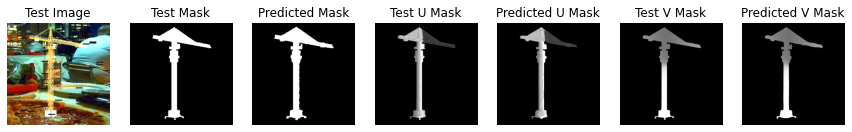

===> Epoch[63/200](0/500): Loss_Mask: 0.0176	Loss_U_Mask: 0.4212	Loss_V_Mask: 0.2033
===> Epoch[63/200](100/500): Loss_Mask: 0.0214	Loss_U_Mask: 0.5067	Loss_V_Mask: 0.2455
===> Epoch[63/200](200/500): Loss_Mask: 0.0130	Loss_U_Mask: 0.5073	Loss_V_Mask: 0.2148
===> Epoch[63/200](300/500): Loss_Mask: 0.0113	Loss_U_Mask: 0.5042	Loss_V_Mask: 0.2125
===> Epoch[63/200](400/500): Loss_Mask: 0.0115	Loss_U_Mask: 0.4656	Loss_V_Mask: 0.2126
===> Epoch[63/200](500/500): Loss_Mask: 0.0107	Loss_U_Mask: 0.3877	Loss_V_Mask: 0.1974
Val_Loss_Mask: 0.0306	Val_U_Loss_Mask: 0.4197	Val_V_Loss_Mask: 0.1870


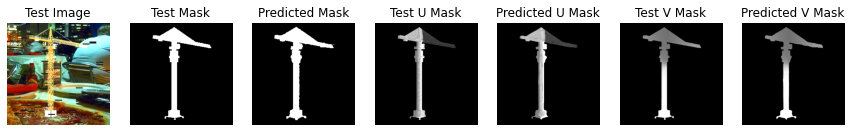

===> Epoch[64/200](0/500): Loss_Mask: 0.0168	Loss_U_Mask: 0.4878	Loss_V_Mask: 0.2208
===> Epoch[64/200](100/500): Loss_Mask: 0.0162	Loss_U_Mask: 0.4035	Loss_V_Mask: 0.2069
===> Epoch[64/200](200/500): Loss_Mask: 0.0107	Loss_U_Mask: 0.5106	Loss_V_Mask: 0.2028
===> Epoch[64/200](300/500): Loss_Mask: 0.0142	Loss_U_Mask: 0.5014	Loss_V_Mask: 0.2165
===> Epoch[64/200](400/500): Loss_Mask: 0.0105	Loss_U_Mask: 0.4307	Loss_V_Mask: 0.2191
===> Epoch[64/200](500/500): Loss_Mask: 0.0134	Loss_U_Mask: 0.4747	Loss_V_Mask: 0.2146
Val_Loss_Mask: 0.0294	Val_U_Loss_Mask: 0.4140	Val_V_Loss_Mask: 0.1815


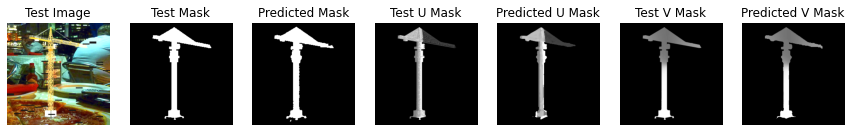

===> Epoch[65/200](0/500): Loss_Mask: 0.0163	Loss_U_Mask: 0.4547	Loss_V_Mask: 0.2164
===> Epoch[65/200](100/500): Loss_Mask: 0.0194	Loss_U_Mask: 0.5219	Loss_V_Mask: 0.2369
===> Epoch[65/200](200/500): Loss_Mask: 0.0112	Loss_U_Mask: 0.4525	Loss_V_Mask: 0.2045
===> Epoch[65/200](300/500): Loss_Mask: 0.0193	Loss_U_Mask: 0.5010	Loss_V_Mask: 0.2410
===> Epoch[65/200](400/500): Loss_Mask: 0.0122	Loss_U_Mask: 0.4658	Loss_V_Mask: 0.2014
===> Epoch[65/200](500/500): Loss_Mask: 0.0161	Loss_U_Mask: 0.5059	Loss_V_Mask: 0.2103
Val_Loss_Mask: 0.0274	Val_U_Loss_Mask: 0.4097	Val_V_Loss_Mask: 0.1817


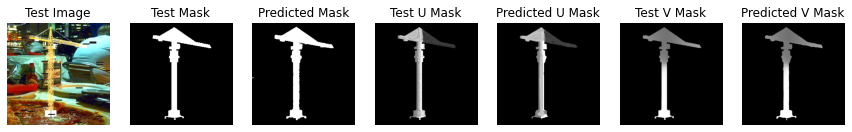

===> Epoch[66/200](0/500): Loss_Mask: 0.0124	Loss_U_Mask: 0.4501	Loss_V_Mask: 0.1975
===> Epoch[66/200](100/500): Loss_Mask: 0.0105	Loss_U_Mask: 0.4950	Loss_V_Mask: 0.2042
===> Epoch[66/200](200/500): Loss_Mask: 0.0141	Loss_U_Mask: 0.4268	Loss_V_Mask: 0.2178
===> Epoch[66/200](300/500): Loss_Mask: 0.0101	Loss_U_Mask: 0.5196	Loss_V_Mask: 0.1942
===> Epoch[66/200](400/500): Loss_Mask: 0.0153	Loss_U_Mask: 0.4245	Loss_V_Mask: 0.1967
===> Epoch[66/200](500/500): Loss_Mask: 0.0120	Loss_U_Mask: 0.3802	Loss_V_Mask: 0.1885
Val_Loss_Mask: 0.0289	Val_U_Loss_Mask: 0.4161	Val_V_Loss_Mask: 0.1858


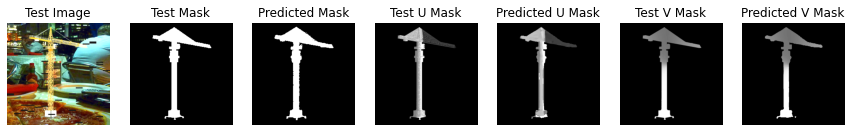

===> Epoch[67/200](0/500): Loss_Mask: 0.0118	Loss_U_Mask: 0.4872	Loss_V_Mask: 0.1947
===> Epoch[67/200](100/500): Loss_Mask: 0.0088	Loss_U_Mask: 0.3451	Loss_V_Mask: 0.1828
===> Epoch[67/200](200/500): Loss_Mask: 0.0119	Loss_U_Mask: 0.4326	Loss_V_Mask: 0.1982
===> Epoch[67/200](300/500): Loss_Mask: 0.0129	Loss_U_Mask: 0.4856	Loss_V_Mask: 0.2103
===> Epoch[67/200](400/500): Loss_Mask: 0.0138	Loss_U_Mask: 0.5170	Loss_V_Mask: 0.2238
===> Epoch[67/200](500/500): Loss_Mask: 0.0159	Loss_U_Mask: 0.5302	Loss_V_Mask: 0.2238
Val_Loss_Mask: 0.0325	Val_U_Loss_Mask: 0.4142	Val_V_Loss_Mask: 0.1873


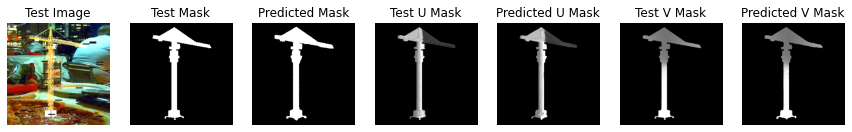

===> Epoch[68/200](0/500): Loss_Mask: 0.0128	Loss_U_Mask: 0.4412	Loss_V_Mask: 0.1847
===> Epoch[68/200](100/500): Loss_Mask: 0.0134	Loss_U_Mask: 0.5192	Loss_V_Mask: 0.2097
===> Epoch[68/200](200/500): Loss_Mask: 0.0110	Loss_U_Mask: 0.4654	Loss_V_Mask: 0.1984
===> Epoch[68/200](300/500): Loss_Mask: 0.0140	Loss_U_Mask: 0.5204	Loss_V_Mask: 0.2354
===> Epoch[68/200](400/500): Loss_Mask: 0.0092	Loss_U_Mask: 0.3620	Loss_V_Mask: 0.1915
===> Epoch[68/200](500/500): Loss_Mask: 0.0127	Loss_U_Mask: 0.4542	Loss_V_Mask: 0.2133
Val_Loss_Mask: 0.0284	Val_U_Loss_Mask: 0.4225	Val_V_Loss_Mask: 0.1829


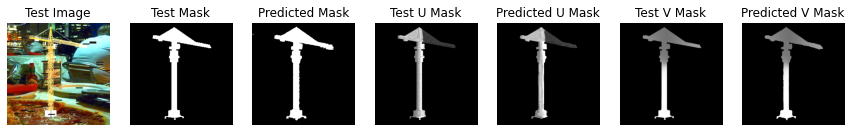

===> Epoch[69/200](0/500): Loss_Mask: 0.0171	Loss_U_Mask: 0.5685	Loss_V_Mask: 0.2271
===> Epoch[69/200](100/500): Loss_Mask: 0.0233	Loss_U_Mask: 0.4199	Loss_V_Mask: 0.2130
===> Epoch[69/200](200/500): Loss_Mask: 0.0129	Loss_U_Mask: 0.5289	Loss_V_Mask: 0.2455
===> Epoch[69/200](300/500): Loss_Mask: 0.0080	Loss_U_Mask: 0.3776	Loss_V_Mask: 0.1877
===> Epoch[69/200](400/500): Loss_Mask: 0.0115	Loss_U_Mask: 0.4629	Loss_V_Mask: 0.2223
===> Epoch[69/200](500/500): Loss_Mask: 0.0118	Loss_U_Mask: 0.4740	Loss_V_Mask: 0.2017
Val_Loss_Mask: 0.0274	Val_U_Loss_Mask: 0.4089	Val_V_Loss_Mask: 0.1777


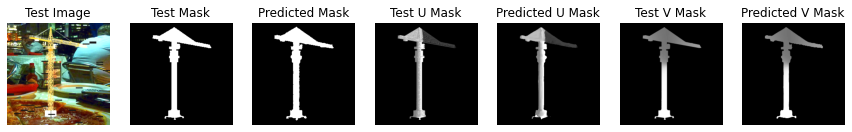

===> Epoch[70/200](0/500): Loss_Mask: 0.0219	Loss_U_Mask: 0.4573	Loss_V_Mask: 0.2091
===> Epoch[70/200](100/500): Loss_Mask: 0.0109	Loss_U_Mask: 0.4626	Loss_V_Mask: 0.2085
===> Epoch[70/200](200/500): Loss_Mask: 0.0114	Loss_U_Mask: 0.4646	Loss_V_Mask: 0.2194
===> Epoch[70/200](300/500): Loss_Mask: 0.0270	Loss_U_Mask: 0.5584	Loss_V_Mask: 0.2775
===> Epoch[70/200](400/500): Loss_Mask: 0.0110	Loss_U_Mask: 0.4897	Loss_V_Mask: 0.2020
===> Epoch[70/200](500/500): Loss_Mask: 0.0087	Loss_U_Mask: 0.3907	Loss_V_Mask: 0.1957
Val_Loss_Mask: 0.0320	Val_U_Loss_Mask: 0.4247	Val_V_Loss_Mask: 0.1853


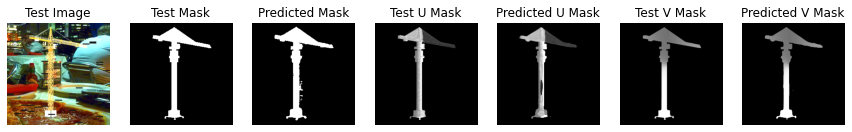

===> Epoch[71/200](0/500): Loss_Mask: 0.0151	Loss_U_Mask: 0.4693	Loss_V_Mask: 0.1963
===> Epoch[71/200](100/500): Loss_Mask: 0.0101	Loss_U_Mask: 0.5015	Loss_V_Mask: 0.2050
===> Epoch[71/200](200/500): Loss_Mask: 0.0107	Loss_U_Mask: 0.5143	Loss_V_Mask: 0.2082
===> Epoch[71/200](300/500): Loss_Mask: 0.0085	Loss_U_Mask: 0.3690	Loss_V_Mask: 0.1766
===> Epoch[71/200](400/500): Loss_Mask: 0.0120	Loss_U_Mask: 0.4705	Loss_V_Mask: 0.2004
===> Epoch[71/200](500/500): Loss_Mask: 0.0136	Loss_U_Mask: 0.4411	Loss_V_Mask: 0.2364
Val_Loss_Mask: 0.0272	Val_U_Loss_Mask: 0.4175	Val_V_Loss_Mask: 0.1836


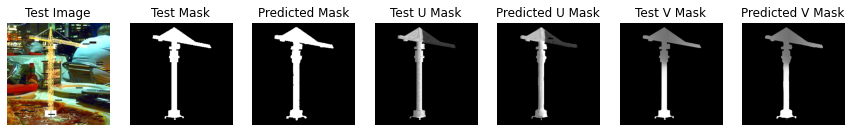

===> Epoch[72/200](0/500): Loss_Mask: 0.0149	Loss_U_Mask: 0.4249	Loss_V_Mask: 0.2102
===> Epoch[72/200](100/500): Loss_Mask: 0.0120	Loss_U_Mask: 0.4553	Loss_V_Mask: 0.2048
===> Epoch[72/200](200/500): Loss_Mask: 0.0120	Loss_U_Mask: 0.5211	Loss_V_Mask: 0.2177
===> Epoch[72/200](300/500): Loss_Mask: 0.0176	Loss_U_Mask: 0.4362	Loss_V_Mask: 0.2258
===> Epoch[72/200](400/500): Loss_Mask: 0.0093	Loss_U_Mask: 0.3857	Loss_V_Mask: 0.1984
===> Epoch[72/200](500/500): Loss_Mask: 0.0159	Loss_U_Mask: 0.4103	Loss_V_Mask: 0.2030
Val_Loss_Mask: 0.0286	Val_U_Loss_Mask: 0.4268	Val_V_Loss_Mask: 0.1926


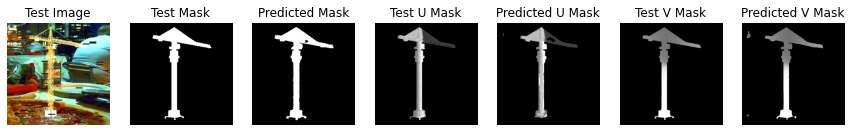

===> Epoch[73/200](0/500): Loss_Mask: 0.0567	Loss_U_Mask: 0.4380	Loss_V_Mask: 0.2291
===> Epoch[73/200](100/500): Loss_Mask: 0.0102	Loss_U_Mask: 0.4797	Loss_V_Mask: 0.2095
===> Epoch[73/200](200/500): Loss_Mask: 0.0105	Loss_U_Mask: 0.4762	Loss_V_Mask: 0.1926
===> Epoch[73/200](300/500): Loss_Mask: 0.0093	Loss_U_Mask: 0.3518	Loss_V_Mask: 0.1930
===> Epoch[73/200](400/500): Loss_Mask: 0.0132	Loss_U_Mask: 0.5305	Loss_V_Mask: 0.2122
===> Epoch[73/200](500/500): Loss_Mask: 0.0216	Loss_U_Mask: 0.5330	Loss_V_Mask: 0.2379
Val_Loss_Mask: 0.0281	Val_U_Loss_Mask: 0.4262	Val_V_Loss_Mask: 0.1880


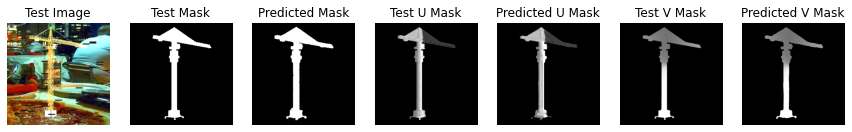

===> Epoch[74/200](0/500): Loss_Mask: 0.0147	Loss_U_Mask: 0.5415	Loss_V_Mask: 0.2180
===> Epoch[74/200](100/500): Loss_Mask: 0.0112	Loss_U_Mask: 0.4048	Loss_V_Mask: 0.2044
===> Epoch[74/200](200/500): Loss_Mask: 0.0334	Loss_U_Mask: 0.5036	Loss_V_Mask: 0.2619
===> Epoch[74/200](300/500): Loss_Mask: 0.0134	Loss_U_Mask: 0.4979	Loss_V_Mask: 0.2334
===> Epoch[74/200](400/500): Loss_Mask: 0.0177	Loss_U_Mask: 0.3925	Loss_V_Mask: 0.2312
===> Epoch[74/200](500/500): Loss_Mask: 0.0193	Loss_U_Mask: 0.5712	Loss_V_Mask: 0.2411
Val_Loss_Mask: 0.0280	Val_U_Loss_Mask: 0.4130	Val_V_Loss_Mask: 0.1774


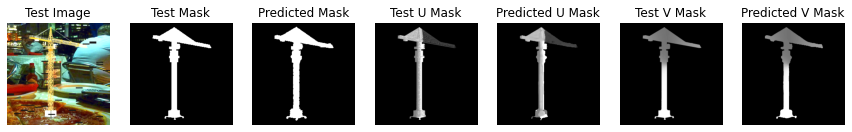

===> Epoch[75/200](0/500): Loss_Mask: 0.0126	Loss_U_Mask: 0.4987	Loss_V_Mask: 0.1792
===> Epoch[75/200](100/500): Loss_Mask: 0.0165	Loss_U_Mask: 0.5127	Loss_V_Mask: 0.2326
===> Epoch[75/200](200/500): Loss_Mask: 0.0106	Loss_U_Mask: 0.5141	Loss_V_Mask: 0.1936
===> Epoch[75/200](300/500): Loss_Mask: 0.0189	Loss_U_Mask: 0.5405	Loss_V_Mask: 0.2587
===> Epoch[75/200](400/500): Loss_Mask: 0.0120	Loss_U_Mask: 0.4100	Loss_V_Mask: 0.2167
===> Epoch[75/200](500/500): Loss_Mask: 0.0133	Loss_U_Mask: 0.5391	Loss_V_Mask: 0.2007
Val_Loss_Mask: 0.0248	Val_U_Loss_Mask: 0.4045	Val_V_Loss_Mask: 0.1795


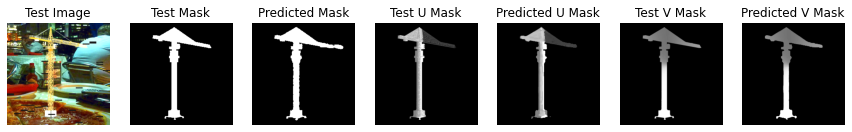

===> Epoch[76/200](0/500): Loss_Mask: 0.0122	Loss_U_Mask: 0.4386	Loss_V_Mask: 0.2029
===> Epoch[76/200](100/500): Loss_Mask: 0.0136	Loss_U_Mask: 0.4266	Loss_V_Mask: 0.2022
===> Epoch[76/200](200/500): Loss_Mask: 0.0147	Loss_U_Mask: 0.4825	Loss_V_Mask: 0.2132
===> Epoch[76/200](300/500): Loss_Mask: 0.0090	Loss_U_Mask: 0.5044	Loss_V_Mask: 0.2036
===> Epoch[76/200](400/500): Loss_Mask: 0.0223	Loss_U_Mask: 0.4558	Loss_V_Mask: 0.2388
===> Epoch[76/200](500/500): Loss_Mask: 0.0105	Loss_U_Mask: 0.4597	Loss_V_Mask: 0.2053
Val_Loss_Mask: 0.0251	Val_U_Loss_Mask: 0.4148	Val_V_Loss_Mask: 0.1822


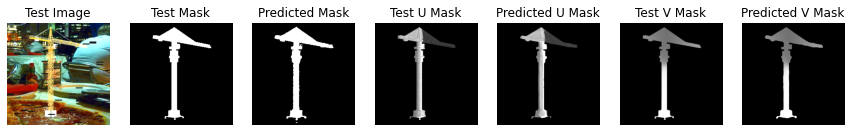

===> Epoch[77/200](0/500): Loss_Mask: 0.0121	Loss_U_Mask: 0.4124	Loss_V_Mask: 0.1995
===> Epoch[77/200](100/500): Loss_Mask: 0.0158	Loss_U_Mask: 0.4208	Loss_V_Mask: 0.2203
===> Epoch[77/200](200/500): Loss_Mask: 0.0146	Loss_U_Mask: 0.4295	Loss_V_Mask: 0.2094
===> Epoch[77/200](300/500): Loss_Mask: 0.0110	Loss_U_Mask: 0.4343	Loss_V_Mask: 0.2124
===> Epoch[77/200](400/500): Loss_Mask: 0.0177	Loss_U_Mask: 0.4865	Loss_V_Mask: 0.2284
===> Epoch[77/200](500/500): Loss_Mask: 0.0350	Loss_U_Mask: 0.5685	Loss_V_Mask: 0.2978
Val_Loss_Mask: 0.0295	Val_U_Loss_Mask: 0.4091	Val_V_Loss_Mask: 0.1861


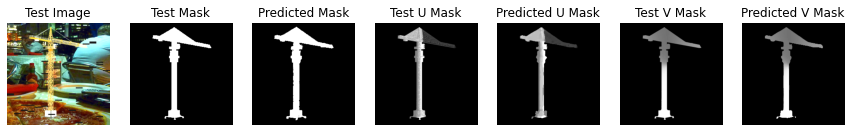

===> Epoch[78/200](0/500): Loss_Mask: 0.0220	Loss_U_Mask: 0.4946	Loss_V_Mask: 0.2137
===> Epoch[78/200](100/500): Loss_Mask: 0.0130	Loss_U_Mask: 0.3894	Loss_V_Mask: 0.2028
===> Epoch[78/200](200/500): Loss_Mask: 0.0111	Loss_U_Mask: 0.4726	Loss_V_Mask: 0.1924
===> Epoch[78/200](300/500): Loss_Mask: 0.0135	Loss_U_Mask: 0.5692	Loss_V_Mask: 0.2440
===> Epoch[78/200](400/500): Loss_Mask: 0.0159	Loss_U_Mask: 0.4934	Loss_V_Mask: 0.2330
===> Epoch[78/200](500/500): Loss_Mask: 0.0105	Loss_U_Mask: 0.4934	Loss_V_Mask: 0.2023
Val_Loss_Mask: 0.0287	Val_U_Loss_Mask: 0.4157	Val_V_Loss_Mask: 0.1825


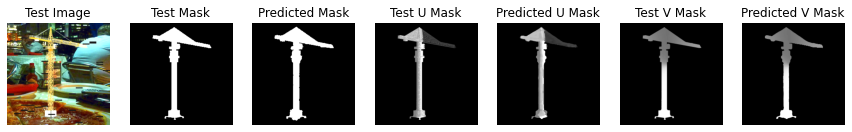

===> Epoch[79/200](0/500): Loss_Mask: 0.0166	Loss_U_Mask: 0.5149	Loss_V_Mask: 0.2201
===> Epoch[79/200](100/500): Loss_Mask: 0.0113	Loss_U_Mask: 0.5095	Loss_V_Mask: 0.2085
===> Epoch[79/200](200/500): Loss_Mask: 0.0107	Loss_U_Mask: 0.4939	Loss_V_Mask: 0.1915
===> Epoch[79/200](300/500): Loss_Mask: 0.0149	Loss_U_Mask: 0.5600	Loss_V_Mask: 0.2345
===> Epoch[79/200](400/500): Loss_Mask: 0.0139	Loss_U_Mask: 0.4368	Loss_V_Mask: 0.2214
===> Epoch[79/200](500/500): Loss_Mask: 0.0165	Loss_U_Mask: 0.4867	Loss_V_Mask: 0.2360
Val_Loss_Mask: 0.0270	Val_U_Loss_Mask: 0.4134	Val_V_Loss_Mask: 0.1820


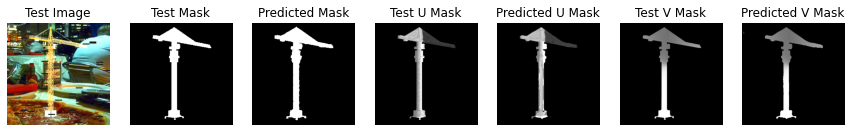

===> Epoch[80/200](0/500): Loss_Mask: 0.0131	Loss_U_Mask: 0.4817	Loss_V_Mask: 0.1898
===> Epoch[80/200](100/500): Loss_Mask: 0.0085	Loss_U_Mask: 0.4337	Loss_V_Mask: 0.1998
===> Epoch[80/200](200/500): Loss_Mask: 0.0174	Loss_U_Mask: 0.4251	Loss_V_Mask: 0.2331
===> Epoch[80/200](300/500): Loss_Mask: 0.0113	Loss_U_Mask: 0.5026	Loss_V_Mask: 0.2200
===> Epoch[80/200](400/500): Loss_Mask: 0.0140	Loss_U_Mask: 0.4262	Loss_V_Mask: 0.2203
===> Epoch[80/200](500/500): Loss_Mask: 0.0103	Loss_U_Mask: 0.5453	Loss_V_Mask: 0.2096
Val_Loss_Mask: 0.0271	Val_U_Loss_Mask: 0.4087	Val_V_Loss_Mask: 0.1776


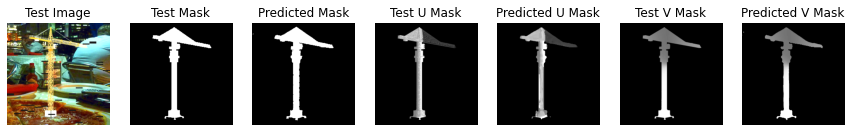

===> Epoch[81/200](0/500): Loss_Mask: 0.0128	Loss_U_Mask: 0.4585	Loss_V_Mask: 0.1837
===> Epoch[81/200](100/500): Loss_Mask: 0.0119	Loss_U_Mask: 0.4953	Loss_V_Mask: 0.2205
===> Epoch[81/200](200/500): Loss_Mask: 0.0134	Loss_U_Mask: 0.4199	Loss_V_Mask: 0.2160
===> Epoch[81/200](300/500): Loss_Mask: 0.0149	Loss_U_Mask: 0.4978	Loss_V_Mask: 0.2282
===> Epoch[81/200](400/500): Loss_Mask: 0.0110	Loss_U_Mask: 0.3933	Loss_V_Mask: 0.1966
===> Epoch[81/200](500/500): Loss_Mask: 0.0329	Loss_U_Mask: 0.4778	Loss_V_Mask: 0.2512
Val_Loss_Mask: 0.0253	Val_U_Loss_Mask: 0.4037	Val_V_Loss_Mask: 0.1781


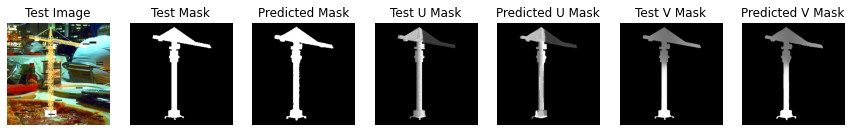

===> Epoch[82/200](0/500): Loss_Mask: 0.0149	Loss_U_Mask: 0.4319	Loss_V_Mask: 0.1904
===> Epoch[82/200](100/500): Loss_Mask: 0.0116	Loss_U_Mask: 0.4706	Loss_V_Mask: 0.1992
===> Epoch[82/200](200/500): Loss_Mask: 0.0119	Loss_U_Mask: 0.4868	Loss_V_Mask: 0.2052
===> Epoch[82/200](300/500): Loss_Mask: 0.0119	Loss_U_Mask: 0.4777	Loss_V_Mask: 0.2174
===> Epoch[82/200](400/500): Loss_Mask: 0.0102	Loss_U_Mask: 0.4525	Loss_V_Mask: 0.1904
===> Epoch[82/200](500/500): Loss_Mask: 0.0173	Loss_U_Mask: 0.5584	Loss_V_Mask: 0.2221
Val_Loss_Mask: 0.0273	Val_U_Loss_Mask: 0.4044	Val_V_Loss_Mask: 0.1788


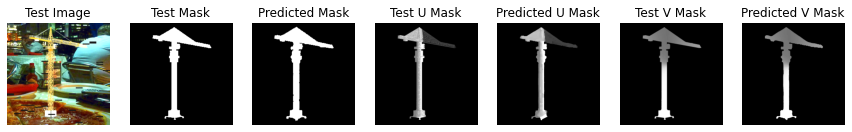

===> Epoch[83/200](0/500): Loss_Mask: 0.0180	Loss_U_Mask: 0.5489	Loss_V_Mask: 0.2139
===> Epoch[83/200](100/500): Loss_Mask: 0.0135	Loss_U_Mask: 0.5143	Loss_V_Mask: 0.2078
===> Epoch[83/200](200/500): Loss_Mask: 0.0092	Loss_U_Mask: 0.4050	Loss_V_Mask: 0.2005
===> Epoch[83/200](300/500): Loss_Mask: 0.0098	Loss_U_Mask: 0.3798	Loss_V_Mask: 0.1994
===> Epoch[83/200](400/500): Loss_Mask: 0.0149	Loss_U_Mask: 0.4370	Loss_V_Mask: 0.2193
===> Epoch[83/200](500/500): Loss_Mask: 0.0228	Loss_U_Mask: 0.5163	Loss_V_Mask: 0.2272
Val_Loss_Mask: 0.0296	Val_U_Loss_Mask: 0.4136	Val_V_Loss_Mask: 0.1836


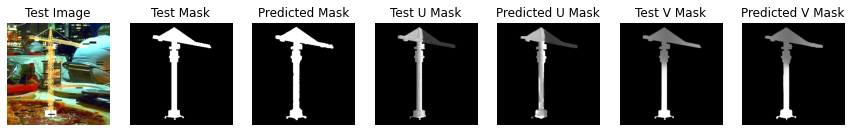

===> Epoch[84/200](0/500): Loss_Mask: 0.0180	Loss_U_Mask: 0.5304	Loss_V_Mask: 0.2296
===> Epoch[84/200](100/500): Loss_Mask: 0.0105	Loss_U_Mask: 0.4199	Loss_V_Mask: 0.2061
===> Epoch[84/200](200/500): Loss_Mask: 0.0134	Loss_U_Mask: 0.3935	Loss_V_Mask: 0.2037
===> Epoch[84/200](300/500): Loss_Mask: 0.0122	Loss_U_Mask: 0.4573	Loss_V_Mask: 0.2023
===> Epoch[84/200](400/500): Loss_Mask: 0.0106	Loss_U_Mask: 0.4362	Loss_V_Mask: 0.2012
===> Epoch[84/200](500/500): Loss_Mask: 0.0151	Loss_U_Mask: 0.4584	Loss_V_Mask: 0.2195
Val_Loss_Mask: 0.0242	Val_U_Loss_Mask: 0.4075	Val_V_Loss_Mask: 0.1816


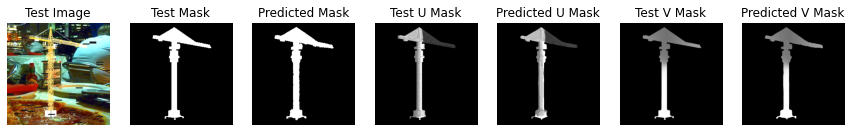

===> Epoch[85/200](0/500): Loss_Mask: 0.0424	Loss_U_Mask: 0.5207	Loss_V_Mask: 0.2762
===> Epoch[85/200](100/500): Loss_Mask: 0.0124	Loss_U_Mask: 0.4860	Loss_V_Mask: 0.2002
===> Epoch[85/200](200/500): Loss_Mask: 0.0181	Loss_U_Mask: 0.4763	Loss_V_Mask: 0.2326
===> Epoch[85/200](300/500): Loss_Mask: 0.0284	Loss_U_Mask: 0.5389	Loss_V_Mask: 0.2488
===> Epoch[85/200](400/500): Loss_Mask: 0.0126	Loss_U_Mask: 0.4325	Loss_V_Mask: 0.2075
===> Epoch[85/200](500/500): Loss_Mask: 0.0122	Loss_U_Mask: 0.5348	Loss_V_Mask: 0.2083
Val_Loss_Mask: 0.0270	Val_U_Loss_Mask: 0.4123	Val_V_Loss_Mask: 0.1816


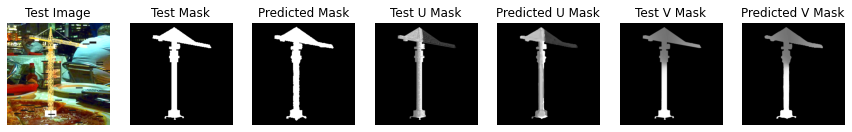

===> Epoch[86/200](0/500): Loss_Mask: 0.0139	Loss_U_Mask: 0.4859	Loss_V_Mask: 0.1977
===> Epoch[86/200](100/500): Loss_Mask: 0.0126	Loss_U_Mask: 0.4035	Loss_V_Mask: 0.2020
===> Epoch[86/200](200/500): Loss_Mask: 0.0095	Loss_U_Mask: 0.5273	Loss_V_Mask: 0.2032
===> Epoch[86/200](300/500): Loss_Mask: 0.0122	Loss_U_Mask: 0.3715	Loss_V_Mask: 0.2027
===> Epoch[86/200](400/500): Loss_Mask: 0.0244	Loss_U_Mask: 0.4259	Loss_V_Mask: 0.2167
===> Epoch[86/200](500/500): Loss_Mask: 0.0203	Loss_U_Mask: 0.4661	Loss_V_Mask: 0.2437
Val_Loss_Mask: 0.0269	Val_U_Loss_Mask: 0.4199	Val_V_Loss_Mask: 0.1847


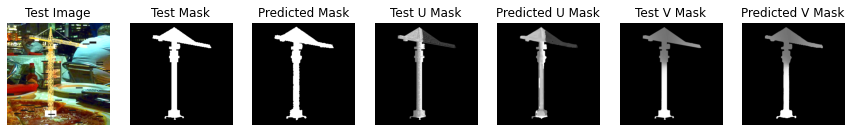

===> Epoch[87/200](0/500): Loss_Mask: 0.0206	Loss_U_Mask: 0.5161	Loss_V_Mask: 0.2382
===> Epoch[87/200](100/500): Loss_Mask: 0.0111	Loss_U_Mask: 0.4519	Loss_V_Mask: 0.1991
===> Epoch[87/200](200/500): Loss_Mask: 0.0120	Loss_U_Mask: 0.5333	Loss_V_Mask: 0.2123
===> Epoch[87/200](300/500): Loss_Mask: 0.0118	Loss_U_Mask: 0.4692	Loss_V_Mask: 0.2010
===> Epoch[87/200](400/500): Loss_Mask: 0.0121	Loss_U_Mask: 0.3615	Loss_V_Mask: 0.2059
===> Epoch[87/200](500/500): Loss_Mask: 0.0217	Loss_U_Mask: 0.5917	Loss_V_Mask: 0.2352
Val_Loss_Mask: 0.0271	Val_U_Loss_Mask: 0.4105	Val_V_Loss_Mask: 0.1804


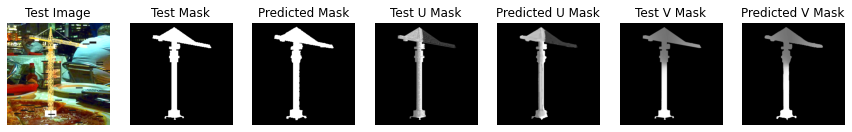

===> Epoch[88/200](0/500): Loss_Mask: 0.0162	Loss_U_Mask: 0.4621	Loss_V_Mask: 0.2053
===> Epoch[88/200](100/500): Loss_Mask: 0.0882	Loss_U_Mask: 0.5021	Loss_V_Mask: 0.2885
===> Epoch[88/200](200/500): Loss_Mask: 0.0156	Loss_U_Mask: 0.5165	Loss_V_Mask: 0.2209
===> Epoch[88/200](300/500): Loss_Mask: 0.0103	Loss_U_Mask: 0.4355	Loss_V_Mask: 0.2087
===> Epoch[88/200](400/500): Loss_Mask: 0.0114	Loss_U_Mask: 0.4255	Loss_V_Mask: 0.2008
===> Epoch[88/200](500/500): Loss_Mask: 0.0519	Loss_U_Mask: 0.4849	Loss_V_Mask: 0.2963
Val_Loss_Mask: 0.0267	Val_U_Loss_Mask: 0.4100	Val_V_Loss_Mask: 0.1782


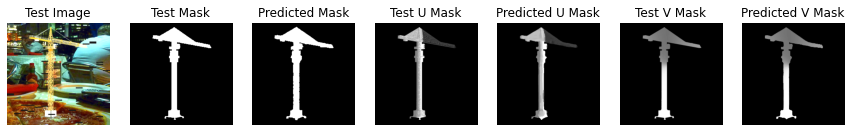

===> Epoch[89/200](0/500): Loss_Mask: 0.0147	Loss_U_Mask: 0.4590	Loss_V_Mask: 0.2051
===> Epoch[89/200](100/500): Loss_Mask: 0.0194	Loss_U_Mask: 0.4744	Loss_V_Mask: 0.2424
===> Epoch[89/200](200/500): Loss_Mask: 0.0188	Loss_U_Mask: 0.4452	Loss_V_Mask: 0.2218
===> Epoch[89/200](300/500): Loss_Mask: 0.0160	Loss_U_Mask: 0.4304	Loss_V_Mask: 0.2270
===> Epoch[89/200](400/500): Loss_Mask: 0.0135	Loss_U_Mask: 0.5321	Loss_V_Mask: 0.2269
===> Epoch[89/200](500/500): Loss_Mask: 0.0093	Loss_U_Mask: 0.5268	Loss_V_Mask: 0.2088
Val_Loss_Mask: 0.0272	Val_U_Loss_Mask: 0.4129	Val_V_Loss_Mask: 0.1813


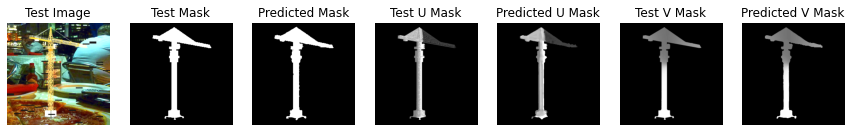

===> Epoch[90/200](0/500): Loss_Mask: 0.0215	Loss_U_Mask: 0.4495	Loss_V_Mask: 0.2167
===> Epoch[90/200](100/500): Loss_Mask: 0.0140	Loss_U_Mask: 0.4318	Loss_V_Mask: 0.2081
===> Epoch[90/200](200/500): Loss_Mask: 0.0160	Loss_U_Mask: 0.5597	Loss_V_Mask: 0.2304
===> Epoch[90/200](300/500): Loss_Mask: 0.0102	Loss_U_Mask: 0.4921	Loss_V_Mask: 0.2013
===> Epoch[90/200](400/500): Loss_Mask: 0.0101	Loss_U_Mask: 0.4620	Loss_V_Mask: 0.2101
===> Epoch[90/200](500/500): Loss_Mask: 0.0089	Loss_U_Mask: 0.4377	Loss_V_Mask: 0.1790
Val_Loss_Mask: 0.0295	Val_U_Loss_Mask: 0.4072	Val_V_Loss_Mask: 0.1785


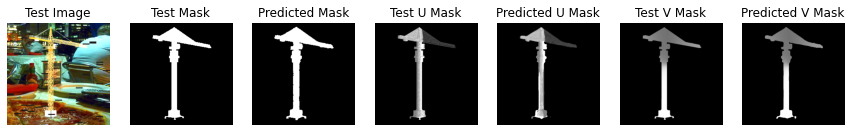

===> Epoch[91/200](0/500): Loss_Mask: 0.0132	Loss_U_Mask: 0.4106	Loss_V_Mask: 0.1804
===> Epoch[91/200](100/500): Loss_Mask: 0.0114	Loss_U_Mask: 0.4188	Loss_V_Mask: 0.1995
===> Epoch[91/200](200/500): Loss_Mask: 0.0209	Loss_U_Mask: 0.4135	Loss_V_Mask: 0.2375
===> Epoch[91/200](300/500): Loss_Mask: 0.0092	Loss_U_Mask: 0.5047	Loss_V_Mask: 0.2051
===> Epoch[91/200](400/500): Loss_Mask: 0.0228	Loss_U_Mask: 0.5395	Loss_V_Mask: 0.2651
===> Epoch[91/200](500/500): Loss_Mask: 0.0131	Loss_U_Mask: 0.4309	Loss_V_Mask: 0.1994
Val_Loss_Mask: 0.0333	Val_U_Loss_Mask: 0.4198	Val_V_Loss_Mask: 0.1940


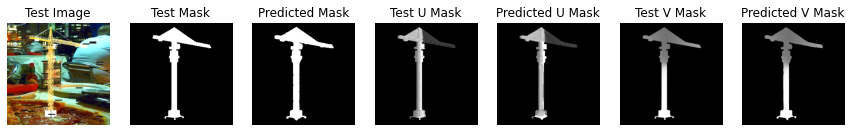

===> Epoch[92/200](0/500): Loss_Mask: 0.0142	Loss_U_Mask: 0.4852	Loss_V_Mask: 0.2065
===> Epoch[92/200](100/500): Loss_Mask: 0.0086	Loss_U_Mask: 0.3263	Loss_V_Mask: 0.1757
===> Epoch[92/200](200/500): Loss_Mask: 0.0126	Loss_U_Mask: 0.4638	Loss_V_Mask: 0.2052
===> Epoch[92/200](300/500): Loss_Mask: 0.0097	Loss_U_Mask: 0.4196	Loss_V_Mask: 0.1897
===> Epoch[92/200](400/500): Loss_Mask: 0.0113	Loss_U_Mask: 0.4583	Loss_V_Mask: 0.1998
===> Epoch[92/200](500/500): Loss_Mask: 0.0134	Loss_U_Mask: 0.4702	Loss_V_Mask: 0.1959
Val_Loss_Mask: 0.0271	Val_U_Loss_Mask: 0.4236	Val_V_Loss_Mask: 0.1858


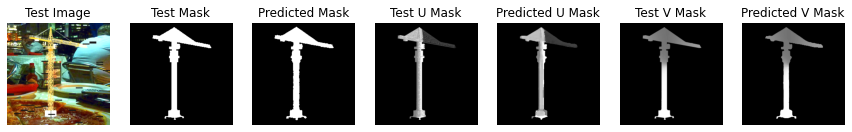

===> Epoch[93/200](0/500): Loss_Mask: 0.0172	Loss_U_Mask: 0.4033	Loss_V_Mask: 0.2147
===> Epoch[93/200](100/500): Loss_Mask: 0.0119	Loss_U_Mask: 0.4205	Loss_V_Mask: 0.2140
===> Epoch[93/200](200/500): Loss_Mask: 0.0093	Loss_U_Mask: 0.3777	Loss_V_Mask: 0.1779
===> Epoch[93/200](300/500): Loss_Mask: 0.0100	Loss_U_Mask: 0.5183	Loss_V_Mask: 0.1983
===> Epoch[93/200](400/500): Loss_Mask: 0.0126	Loss_U_Mask: 0.5115	Loss_V_Mask: 0.2130
===> Epoch[93/200](500/500): Loss_Mask: 0.0103	Loss_U_Mask: 0.4696	Loss_V_Mask: 0.1979
Val_Loss_Mask: 0.0274	Val_U_Loss_Mask: 0.4102	Val_V_Loss_Mask: 0.1778


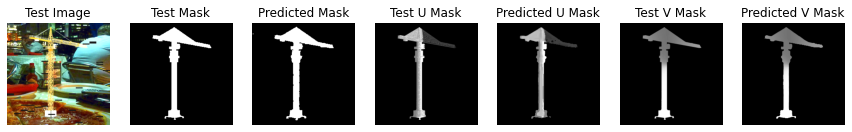

===> Epoch[94/200](0/500): Loss_Mask: 0.0201	Loss_U_Mask: 0.5124	Loss_V_Mask: 0.2246
===> Epoch[94/200](100/500): Loss_Mask: 0.0118	Loss_U_Mask: 0.3785	Loss_V_Mask: 0.1908
===> Epoch[94/200](200/500): Loss_Mask: 0.0163	Loss_U_Mask: 0.4365	Loss_V_Mask: 0.2149
===> Epoch[94/200](300/500): Loss_Mask: 0.0084	Loss_U_Mask: 0.4804	Loss_V_Mask: 0.2000
===> Epoch[94/200](400/500): Loss_Mask: 0.0115	Loss_U_Mask: 0.4405	Loss_V_Mask: 0.2061
===> Epoch[94/200](500/500): Loss_Mask: 0.0096	Loss_U_Mask: 0.4954	Loss_V_Mask: 0.1933
Val_Loss_Mask: 0.0280	Val_U_Loss_Mask: 0.4132	Val_V_Loss_Mask: 0.1812


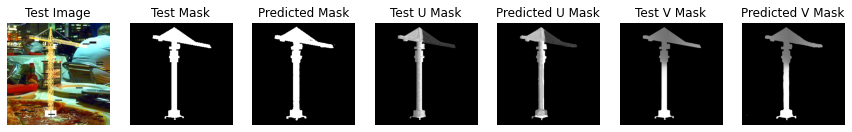

===> Epoch[95/200](0/500): Loss_Mask: 0.0139	Loss_U_Mask: 0.4798	Loss_V_Mask: 0.2033
===> Epoch[95/200](100/500): Loss_Mask: 0.0116	Loss_U_Mask: 0.4749	Loss_V_Mask: 0.1991
===> Epoch[95/200](200/500): Loss_Mask: 0.0157	Loss_U_Mask: 0.4803	Loss_V_Mask: 0.2201
===> Epoch[95/200](300/500): Loss_Mask: 0.0177	Loss_U_Mask: 0.4956	Loss_V_Mask: 0.2332
===> Epoch[95/200](400/500): Loss_Mask: 0.0135	Loss_U_Mask: 0.4676	Loss_V_Mask: 0.2253
===> Epoch[95/200](500/500): Loss_Mask: 0.0147	Loss_U_Mask: 0.5295	Loss_V_Mask: 0.2193
Val_Loss_Mask: 0.0377	Val_U_Loss_Mask: 0.4177	Val_V_Loss_Mask: 0.1918


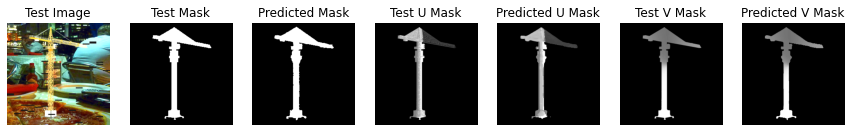

===> Epoch[96/200](0/500): Loss_Mask: 0.0229	Loss_U_Mask: 0.4153	Loss_V_Mask: 0.2127
===> Epoch[96/200](100/500): Loss_Mask: 0.0094	Loss_U_Mask: 0.4158	Loss_V_Mask: 0.1874
===> Epoch[96/200](200/500): Loss_Mask: 0.0215	Loss_U_Mask: 0.4725	Loss_V_Mask: 0.2332
===> Epoch[96/200](300/500): Loss_Mask: 0.0137	Loss_U_Mask: 0.5213	Loss_V_Mask: 0.2260
===> Epoch[96/200](400/500): Loss_Mask: 0.0092	Loss_U_Mask: 0.5201	Loss_V_Mask: 0.2075
===> Epoch[96/200](500/500): Loss_Mask: 0.0122	Loss_U_Mask: 0.4643	Loss_V_Mask: 0.2139
Val_Loss_Mask: 0.0298	Val_U_Loss_Mask: 0.4160	Val_V_Loss_Mask: 0.1818


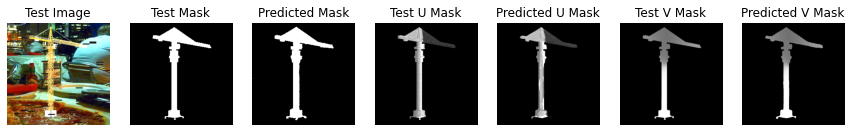

===> Epoch[97/200](0/500): Loss_Mask: 0.0239	Loss_U_Mask: 0.4653	Loss_V_Mask: 0.2206
===> Epoch[97/200](100/500): Loss_Mask: 0.0126	Loss_U_Mask: 0.5266	Loss_V_Mask: 0.2009
===> Epoch[97/200](200/500): Loss_Mask: 0.0103	Loss_U_Mask: 0.5057	Loss_V_Mask: 0.1991
===> Epoch[97/200](300/500): Loss_Mask: 0.0151	Loss_U_Mask: 0.4892	Loss_V_Mask: 0.2192
===> Epoch[97/200](400/500): Loss_Mask: 0.0115	Loss_U_Mask: 0.5111	Loss_V_Mask: 0.1985
===> Epoch[97/200](500/500): Loss_Mask: 0.0143	Loss_U_Mask: 0.4190	Loss_V_Mask: 0.2101
Val_Loss_Mask: 0.0283	Val_U_Loss_Mask: 0.4129	Val_V_Loss_Mask: 0.1832


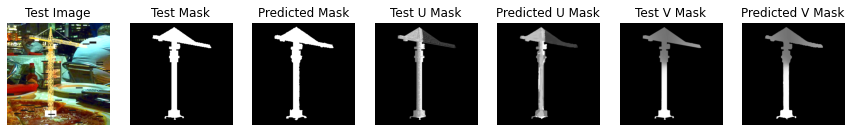

===> Epoch[98/200](0/500): Loss_Mask: 0.0171	Loss_U_Mask: 0.5074	Loss_V_Mask: 0.2020
===> Epoch[98/200](100/500): Loss_Mask: 0.0106	Loss_U_Mask: 0.3415	Loss_V_Mask: 0.1901
===> Epoch[98/200](200/500): Loss_Mask: 0.0099	Loss_U_Mask: 0.4191	Loss_V_Mask: 0.1940
===> Epoch[98/200](300/500): Loss_Mask: 0.0118	Loss_U_Mask: 0.4620	Loss_V_Mask: 0.2093
===> Epoch[98/200](400/500): Loss_Mask: 0.0169	Loss_U_Mask: 0.4326	Loss_V_Mask: 0.2150
===> Epoch[98/200](500/500): Loss_Mask: 0.0110	Loss_U_Mask: 0.4504	Loss_V_Mask: 0.1906
Val_Loss_Mask: 0.0316	Val_U_Loss_Mask: 0.4187	Val_V_Loss_Mask: 0.1873


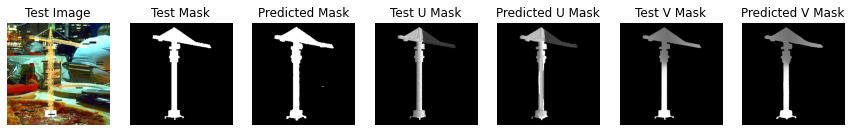

===> Epoch[99/200](0/500): Loss_Mask: 0.0202	Loss_U_Mask: 0.4639	Loss_V_Mask: 0.2141
===> Epoch[99/200](100/500): Loss_Mask: 0.0219	Loss_U_Mask: 0.4091	Loss_V_Mask: 0.2185
===> Epoch[99/200](200/500): Loss_Mask: 0.0096	Loss_U_Mask: 0.5128	Loss_V_Mask: 0.2017
===> Epoch[99/200](300/500): Loss_Mask: 0.0118	Loss_U_Mask: 0.4943	Loss_V_Mask: 0.1921
===> Epoch[99/200](400/500): Loss_Mask: 0.0109	Loss_U_Mask: 0.5095	Loss_V_Mask: 0.1984
===> Epoch[99/200](500/500): Loss_Mask: 0.0136	Loss_U_Mask: 0.4895	Loss_V_Mask: 0.2118
Val_Loss_Mask: 0.0314	Val_U_Loss_Mask: 0.4283	Val_V_Loss_Mask: 0.1897


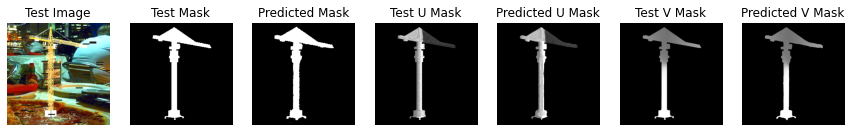

===> Epoch[100/200](0/500): Loss_Mask: 0.0131	Loss_U_Mask: 0.4719	Loss_V_Mask: 0.1897
===> Epoch[100/200](100/500): Loss_Mask: 0.0107	Loss_U_Mask: 0.5257	Loss_V_Mask: 0.2159
===> Epoch[100/200](200/500): Loss_Mask: 0.0092	Loss_U_Mask: 0.4128	Loss_V_Mask: 0.1859
===> Epoch[100/200](300/500): Loss_Mask: 0.0108	Loss_U_Mask: 0.4736	Loss_V_Mask: 0.2156
===> Epoch[100/200](400/500): Loss_Mask: 0.0196	Loss_U_Mask: 0.5090	Loss_V_Mask: 0.2310
===> Epoch[100/200](500/500): Loss_Mask: 0.0138	Loss_U_Mask: 0.5511	Loss_V_Mask: 0.2506
Val_Loss_Mask: 0.0481	Val_U_Loss_Mask: 0.4435	Val_V_Loss_Mask: 0.2211


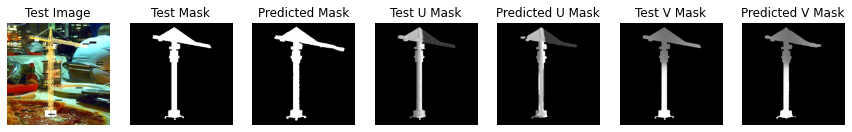

===> Epoch[101/200](0/500): Loss_Mask: 0.0221	Loss_U_Mask: 0.5113	Loss_V_Mask: 0.2282
===> Epoch[101/200](100/500): Loss_Mask: 0.0118	Loss_U_Mask: 0.5470	Loss_V_Mask: 0.2089
===> Epoch[101/200](200/500): Loss_Mask: 0.0102	Loss_U_Mask: 0.4983	Loss_V_Mask: 0.1924
===> Epoch[101/200](300/500): Loss_Mask: 0.0126	Loss_U_Mask: 0.4700	Loss_V_Mask: 0.2089
===> Epoch[101/200](400/500): Loss_Mask: 0.0089	Loss_U_Mask: 0.3238	Loss_V_Mask: 0.1742
===> Epoch[101/200](500/500): Loss_Mask: 0.0117	Loss_U_Mask: 0.5149	Loss_V_Mask: 0.2095
Val_Loss_Mask: 0.0290	Val_U_Loss_Mask: 0.4153	Val_V_Loss_Mask: 0.1849


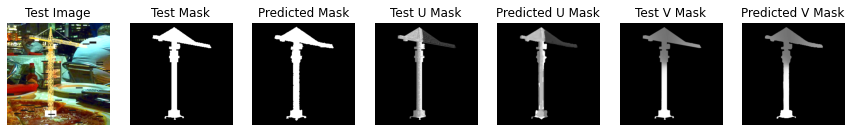

===> Epoch[102/200](0/500): Loss_Mask: 0.0236	Loss_U_Mask: 0.4398	Loss_V_Mask: 0.2233
===> Epoch[102/200](100/500): Loss_Mask: 0.0106	Loss_U_Mask: 0.4969	Loss_V_Mask: 0.2143
===> Epoch[102/200](200/500): Loss_Mask: 0.0095	Loss_U_Mask: 0.4620	Loss_V_Mask: 0.1999
===> Epoch[102/200](300/500): Loss_Mask: 0.0096	Loss_U_Mask: 0.4653	Loss_V_Mask: 0.1958
===> Epoch[102/200](400/500): Loss_Mask: 0.0098	Loss_U_Mask: 0.5025	Loss_V_Mask: 0.2017
===> Epoch[102/200](500/500): Loss_Mask: 0.0156	Loss_U_Mask: 0.5289	Loss_V_Mask: 0.2257
Val_Loss_Mask: 0.0321	Val_U_Loss_Mask: 0.4190	Val_V_Loss_Mask: 0.1891


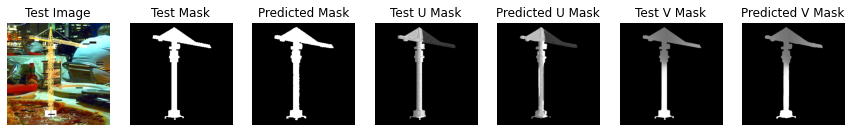

===> Epoch[103/200](0/500): Loss_Mask: 0.0182	Loss_U_Mask: 0.4955	Loss_V_Mask: 0.2391
===> Epoch[103/200](100/500): Loss_Mask: 0.0101	Loss_U_Mask: 0.4520	Loss_V_Mask: 0.2022
===> Epoch[103/200](200/500): Loss_Mask: 0.0094	Loss_U_Mask: 0.3841	Loss_V_Mask: 0.1904
===> Epoch[103/200](300/500): Loss_Mask: 0.0134	Loss_U_Mask: 0.3897	Loss_V_Mask: 0.1969
===> Epoch[103/200](400/500): Loss_Mask: 0.0296	Loss_U_Mask: 0.4011	Loss_V_Mask: 0.2277
===> Epoch[103/200](500/500): Loss_Mask: 0.0103	Loss_U_Mask: 0.4329	Loss_V_Mask: 0.1978
Val_Loss_Mask: 0.0261	Val_U_Loss_Mask: 0.4092	Val_V_Loss_Mask: 0.1782


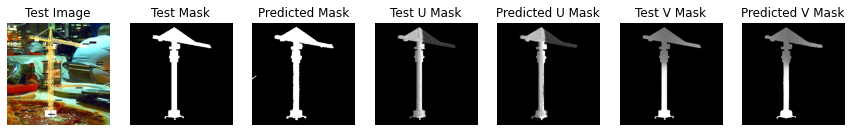

===> Epoch[104/200](0/500): Loss_Mask: 0.0125	Loss_U_Mask: 0.5412	Loss_V_Mask: 0.2115
===> Epoch[104/200](100/500): Loss_Mask: 0.0121	Loss_U_Mask: 0.4572	Loss_V_Mask: 0.2094
===> Epoch[104/200](200/500): Loss_Mask: 0.0086	Loss_U_Mask: 0.4560	Loss_V_Mask: 0.1911
===> Epoch[104/200](300/500): Loss_Mask: 0.0105	Loss_U_Mask: 0.5217	Loss_V_Mask: 0.1967
===> Epoch[104/200](400/500): Loss_Mask: 0.0105	Loss_U_Mask: 0.4655	Loss_V_Mask: 0.2016
===> Epoch[104/200](500/500): Loss_Mask: 0.0104	Loss_U_Mask: 0.3947	Loss_V_Mask: 0.1909
Val_Loss_Mask: 0.0259	Val_U_Loss_Mask: 0.4115	Val_V_Loss_Mask: 0.1809


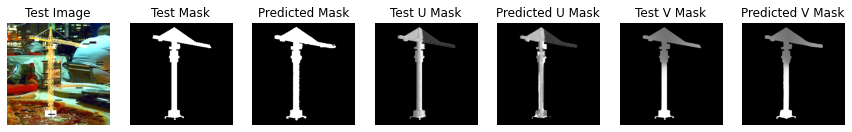

===> Epoch[105/200](0/500): Loss_Mask: 0.0153	Loss_U_Mask: 0.5383	Loss_V_Mask: 0.1971
===> Epoch[105/200](100/500): Loss_Mask: 0.0126	Loss_U_Mask: 0.5111	Loss_V_Mask: 0.2215
===> Epoch[105/200](200/500): Loss_Mask: 0.0129	Loss_U_Mask: 0.3562	Loss_V_Mask: 0.2021
===> Epoch[105/200](300/500): Loss_Mask: 0.0121	Loss_U_Mask: 0.4716	Loss_V_Mask: 0.2050
===> Epoch[105/200](400/500): Loss_Mask: 0.0145	Loss_U_Mask: 0.5278	Loss_V_Mask: 0.2068
===> Epoch[105/200](500/500): Loss_Mask: 0.0129	Loss_U_Mask: 0.4784	Loss_V_Mask: 0.2107
Val_Loss_Mask: 0.0243	Val_U_Loss_Mask: 0.4151	Val_V_Loss_Mask: 0.1797


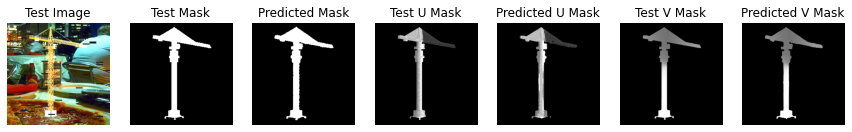

===> Epoch[106/200](0/500): Loss_Mask: 0.0161	Loss_U_Mask: 0.4458	Loss_V_Mask: 0.1941
===> Epoch[106/200](100/500): Loss_Mask: 0.0082	Loss_U_Mask: 0.4469	Loss_V_Mask: 0.1932
===> Epoch[106/200](200/500): Loss_Mask: 0.0107	Loss_U_Mask: 0.4473	Loss_V_Mask: 0.1922
===> Epoch[106/200](300/500): Loss_Mask: 0.0098	Loss_U_Mask: 0.4141	Loss_V_Mask: 0.1964
===> Epoch[106/200](400/500): Loss_Mask: 0.0142	Loss_U_Mask: 0.5100	Loss_V_Mask: 0.2203
===> Epoch[106/200](500/500): Loss_Mask: 0.0099	Loss_U_Mask: 0.4894	Loss_V_Mask: 0.2015
Val_Loss_Mask: 0.0232	Val_U_Loss_Mask: 0.4097	Val_V_Loss_Mask: 0.1756


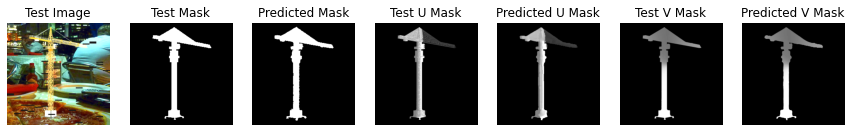

===> Epoch[107/200](0/500): Loss_Mask: 0.0118	Loss_U_Mask: 0.4580	Loss_V_Mask: 0.1791
===> Epoch[107/200](100/500): Loss_Mask: 0.0097	Loss_U_Mask: 0.5081	Loss_V_Mask: 0.2066
===> Epoch[107/200](200/500): Loss_Mask: 0.0134	Loss_U_Mask: 0.5011	Loss_V_Mask: 0.2104
===> Epoch[107/200](300/500): Loss_Mask: 0.0108	Loss_U_Mask: 0.4947	Loss_V_Mask: 0.1893
===> Epoch[107/200](400/500): Loss_Mask: 0.0135	Loss_U_Mask: 0.3930	Loss_V_Mask: 0.1880
===> Epoch[107/200](500/500): Loss_Mask: 0.0107	Loss_U_Mask: 0.4605	Loss_V_Mask: 0.1927
Val_Loss_Mask: 0.0289	Val_U_Loss_Mask: 0.4184	Val_V_Loss_Mask: 0.1784


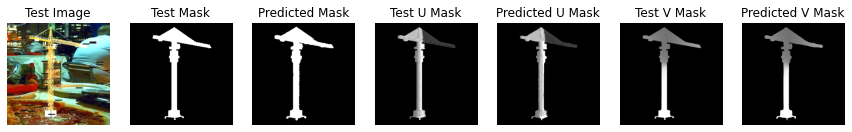

===> Epoch[108/200](0/500): Loss_Mask: 0.0143	Loss_U_Mask: 0.5380	Loss_V_Mask: 0.2018
===> Epoch[108/200](100/500): Loss_Mask: 0.0089	Loss_U_Mask: 0.4865	Loss_V_Mask: 0.2060
===> Epoch[108/200](200/500): Loss_Mask: 0.0195	Loss_U_Mask: 0.4352	Loss_V_Mask: 0.2085
===> Epoch[108/200](300/500): Loss_Mask: 0.0092	Loss_U_Mask: 0.3913	Loss_V_Mask: 0.1893
===> Epoch[108/200](400/500): Loss_Mask: 0.0151	Loss_U_Mask: 0.5003	Loss_V_Mask: 0.2180
===> Epoch[108/200](500/500): Loss_Mask: 0.0132	Loss_U_Mask: 0.4624	Loss_V_Mask: 0.2237
Val_Loss_Mask: 0.0285	Val_U_Loss_Mask: 0.4250	Val_V_Loss_Mask: 0.1811


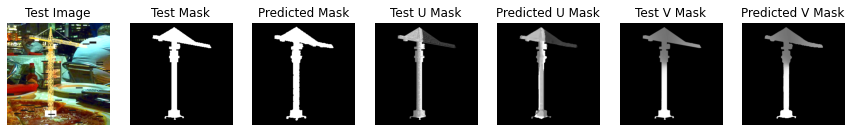

===> Epoch[109/200](0/500): Loss_Mask: 0.0174	Loss_U_Mask: 0.5416	Loss_V_Mask: 0.2188
===> Epoch[109/200](100/500): Loss_Mask: 0.0100	Loss_U_Mask: 0.4131	Loss_V_Mask: 0.1989
===> Epoch[109/200](200/500): Loss_Mask: 0.0150	Loss_U_Mask: 0.4863	Loss_V_Mask: 0.2113
===> Epoch[109/200](300/500): Loss_Mask: 0.0132	Loss_U_Mask: 0.4530	Loss_V_Mask: 0.2048
===> Epoch[109/200](400/500): Loss_Mask: 0.0163	Loss_U_Mask: 0.5142	Loss_V_Mask: 0.2199
===> Epoch[109/200](500/500): Loss_Mask: 0.0112	Loss_U_Mask: 0.4077	Loss_V_Mask: 0.2069
Val_Loss_Mask: 0.0242	Val_U_Loss_Mask: 0.4097	Val_V_Loss_Mask: 0.1798


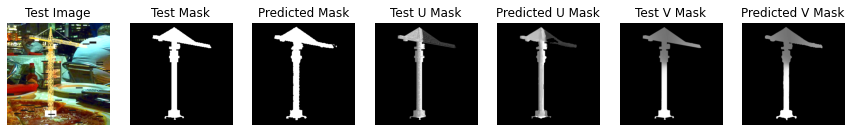

===> Epoch[110/200](0/500): Loss_Mask: 0.0167	Loss_U_Mask: 0.5093	Loss_V_Mask: 0.2339
===> Epoch[110/200](100/500): Loss_Mask: 0.0100	Loss_U_Mask: 0.3661	Loss_V_Mask: 0.2061
===> Epoch[110/200](200/500): Loss_Mask: 0.0184	Loss_U_Mask: 0.4344	Loss_V_Mask: 0.2311
===> Epoch[110/200](300/500): Loss_Mask: 0.0124	Loss_U_Mask: 0.4928	Loss_V_Mask: 0.2005
===> Epoch[110/200](400/500): Loss_Mask: 0.0087	Loss_U_Mask: 0.4437	Loss_V_Mask: 0.1900
===> Epoch[110/200](500/500): Loss_Mask: 0.0164	Loss_U_Mask: 0.5122	Loss_V_Mask: 0.2099
Val_Loss_Mask: 0.0319	Val_U_Loss_Mask: 0.4170	Val_V_Loss_Mask: 0.1893


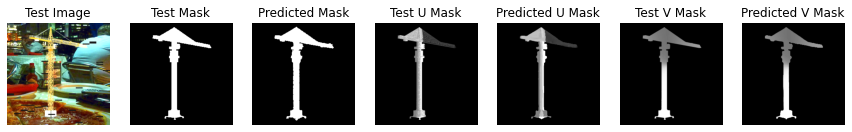

===> Epoch[111/200](0/500): Loss_Mask: 0.0140	Loss_U_Mask: 0.4085	Loss_V_Mask: 0.2130
===> Epoch[111/200](100/500): Loss_Mask: 0.0906	Loss_U_Mask: 0.5865	Loss_V_Mask: 0.2844
===> Epoch[111/200](200/500): Loss_Mask: 0.0102	Loss_U_Mask: 0.4623	Loss_V_Mask: 0.2162
===> Epoch[111/200](300/500): Loss_Mask: 0.0416	Loss_U_Mask: 0.4154	Loss_V_Mask: 0.2649
===> Epoch[111/200](400/500): Loss_Mask: 0.0110	Loss_U_Mask: 0.5260	Loss_V_Mask: 0.2004
===> Epoch[111/200](500/500): Loss_Mask: 0.0153	Loss_U_Mask: 0.5312	Loss_V_Mask: 0.2261
Val_Loss_Mask: 0.0281	Val_U_Loss_Mask: 0.4201	Val_V_Loss_Mask: 0.1855


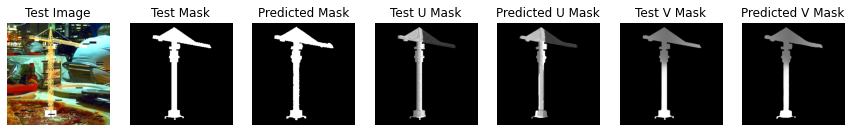

===> Epoch[112/200](0/500): Loss_Mask: 0.0132	Loss_U_Mask: 0.4645	Loss_V_Mask: 0.1860
===> Epoch[112/200](100/500): Loss_Mask: 0.0176	Loss_U_Mask: 0.4065	Loss_V_Mask: 0.2206
===> Epoch[112/200](200/500): Loss_Mask: 0.0173	Loss_U_Mask: 0.4263	Loss_V_Mask: 0.2066
===> Epoch[112/200](300/500): Loss_Mask: 0.0102	Loss_U_Mask: 0.4338	Loss_V_Mask: 0.1974
===> Epoch[112/200](400/500): Loss_Mask: 0.0095	Loss_U_Mask: 0.4511	Loss_V_Mask: 0.1954
===> Epoch[112/200](500/500): Loss_Mask: 0.0081	Loss_U_Mask: 0.4394	Loss_V_Mask: 0.1853
Val_Loss_Mask: 0.0295	Val_U_Loss_Mask: 0.4123	Val_V_Loss_Mask: 0.1821


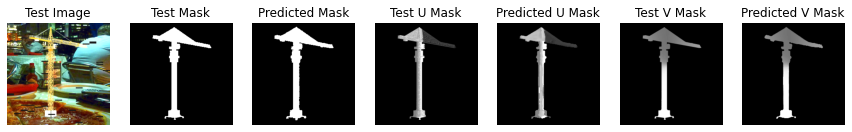

===> Epoch[113/200](0/500): Loss_Mask: 0.0117	Loss_U_Mask: 0.3727	Loss_V_Mask: 0.1836
===> Epoch[113/200](100/500): Loss_Mask: 0.0110	Loss_U_Mask: 0.4407	Loss_V_Mask: 0.2035
===> Epoch[113/200](200/500): Loss_Mask: 0.0098	Loss_U_Mask: 0.5963	Loss_V_Mask: 0.2163
===> Epoch[113/200](300/500): Loss_Mask: 0.0098	Loss_U_Mask: 0.3583	Loss_V_Mask: 0.1829
===> Epoch[113/200](400/500): Loss_Mask: 0.0100	Loss_U_Mask: 0.4461	Loss_V_Mask: 0.1932
===> Epoch[113/200](500/500): Loss_Mask: 0.0101	Loss_U_Mask: 0.4799	Loss_V_Mask: 0.2062
Val_Loss_Mask: 0.0274	Val_U_Loss_Mask: 0.4078	Val_V_Loss_Mask: 0.1777


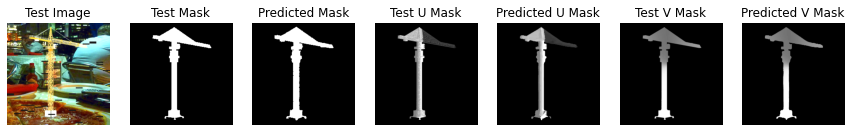

===> Epoch[114/200](0/500): Loss_Mask: 0.0121	Loss_U_Mask: 0.4384	Loss_V_Mask: 0.1812
===> Epoch[114/200](100/500): Loss_Mask: 0.0145	Loss_U_Mask: 0.5338	Loss_V_Mask: 0.2187
===> Epoch[114/200](200/500): Loss_Mask: 0.0122	Loss_U_Mask: 0.4677	Loss_V_Mask: 0.2087
===> Epoch[114/200](300/500): Loss_Mask: 0.0123	Loss_U_Mask: 0.4490	Loss_V_Mask: 0.1922
===> Epoch[114/200](400/500): Loss_Mask: 0.0150	Loss_U_Mask: 0.4333	Loss_V_Mask: 0.2211
===> Epoch[114/200](500/500): Loss_Mask: 0.0115	Loss_U_Mask: 0.4839	Loss_V_Mask: 0.1965
Val_Loss_Mask: 0.0294	Val_U_Loss_Mask: 0.4165	Val_V_Loss_Mask: 0.1815


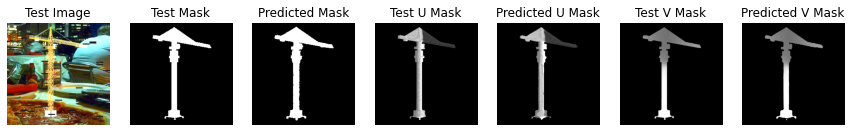

===> Epoch[115/200](0/500): Loss_Mask: 0.0153	Loss_U_Mask: 0.5109	Loss_V_Mask: 0.2374
===> Epoch[115/200](100/500): Loss_Mask: 0.0094	Loss_U_Mask: 0.4467	Loss_V_Mask: 0.1922
===> Epoch[115/200](200/500): Loss_Mask: 0.0103	Loss_U_Mask: 0.4842	Loss_V_Mask: 0.1989
===> Epoch[115/200](300/500): Loss_Mask: 0.0184	Loss_U_Mask: 0.4945	Loss_V_Mask: 0.2365
===> Epoch[115/200](400/500): Loss_Mask: 0.0098	Loss_U_Mask: 0.5181	Loss_V_Mask: 0.1957
===> Epoch[115/200](500/500): Loss_Mask: 0.0109	Loss_U_Mask: 0.4777	Loss_V_Mask: 0.2133
Val_Loss_Mask: 0.0325	Val_U_Loss_Mask: 0.4214	Val_V_Loss_Mask: 0.1918


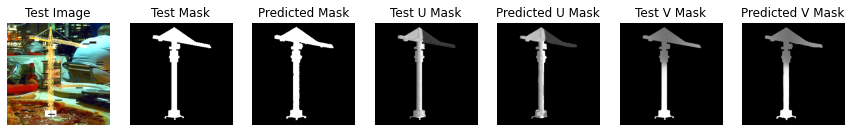

===> Epoch[116/200](0/500): Loss_Mask: 0.0140	Loss_U_Mask: 0.4376	Loss_V_Mask: 0.1888
===> Epoch[116/200](100/500): Loss_Mask: 0.0172	Loss_U_Mask: 0.4791	Loss_V_Mask: 0.2212
===> Epoch[116/200](200/500): Loss_Mask: 0.0255	Loss_U_Mask: 0.3960	Loss_V_Mask: 0.2272
===> Epoch[116/200](300/500): Loss_Mask: 0.0123	Loss_U_Mask: 0.5355	Loss_V_Mask: 0.2129
===> Epoch[116/200](400/500): Loss_Mask: 0.0145	Loss_U_Mask: 0.4507	Loss_V_Mask: 0.2112
===> Epoch[116/200](500/500): Loss_Mask: 0.0120	Loss_U_Mask: 0.4333	Loss_V_Mask: 0.2115
Val_Loss_Mask: 0.0283	Val_U_Loss_Mask: 0.4059	Val_V_Loss_Mask: 0.1812


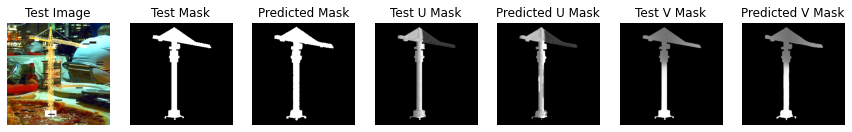

===> Epoch[117/200](0/500): Loss_Mask: 0.0185	Loss_U_Mask: 0.4909	Loss_V_Mask: 0.2278
===> Epoch[117/200](100/500): Loss_Mask: 0.0127	Loss_U_Mask: 0.3211	Loss_V_Mask: 0.1868
===> Epoch[117/200](200/500): Loss_Mask: 0.0129	Loss_U_Mask: 0.5131	Loss_V_Mask: 0.2107
===> Epoch[117/200](300/500): Loss_Mask: 0.0138	Loss_U_Mask: 0.5112	Loss_V_Mask: 0.2223
===> Epoch[117/200](400/500): Loss_Mask: 0.0099	Loss_U_Mask: 0.4274	Loss_V_Mask: 0.2154
===> Epoch[117/200](500/500): Loss_Mask: 0.0115	Loss_U_Mask: 0.5034	Loss_V_Mask: 0.1992
Val_Loss_Mask: 0.0257	Val_U_Loss_Mask: 0.4127	Val_V_Loss_Mask: 0.1829


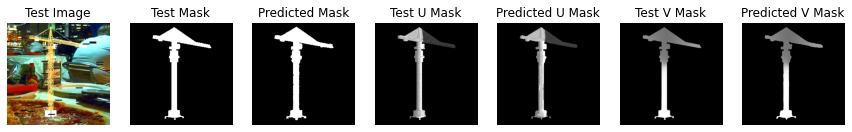

===> Epoch[118/200](0/500): Loss_Mask: 0.0210	Loss_U_Mask: 0.5389	Loss_V_Mask: 0.2054
===> Epoch[118/200](100/500): Loss_Mask: 0.0133	Loss_U_Mask: 0.4645	Loss_V_Mask: 0.2111
===> Epoch[118/200](200/500): Loss_Mask: 0.0215	Loss_U_Mask: 0.4144	Loss_V_Mask: 0.2069
===> Epoch[118/200](300/500): Loss_Mask: 0.0124	Loss_U_Mask: 0.4999	Loss_V_Mask: 0.2095
===> Epoch[118/200](400/500): Loss_Mask: 0.0118	Loss_U_Mask: 0.4340	Loss_V_Mask: 0.2105
===> Epoch[118/200](500/500): Loss_Mask: 0.0099	Loss_U_Mask: 0.4738	Loss_V_Mask: 0.2061
Val_Loss_Mask: 0.0305	Val_U_Loss_Mask: 0.4123	Val_V_Loss_Mask: 0.1807


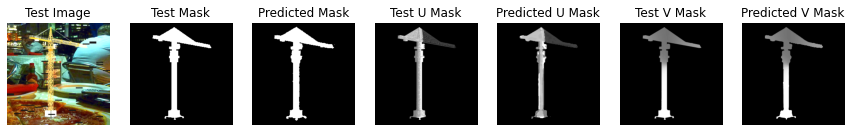

===> Epoch[119/200](0/500): Loss_Mask: 0.0136	Loss_U_Mask: 0.4822	Loss_V_Mask: 0.1955
===> Epoch[119/200](100/500): Loss_Mask: 0.0102	Loss_U_Mask: 0.4676	Loss_V_Mask: 0.2123
===> Epoch[119/200](200/500): Loss_Mask: 0.0124	Loss_U_Mask: 0.4116	Loss_V_Mask: 0.2040
===> Epoch[119/200](300/500): Loss_Mask: 0.0132	Loss_U_Mask: 0.5297	Loss_V_Mask: 0.2113
===> Epoch[119/200](400/500): Loss_Mask: 0.0121	Loss_U_Mask: 0.5264	Loss_V_Mask: 0.2205
===> Epoch[119/200](500/500): Loss_Mask: 0.0135	Loss_U_Mask: 0.5124	Loss_V_Mask: 0.2248
Val_Loss_Mask: 0.0247	Val_U_Loss_Mask: 0.3990	Val_V_Loss_Mask: 0.1724


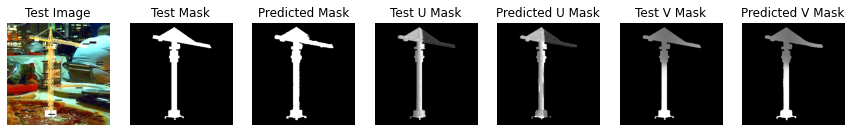

===> Epoch[120/200](0/500): Loss_Mask: 0.0117	Loss_U_Mask: 0.4233	Loss_V_Mask: 0.1811
===> Epoch[120/200](100/500): Loss_Mask: 0.0129	Loss_U_Mask: 0.4316	Loss_V_Mask: 0.2067
===> Epoch[120/200](200/500): Loss_Mask: 0.0093	Loss_U_Mask: 0.5308	Loss_V_Mask: 0.1927
===> Epoch[120/200](300/500): Loss_Mask: 0.0148	Loss_U_Mask: 0.5136	Loss_V_Mask: 0.2136
===> Epoch[120/200](400/500): Loss_Mask: 0.0135	Loss_U_Mask: 0.4061	Loss_V_Mask: 0.1964
===> Epoch[120/200](500/500): Loss_Mask: 0.0105	Loss_U_Mask: 0.4509	Loss_V_Mask: 0.1884
Val_Loss_Mask: 0.0265	Val_U_Loss_Mask: 0.4052	Val_V_Loss_Mask: 0.1769


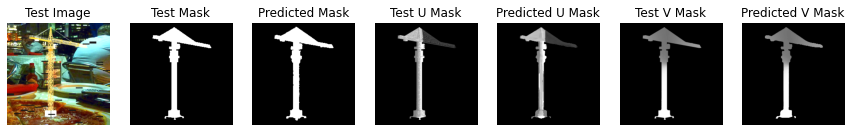

===> Epoch[121/200](0/500): Loss_Mask: 0.0113	Loss_U_Mask: 0.5301	Loss_V_Mask: 0.1969
===> Epoch[121/200](100/500): Loss_Mask: 0.0083	Loss_U_Mask: 0.3404	Loss_V_Mask: 0.1855
===> Epoch[121/200](200/500): Loss_Mask: 0.0079	Loss_U_Mask: 0.3796	Loss_V_Mask: 0.1851
===> Epoch[121/200](300/500): Loss_Mask: 0.0135	Loss_U_Mask: 0.4233	Loss_V_Mask: 0.2062
===> Epoch[121/200](400/500): Loss_Mask: 0.0123	Loss_U_Mask: 0.5531	Loss_V_Mask: 0.2237
===> Epoch[121/200](500/500): Loss_Mask: 0.0109	Loss_U_Mask: 0.4067	Loss_V_Mask: 0.2022
Val_Loss_Mask: 0.0251	Val_U_Loss_Mask: 0.4040	Val_V_Loss_Mask: 0.1768


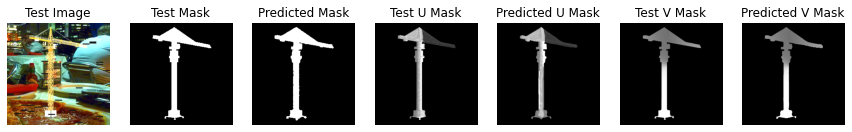

===> Epoch[122/200](0/500): Loss_Mask: 0.0199	Loss_U_Mask: 0.4665	Loss_V_Mask: 0.2185
===> Epoch[122/200](100/500): Loss_Mask: 0.0099	Loss_U_Mask: 0.4319	Loss_V_Mask: 0.1961
===> Epoch[122/200](200/500): Loss_Mask: 0.0146	Loss_U_Mask: 0.5074	Loss_V_Mask: 0.2184
===> Epoch[122/200](300/500): Loss_Mask: 0.0118	Loss_U_Mask: 0.4765	Loss_V_Mask: 0.1959
===> Epoch[122/200](400/500): Loss_Mask: 0.0159	Loss_U_Mask: 0.4361	Loss_V_Mask: 0.2140
===> Epoch[122/200](500/500): Loss_Mask: 0.0094	Loss_U_Mask: 0.4515	Loss_V_Mask: 0.2024
Val_Loss_Mask: 0.0273	Val_U_Loss_Mask: 0.4155	Val_V_Loss_Mask: 0.1828


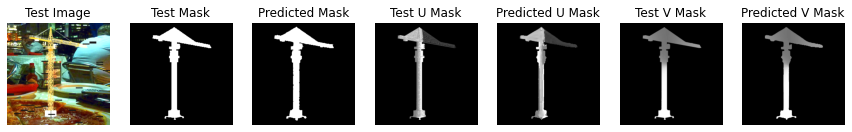

===> Epoch[123/200](0/500): Loss_Mask: 0.0097	Loss_U_Mask: 0.3619	Loss_V_Mask: 0.1671
===> Epoch[123/200](100/500): Loss_Mask: 0.0147	Loss_U_Mask: 0.4884	Loss_V_Mask: 0.2035
===> Epoch[123/200](200/500): Loss_Mask: 0.0197	Loss_U_Mask: 0.4844	Loss_V_Mask: 0.2210
===> Epoch[123/200](300/500): Loss_Mask: 0.0092	Loss_U_Mask: 0.4302	Loss_V_Mask: 0.1992
===> Epoch[123/200](400/500): Loss_Mask: 0.0119	Loss_U_Mask: 0.4314	Loss_V_Mask: 0.1989
===> Epoch[123/200](500/500): Loss_Mask: 0.0181	Loss_U_Mask: 0.5687	Loss_V_Mask: 0.2125
Val_Loss_Mask: 0.0277	Val_U_Loss_Mask: 0.4107	Val_V_Loss_Mask: 0.1793


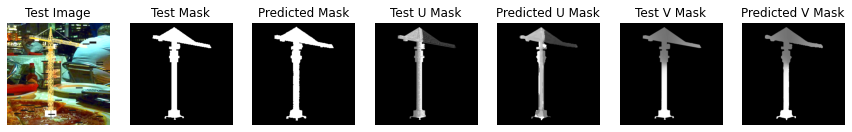

===> Epoch[124/200](0/500): Loss_Mask: 0.0134	Loss_U_Mask: 0.5047	Loss_V_Mask: 0.2066
===> Epoch[124/200](100/500): Loss_Mask: 0.0136	Loss_U_Mask: 0.4968	Loss_V_Mask: 0.2124
===> Epoch[124/200](200/500): Loss_Mask: 0.0125	Loss_U_Mask: 0.3662	Loss_V_Mask: 0.1946
===> Epoch[124/200](300/500): Loss_Mask: 0.0088	Loss_U_Mask: 0.4680	Loss_V_Mask: 0.1925
===> Epoch[124/200](400/500): Loss_Mask: 0.0105	Loss_U_Mask: 0.5475	Loss_V_Mask: 0.2303
===> Epoch[124/200](500/500): Loss_Mask: 0.0098	Loss_U_Mask: 0.5280	Loss_V_Mask: 0.2061
Val_Loss_Mask: 0.0322	Val_U_Loss_Mask: 0.4089	Val_V_Loss_Mask: 0.1785


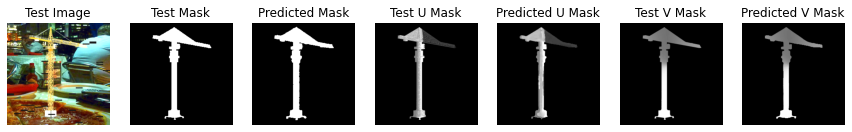

===> Epoch[125/200](0/500): Loss_Mask: 0.0140	Loss_U_Mask: 0.5058	Loss_V_Mask: 0.1976
===> Epoch[125/200](100/500): Loss_Mask: 0.0114	Loss_U_Mask: 0.4974	Loss_V_Mask: 0.2133
===> Epoch[125/200](200/500): Loss_Mask: 0.0099	Loss_U_Mask: 0.4333	Loss_V_Mask: 0.2121
===> Epoch[125/200](300/500): Loss_Mask: 0.0168	Loss_U_Mask: 0.4776	Loss_V_Mask: 0.2220
===> Epoch[125/200](400/500): Loss_Mask: 0.0093	Loss_U_Mask: 0.4718	Loss_V_Mask: 0.1858
===> Epoch[125/200](500/500): Loss_Mask: 0.0088	Loss_U_Mask: 0.4250	Loss_V_Mask: 0.1892
Val_Loss_Mask: 0.0281	Val_U_Loss_Mask: 0.4135	Val_V_Loss_Mask: 0.1796


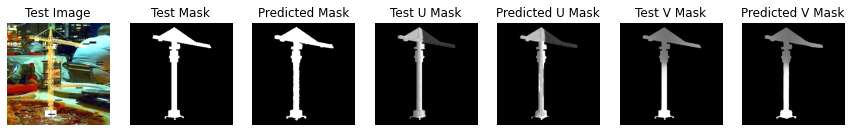

===> Epoch[126/200](0/500): Loss_Mask: 0.0111	Loss_U_Mask: 0.4575	Loss_V_Mask: 0.1898
===> Epoch[126/200](100/500): Loss_Mask: 0.0108	Loss_U_Mask: 0.4124	Loss_V_Mask: 0.2019
===> Epoch[126/200](200/500): Loss_Mask: 0.0101	Loss_U_Mask: 0.4274	Loss_V_Mask: 0.2084
===> Epoch[126/200](300/500): Loss_Mask: 0.0143	Loss_U_Mask: 0.5403	Loss_V_Mask: 0.2127
===> Epoch[126/200](400/500): Loss_Mask: 0.0147	Loss_U_Mask: 0.4464	Loss_V_Mask: 0.1925
===> Epoch[126/200](500/500): Loss_Mask: 0.0117	Loss_U_Mask: 0.5344	Loss_V_Mask: 0.2044
Val_Loss_Mask: 0.0269	Val_U_Loss_Mask: 0.4179	Val_V_Loss_Mask: 0.1800


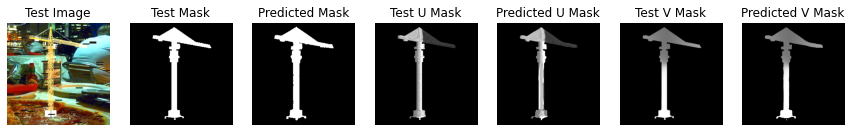

===> Epoch[127/200](0/500): Loss_Mask: 0.0143	Loss_U_Mask: 0.4303	Loss_V_Mask: 0.2126
===> Epoch[127/200](100/500): Loss_Mask: 0.0120	Loss_U_Mask: 0.4253	Loss_V_Mask: 0.2099
===> Epoch[127/200](200/500): Loss_Mask: 0.0178	Loss_U_Mask: 0.5553	Loss_V_Mask: 0.2207
===> Epoch[127/200](300/500): Loss_Mask: 0.0101	Loss_U_Mask: 0.4681	Loss_V_Mask: 0.1977
===> Epoch[127/200](400/500): Loss_Mask: 0.0118	Loss_U_Mask: 0.4792	Loss_V_Mask: 0.2181
===> Epoch[127/200](500/500): Loss_Mask: 0.0106	Loss_U_Mask: 0.4837	Loss_V_Mask: 0.1949
Val_Loss_Mask: 0.0309	Val_U_Loss_Mask: 0.4160	Val_V_Loss_Mask: 0.1843


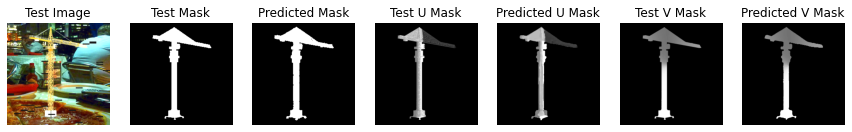

===> Epoch[128/200](0/500): Loss_Mask: 0.0234	Loss_U_Mask: 0.4207	Loss_V_Mask: 0.2649
===> Epoch[128/200](100/500): Loss_Mask: 0.0102	Loss_U_Mask: 0.4491	Loss_V_Mask: 0.1915
===> Epoch[128/200](200/500): Loss_Mask: 0.0094	Loss_U_Mask: 0.4719	Loss_V_Mask: 0.1868
===> Epoch[128/200](300/500): Loss_Mask: 0.0114	Loss_U_Mask: 0.4854	Loss_V_Mask: 0.2334
===> Epoch[128/200](400/500): Loss_Mask: 0.0130	Loss_U_Mask: 0.4774	Loss_V_Mask: 0.2262
===> Epoch[128/200](500/500): Loss_Mask: 0.0079	Loss_U_Mask: 0.3978	Loss_V_Mask: 0.1918
Val_Loss_Mask: 0.0234	Val_U_Loss_Mask: 0.4053	Val_V_Loss_Mask: 0.1770


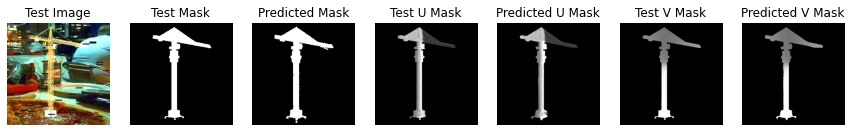

===> Epoch[129/200](0/500): Loss_Mask: 0.0126	Loss_U_Mask: 0.4763	Loss_V_Mask: 0.2081
===> Epoch[129/200](100/500): Loss_Mask: 0.0094	Loss_U_Mask: 0.4369	Loss_V_Mask: 0.1992
===> Epoch[129/200](200/500): Loss_Mask: 0.0119	Loss_U_Mask: 0.3960	Loss_V_Mask: 0.1970
===> Epoch[129/200](300/500): Loss_Mask: 0.0108	Loss_U_Mask: 0.4189	Loss_V_Mask: 0.1894
===> Epoch[129/200](400/500): Loss_Mask: 0.0398	Loss_U_Mask: 0.5194	Loss_V_Mask: 0.2626
===> Epoch[129/200](500/500): Loss_Mask: 0.0142	Loss_U_Mask: 0.5067	Loss_V_Mask: 0.2233
Val_Loss_Mask: 0.0250	Val_U_Loss_Mask: 0.4167	Val_V_Loss_Mask: 0.1852


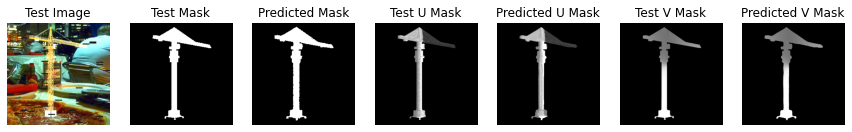

===> Epoch[130/200](0/500): Loss_Mask: 0.0118	Loss_U_Mask: 0.4753	Loss_V_Mask: 0.1937
===> Epoch[130/200](100/500): Loss_Mask: 0.0169	Loss_U_Mask: 0.4315	Loss_V_Mask: 0.2328
===> Epoch[130/200](200/500): Loss_Mask: 0.0135	Loss_U_Mask: 0.4248	Loss_V_Mask: 0.2086
===> Epoch[130/200](300/500): Loss_Mask: 0.0096	Loss_U_Mask: 0.4730	Loss_V_Mask: 0.1935
===> Epoch[130/200](400/500): Loss_Mask: 0.0092	Loss_U_Mask: 0.4332	Loss_V_Mask: 0.1969
===> Epoch[130/200](500/500): Loss_Mask: 0.0121	Loss_U_Mask: 0.4564	Loss_V_Mask: 0.2044
Val_Loss_Mask: 0.0242	Val_U_Loss_Mask: 0.4124	Val_V_Loss_Mask: 0.1769


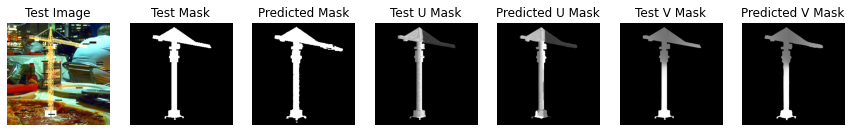

===> Epoch[131/200](0/500): Loss_Mask: 0.0192	Loss_U_Mask: 0.4410	Loss_V_Mask: 0.2207
===> Epoch[131/200](100/500): Loss_Mask: 0.0138	Loss_U_Mask: 0.5477	Loss_V_Mask: 0.2313
===> Epoch[131/200](200/500): Loss_Mask: 0.0110	Loss_U_Mask: 0.4898	Loss_V_Mask: 0.2149
===> Epoch[131/200](300/500): Loss_Mask: 0.0135	Loss_U_Mask: 0.5192	Loss_V_Mask: 0.2273
===> Epoch[131/200](400/500): Loss_Mask: 0.0129	Loss_U_Mask: 0.4245	Loss_V_Mask: 0.2095
===> Epoch[131/200](500/500): Loss_Mask: 0.0134	Loss_U_Mask: 0.3902	Loss_V_Mask: 0.2016
Val_Loss_Mask: 0.0279	Val_U_Loss_Mask: 0.4086	Val_V_Loss_Mask: 0.1819


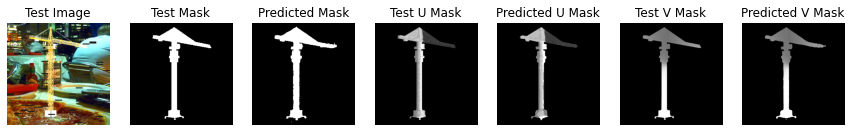

===> Epoch[132/200](0/500): Loss_Mask: 0.0131	Loss_U_Mask: 0.4613	Loss_V_Mask: 0.2005
===> Epoch[132/200](100/500): Loss_Mask: 0.0108	Loss_U_Mask: 0.3249	Loss_V_Mask: 0.1982
===> Epoch[132/200](200/500): Loss_Mask: 0.0100	Loss_U_Mask: 0.5191	Loss_V_Mask: 0.2054
===> Epoch[132/200](300/500): Loss_Mask: 0.0107	Loss_U_Mask: 0.5262	Loss_V_Mask: 0.2234
===> Epoch[132/200](400/500): Loss_Mask: 0.0099	Loss_U_Mask: 0.4370	Loss_V_Mask: 0.1999
===> Epoch[132/200](500/500): Loss_Mask: 0.0117	Loss_U_Mask: 0.3494	Loss_V_Mask: 0.1848
Val_Loss_Mask: 0.0264	Val_U_Loss_Mask: 0.4142	Val_V_Loss_Mask: 0.1783


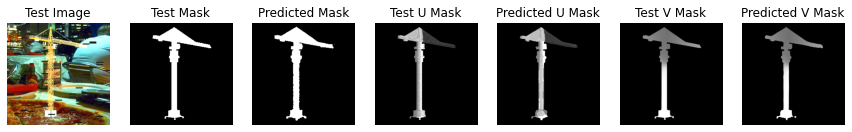

===> Epoch[133/200](0/500): Loss_Mask: 0.0110	Loss_U_Mask: 0.3792	Loss_V_Mask: 0.1777
===> Epoch[133/200](100/500): Loss_Mask: 0.0095	Loss_U_Mask: 0.4738	Loss_V_Mask: 0.1909
===> Epoch[133/200](200/500): Loss_Mask: 0.0111	Loss_U_Mask: 0.3790	Loss_V_Mask: 0.1930
===> Epoch[133/200](300/500): Loss_Mask: 0.0135	Loss_U_Mask: 0.4826	Loss_V_Mask: 0.2113
===> Epoch[133/200](400/500): Loss_Mask: 0.0116	Loss_U_Mask: 0.4530	Loss_V_Mask: 0.2027
===> Epoch[133/200](500/500): Loss_Mask: 0.0121	Loss_U_Mask: 0.4643	Loss_V_Mask: 0.1959
Val_Loss_Mask: 0.0271	Val_U_Loss_Mask: 0.4081	Val_V_Loss_Mask: 0.1734


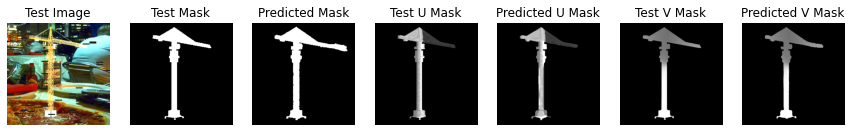

===> Epoch[134/200](0/500): Loss_Mask: 0.0128	Loss_U_Mask: 0.4749	Loss_V_Mask: 0.1962
===> Epoch[134/200](100/500): Loss_Mask: 0.0140	Loss_U_Mask: 0.4749	Loss_V_Mask: 0.2161
===> Epoch[134/200](200/500): Loss_Mask: 0.0081	Loss_U_Mask: 0.5109	Loss_V_Mask: 0.1956
===> Epoch[134/200](300/500): Loss_Mask: 0.0156	Loss_U_Mask: 0.4608	Loss_V_Mask: 0.2207
===> Epoch[134/200](400/500): Loss_Mask: 0.0085	Loss_U_Mask: 0.4177	Loss_V_Mask: 0.1847
===> Epoch[134/200](500/500): Loss_Mask: 0.0164	Loss_U_Mask: 0.5236	Loss_V_Mask: 0.2386
Val_Loss_Mask: 0.0323	Val_U_Loss_Mask: 0.4156	Val_V_Loss_Mask: 0.1897


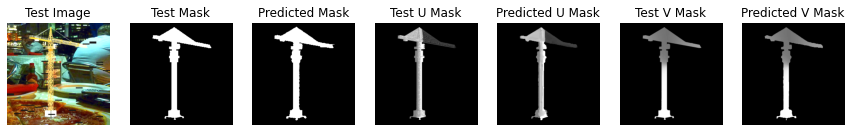

===> Epoch[135/200](0/500): Loss_Mask: 0.0142	Loss_U_Mask: 0.4114	Loss_V_Mask: 0.1930
===> Epoch[135/200](100/500): Loss_Mask: 0.0094	Loss_U_Mask: 0.3459	Loss_V_Mask: 0.1810
===> Epoch[135/200](200/500): Loss_Mask: 0.0116	Loss_U_Mask: 0.5348	Loss_V_Mask: 0.2168
===> Epoch[135/200](300/500): Loss_Mask: 0.0087	Loss_U_Mask: 0.4718	Loss_V_Mask: 0.1980
===> Epoch[135/200](400/500): Loss_Mask: 0.0103	Loss_U_Mask: 0.3685	Loss_V_Mask: 0.1763
===> Epoch[135/200](500/500): Loss_Mask: 0.0182	Loss_U_Mask: 0.4563	Loss_V_Mask: 0.2082
Val_Loss_Mask: 0.0303	Val_U_Loss_Mask: 0.4172	Val_V_Loss_Mask: 0.1802


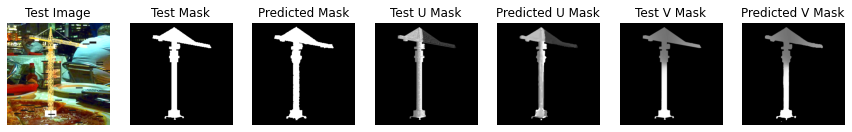

===> Epoch[136/200](0/500): Loss_Mask: 0.0129	Loss_U_Mask: 0.4899	Loss_V_Mask: 0.1959
===> Epoch[136/200](100/500): Loss_Mask: 0.0108	Loss_U_Mask: 0.3995	Loss_V_Mask: 0.1932
===> Epoch[136/200](200/500): Loss_Mask: 0.0122	Loss_U_Mask: 0.4446	Loss_V_Mask: 0.1953
===> Epoch[136/200](300/500): Loss_Mask: 0.0122	Loss_U_Mask: 0.5011	Loss_V_Mask: 0.2215
===> Epoch[136/200](400/500): Loss_Mask: 0.0086	Loss_U_Mask: 0.4474	Loss_V_Mask: 0.1831
===> Epoch[136/200](500/500): Loss_Mask: 0.0099	Loss_U_Mask: 0.4343	Loss_V_Mask: 0.2054
Val_Loss_Mask: 0.0271	Val_U_Loss_Mask: 0.4119	Val_V_Loss_Mask: 0.1747


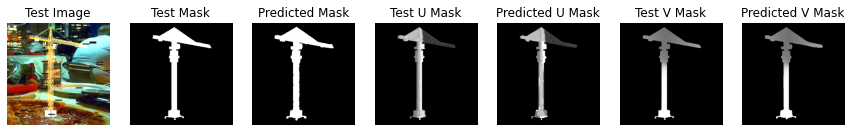

===> Epoch[137/200](0/500): Loss_Mask: 0.0131	Loss_U_Mask: 0.5021	Loss_V_Mask: 0.1993
===> Epoch[137/200](100/500): Loss_Mask: 0.0120	Loss_U_Mask: 0.4287	Loss_V_Mask: 0.2185
===> Epoch[137/200](200/500): Loss_Mask: 0.0093	Loss_U_Mask: 0.4870	Loss_V_Mask: 0.1906
===> Epoch[137/200](300/500): Loss_Mask: 0.0094	Loss_U_Mask: 0.5285	Loss_V_Mask: 0.2240
===> Epoch[137/200](400/500): Loss_Mask: 0.0087	Loss_U_Mask: 0.4530	Loss_V_Mask: 0.1863
===> Epoch[137/200](500/500): Loss_Mask: 0.0088	Loss_U_Mask: 0.4112	Loss_V_Mask: 0.1890
Val_Loss_Mask: 0.0256	Val_U_Loss_Mask: 0.4128	Val_V_Loss_Mask: 0.1818


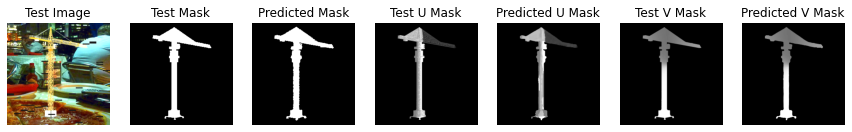

===> Epoch[138/200](0/500): Loss_Mask: 0.0161	Loss_U_Mask: 0.5448	Loss_V_Mask: 0.1938
===> Epoch[138/200](100/500): Loss_Mask: 0.0118	Loss_U_Mask: 0.5362	Loss_V_Mask: 0.2052
===> Epoch[138/200](200/500): Loss_Mask: 0.0111	Loss_U_Mask: 0.4159	Loss_V_Mask: 0.1972
===> Epoch[138/200](300/500): Loss_Mask: 0.0137	Loss_U_Mask: 0.5043	Loss_V_Mask: 0.2096
===> Epoch[138/200](400/500): Loss_Mask: 0.0095	Loss_U_Mask: 0.4451	Loss_V_Mask: 0.1884
===> Epoch[138/200](500/500): Loss_Mask: 0.0117	Loss_U_Mask: 0.5025	Loss_V_Mask: 0.2082
Val_Loss_Mask: 0.0333	Val_U_Loss_Mask: 0.4202	Val_V_Loss_Mask: 0.1885


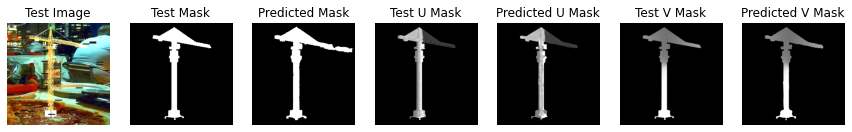

===> Epoch[139/200](0/500): Loss_Mask: 0.0200	Loss_U_Mask: 0.4768	Loss_V_Mask: 0.2317
===> Epoch[139/200](100/500): Loss_Mask: 0.0139	Loss_U_Mask: 0.5135	Loss_V_Mask: 0.2379
===> Epoch[139/200](200/500): Loss_Mask: 0.0088	Loss_U_Mask: 0.4123	Loss_V_Mask: 0.1804
===> Epoch[139/200](300/500): Loss_Mask: 0.0101	Loss_U_Mask: 0.4286	Loss_V_Mask: 0.1923
===> Epoch[139/200](400/500): Loss_Mask: 0.0123	Loss_U_Mask: 0.4959	Loss_V_Mask: 0.1972
===> Epoch[139/200](500/500): Loss_Mask: 0.0091	Loss_U_Mask: 0.4620	Loss_V_Mask: 0.2069
Val_Loss_Mask: 0.0288	Val_U_Loss_Mask: 0.4141	Val_V_Loss_Mask: 0.1848


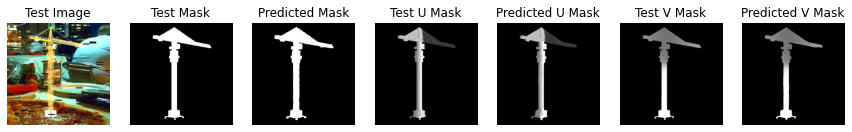

===> Epoch[140/200](0/500): Loss_Mask: 0.0140	Loss_U_Mask: 0.4275	Loss_V_Mask: 0.2069
===> Epoch[140/200](100/500): Loss_Mask: 0.0131	Loss_U_Mask: 0.5302	Loss_V_Mask: 0.2135
===> Epoch[140/200](200/500): Loss_Mask: 0.0091	Loss_U_Mask: 0.4172	Loss_V_Mask: 0.1899
===> Epoch[140/200](300/500): Loss_Mask: 0.0092	Loss_U_Mask: 0.4354	Loss_V_Mask: 0.1836
===> Epoch[140/200](400/500): Loss_Mask: 0.0114	Loss_U_Mask: 0.5052	Loss_V_Mask: 0.2124
===> Epoch[140/200](500/500): Loss_Mask: 0.0136	Loss_U_Mask: 0.5194	Loss_V_Mask: 0.2209
Val_Loss_Mask: 0.0266	Val_U_Loss_Mask: 0.4167	Val_V_Loss_Mask: 0.1798


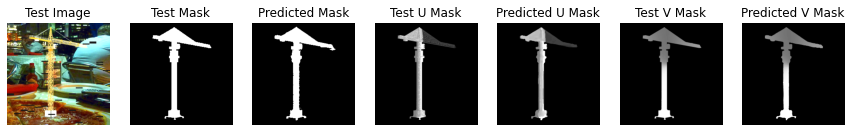

===> Epoch[141/200](0/500): Loss_Mask: 0.0156	Loss_U_Mask: 0.5528	Loss_V_Mask: 0.2127
===> Epoch[141/200](100/500): Loss_Mask: 0.0180	Loss_U_Mask: 0.4197	Loss_V_Mask: 0.2108
===> Epoch[141/200](200/500): Loss_Mask: 0.0130	Loss_U_Mask: 0.5481	Loss_V_Mask: 0.2130
===> Epoch[141/200](300/500): Loss_Mask: 0.0134	Loss_U_Mask: 0.4563	Loss_V_Mask: 0.2057
===> Epoch[141/200](400/500): Loss_Mask: 0.0098	Loss_U_Mask: 0.3358	Loss_V_Mask: 0.1911
===> Epoch[141/200](500/500): Loss_Mask: 0.0077	Loss_U_Mask: 0.3984	Loss_V_Mask: 0.1873
Val_Loss_Mask: 0.0229	Val_U_Loss_Mask: 0.4041	Val_V_Loss_Mask: 0.1751


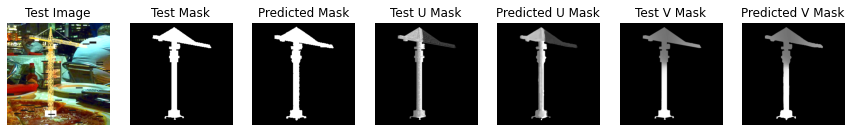

===> Epoch[142/200](0/500): Loss_Mask: 0.0163	Loss_U_Mask: 0.5511	Loss_V_Mask: 0.2087
===> Epoch[142/200](100/500): Loss_Mask: 0.0099	Loss_U_Mask: 0.4316	Loss_V_Mask: 0.1988
===> Epoch[142/200](200/500): Loss_Mask: 0.0112	Loss_U_Mask: 0.4929	Loss_V_Mask: 0.2004
===> Epoch[142/200](300/500): Loss_Mask: 0.0193	Loss_U_Mask: 0.4989	Loss_V_Mask: 0.2075
===> Epoch[142/200](400/500): Loss_Mask: 0.0118	Loss_U_Mask: 0.4157	Loss_V_Mask: 0.2053
===> Epoch[142/200](500/500): Loss_Mask: 0.0113	Loss_U_Mask: 0.4680	Loss_V_Mask: 0.2005
Val_Loss_Mask: 0.0254	Val_U_Loss_Mask: 0.4096	Val_V_Loss_Mask: 0.1806


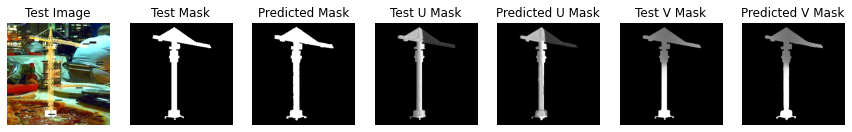

===> Epoch[143/200](0/500): Loss_Mask: 0.0159	Loss_U_Mask: 0.5135	Loss_V_Mask: 0.2329
===> Epoch[143/200](100/500): Loss_Mask: 0.0125	Loss_U_Mask: 0.4490	Loss_V_Mask: 0.1965
===> Epoch[143/200](200/500): Loss_Mask: 0.0112	Loss_U_Mask: 0.4705	Loss_V_Mask: 0.1860
===> Epoch[143/200](300/500): Loss_Mask: 0.0097	Loss_U_Mask: 0.4049	Loss_V_Mask: 0.2084
===> Epoch[143/200](400/500): Loss_Mask: 0.0091	Loss_U_Mask: 0.4601	Loss_V_Mask: 0.1927
===> Epoch[143/200](500/500): Loss_Mask: 0.0102	Loss_U_Mask: 0.4769	Loss_V_Mask: 0.2072
Val_Loss_Mask: 0.0254	Val_U_Loss_Mask: 0.4118	Val_V_Loss_Mask: 0.1810


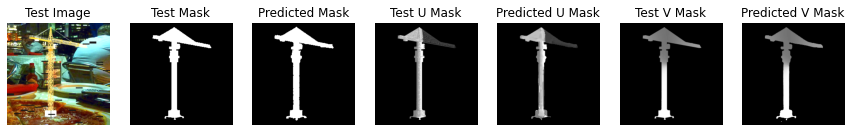

===> Epoch[144/200](0/500): Loss_Mask: 0.0165	Loss_U_Mask: 0.4689	Loss_V_Mask: 0.2163
===> Epoch[144/200](100/500): Loss_Mask: 0.0096	Loss_U_Mask: 0.4365	Loss_V_Mask: 0.1914
===> Epoch[144/200](200/500): Loss_Mask: 0.0151	Loss_U_Mask: 0.4508	Loss_V_Mask: 0.2091
===> Epoch[144/200](300/500): Loss_Mask: 0.0197	Loss_U_Mask: 0.4350	Loss_V_Mask: 0.2138
===> Epoch[144/200](400/500): Loss_Mask: 0.0101	Loss_U_Mask: 0.4621	Loss_V_Mask: 0.1889
===> Epoch[144/200](500/500): Loss_Mask: 0.0102	Loss_U_Mask: 0.4367	Loss_V_Mask: 0.2048
Val_Loss_Mask: 0.0309	Val_U_Loss_Mask: 0.4249	Val_V_Loss_Mask: 0.1822


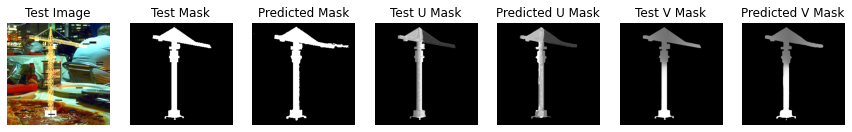

===> Epoch[145/200](0/500): Loss_Mask: 0.0166	Loss_U_Mask: 0.6023	Loss_V_Mask: 0.2148
===> Epoch[145/200](100/500): Loss_Mask: 0.0181	Loss_U_Mask: 0.5034	Loss_V_Mask: 0.2263
===> Epoch[145/200](200/500): Loss_Mask: 0.0097	Loss_U_Mask: 0.4758	Loss_V_Mask: 0.2044
===> Epoch[145/200](300/500): Loss_Mask: 0.0127	Loss_U_Mask: 0.4638	Loss_V_Mask: 0.2140
===> Epoch[145/200](400/500): Loss_Mask: 0.0225	Loss_U_Mask: 0.4903	Loss_V_Mask: 0.2398
===> Epoch[145/200](500/500): Loss_Mask: 0.0101	Loss_U_Mask: 0.3805	Loss_V_Mask: 0.1993
Val_Loss_Mask: 0.0285	Val_U_Loss_Mask: 0.4139	Val_V_Loss_Mask: 0.1790


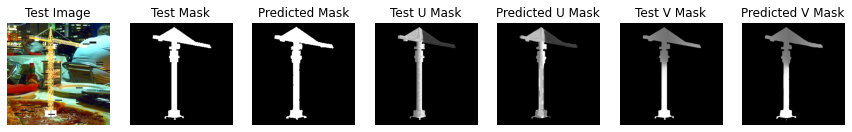

===> Epoch[146/200](0/500): Loss_Mask: 0.0182	Loss_U_Mask: 0.5263	Loss_V_Mask: 0.2040
===> Epoch[146/200](100/500): Loss_Mask: 0.0105	Loss_U_Mask: 0.4814	Loss_V_Mask: 0.1941
===> Epoch[146/200](200/500): Loss_Mask: 0.0090	Loss_U_Mask: 0.4266	Loss_V_Mask: 0.1970
===> Epoch[146/200](300/500): Loss_Mask: 0.0088	Loss_U_Mask: 0.4866	Loss_V_Mask: 0.1954
===> Epoch[146/200](400/500): Loss_Mask: 0.0124	Loss_U_Mask: 0.4822	Loss_V_Mask: 0.2211
===> Epoch[146/200](500/500): Loss_Mask: 0.0136	Loss_U_Mask: 0.4474	Loss_V_Mask: 0.2133
Val_Loss_Mask: 0.0285	Val_U_Loss_Mask: 0.4107	Val_V_Loss_Mask: 0.1816


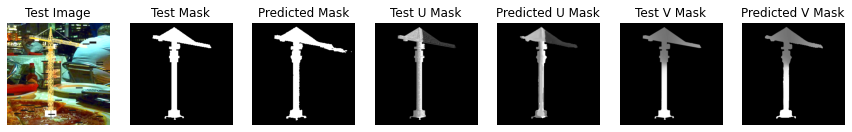

===> Epoch[147/200](0/500): Loss_Mask: 0.0110	Loss_U_Mask: 0.4481	Loss_V_Mask: 0.1785
===> Epoch[147/200](100/500): Loss_Mask: 0.0113	Loss_U_Mask: 0.5260	Loss_V_Mask: 0.2108
===> Epoch[147/200](200/500): Loss_Mask: 0.0123	Loss_U_Mask: 0.3411	Loss_V_Mask: 0.1977
===> Epoch[147/200](300/500): Loss_Mask: 0.0134	Loss_U_Mask: 0.5103	Loss_V_Mask: 0.2269
===> Epoch[147/200](400/500): Loss_Mask: 0.0118	Loss_U_Mask: 0.4932	Loss_V_Mask: 0.2226
===> Epoch[147/200](500/500): Loss_Mask: 0.0100	Loss_U_Mask: 0.4880	Loss_V_Mask: 0.2049
Val_Loss_Mask: 0.0277	Val_U_Loss_Mask: 0.4169	Val_V_Loss_Mask: 0.1824


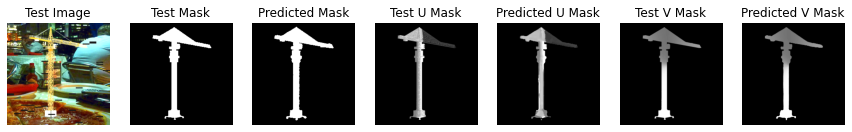

===> Epoch[148/200](0/500): Loss_Mask: 0.0220	Loss_U_Mask: 0.5657	Loss_V_Mask: 0.2313
===> Epoch[148/200](100/500): Loss_Mask: 0.0180	Loss_U_Mask: 0.5404	Loss_V_Mask: 0.2226
===> Epoch[148/200](200/500): Loss_Mask: 0.0107	Loss_U_Mask: 0.3423	Loss_V_Mask: 0.1844
===> Epoch[148/200](300/500): Loss_Mask: 0.0105	Loss_U_Mask: 0.4817	Loss_V_Mask: 0.2103
===> Epoch[148/200](400/500): Loss_Mask: 0.0137	Loss_U_Mask: 0.5273	Loss_V_Mask: 0.2135
===> Epoch[148/200](500/500): Loss_Mask: 0.0175	Loss_U_Mask: 0.4651	Loss_V_Mask: 0.2007
Val_Loss_Mask: 0.0280	Val_U_Loss_Mask: 0.4068	Val_V_Loss_Mask: 0.1785


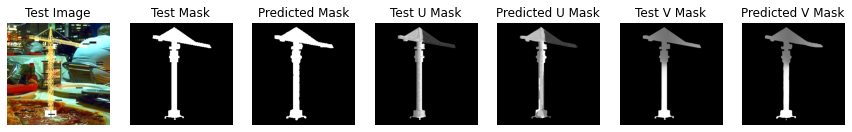

===> Epoch[149/200](0/500): Loss_Mask: 0.0266	Loss_U_Mask: 0.4776	Loss_V_Mask: 0.2469
===> Epoch[149/200](100/500): Loss_Mask: 0.0106	Loss_U_Mask: 0.4671	Loss_V_Mask: 0.2000
===> Epoch[149/200](200/500): Loss_Mask: 0.0122	Loss_U_Mask: 0.4754	Loss_V_Mask: 0.2029
===> Epoch[149/200](300/500): Loss_Mask: 0.0121	Loss_U_Mask: 0.5280	Loss_V_Mask: 0.2121
===> Epoch[149/200](400/500): Loss_Mask: 0.0130	Loss_U_Mask: 0.5279	Loss_V_Mask: 0.2029
===> Epoch[149/200](500/500): Loss_Mask: 0.0131	Loss_U_Mask: 0.4045	Loss_V_Mask: 0.2011
Val_Loss_Mask: 0.0264	Val_U_Loss_Mask: 0.4079	Val_V_Loss_Mask: 0.1788


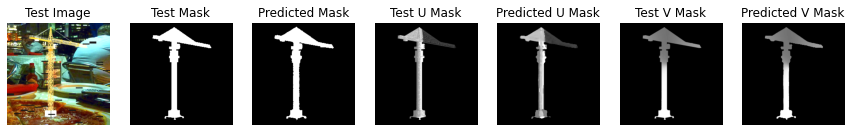

===> Epoch[150/200](0/500): Loss_Mask: 0.0184	Loss_U_Mask: 0.4873	Loss_V_Mask: 0.2122
===> Epoch[150/200](100/500): Loss_Mask: 0.0094	Loss_U_Mask: 0.4395	Loss_V_Mask: 0.1974
===> Epoch[150/200](200/500): Loss_Mask: 0.0184	Loss_U_Mask: 0.5374	Loss_V_Mask: 0.2342
===> Epoch[150/200](300/500): Loss_Mask: 0.0178	Loss_U_Mask: 0.5504	Loss_V_Mask: 0.2134
===> Epoch[150/200](400/500): Loss_Mask: 0.0135	Loss_U_Mask: 0.4476	Loss_V_Mask: 0.2333
===> Epoch[150/200](500/500): Loss_Mask: 0.0089	Loss_U_Mask: 0.4221	Loss_V_Mask: 0.1921
Val_Loss_Mask: 0.0276	Val_U_Loss_Mask: 0.4146	Val_V_Loss_Mask: 0.1804


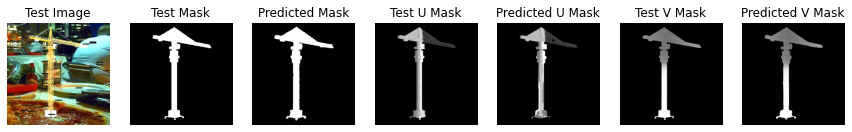

===> Epoch[151/200](0/500): Loss_Mask: 0.0171	Loss_U_Mask: 0.4505	Loss_V_Mask: 0.2074
===> Epoch[151/200](100/500): Loss_Mask: 0.0105	Loss_U_Mask: 0.5410	Loss_V_Mask: 0.2046
===> Epoch[151/200](200/500): Loss_Mask: 0.0084	Loss_U_Mask: 0.4340	Loss_V_Mask: 0.1947
===> Epoch[151/200](300/500): Loss_Mask: 0.0107	Loss_U_Mask: 0.4660	Loss_V_Mask: 0.1952
===> Epoch[151/200](400/500): Loss_Mask: 0.0105	Loss_U_Mask: 0.4133	Loss_V_Mask: 0.2001
===> Epoch[151/200](500/500): Loss_Mask: 0.0103	Loss_U_Mask: 0.3865	Loss_V_Mask: 0.1902
Val_Loss_Mask: 0.0249	Val_U_Loss_Mask: 0.4131	Val_V_Loss_Mask: 0.1774


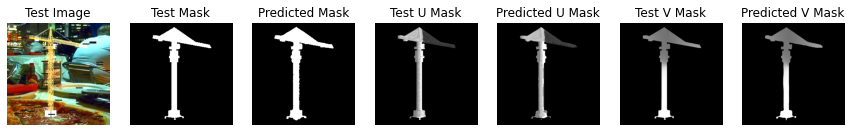

===> Epoch[152/200](0/500): Loss_Mask: 0.0164	Loss_U_Mask: 0.5468	Loss_V_Mask: 0.2097
===> Epoch[152/200](100/500): Loss_Mask: 0.0126	Loss_U_Mask: 0.4380	Loss_V_Mask: 0.2112
===> Epoch[152/200](200/500): Loss_Mask: 0.0141	Loss_U_Mask: 0.4942	Loss_V_Mask: 0.2206
===> Epoch[152/200](300/500): Loss_Mask: 0.0100	Loss_U_Mask: 0.4356	Loss_V_Mask: 0.2040
===> Epoch[152/200](400/500): Loss_Mask: 0.0104	Loss_U_Mask: 0.4782	Loss_V_Mask: 0.2005
===> Epoch[152/200](500/500): Loss_Mask: 0.0132	Loss_U_Mask: 0.4784	Loss_V_Mask: 0.2151
Val_Loss_Mask: 0.0282	Val_U_Loss_Mask: 0.4095	Val_V_Loss_Mask: 0.1790


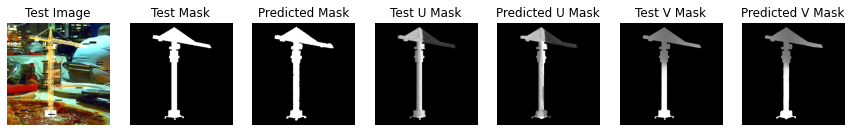

===> Epoch[153/200](0/500): Loss_Mask: 0.0184	Loss_U_Mask: 0.4414	Loss_V_Mask: 0.2082
===> Epoch[153/200](100/500): Loss_Mask: 0.0110	Loss_U_Mask: 0.3538	Loss_V_Mask: 0.1862
===> Epoch[153/200](200/500): Loss_Mask: 0.0096	Loss_U_Mask: 0.4430	Loss_V_Mask: 0.1790
===> Epoch[153/200](300/500): Loss_Mask: 0.0107	Loss_U_Mask: 0.4973	Loss_V_Mask: 0.2126
===> Epoch[153/200](400/500): Loss_Mask: 0.0090	Loss_U_Mask: 0.3956	Loss_V_Mask: 0.1910
===> Epoch[153/200](500/500): Loss_Mask: 0.0132	Loss_U_Mask: 0.4725	Loss_V_Mask: 0.2156
Val_Loss_Mask: 0.0272	Val_U_Loss_Mask: 0.4128	Val_V_Loss_Mask: 0.1807


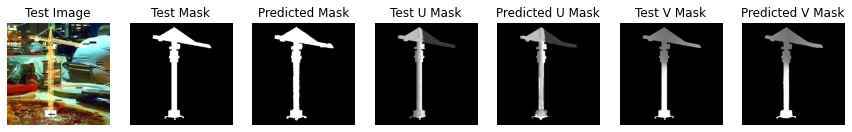

===> Epoch[154/200](0/500): Loss_Mask: 0.0128	Loss_U_Mask: 0.4950	Loss_V_Mask: 0.2032
===> Epoch[154/200](100/500): Loss_Mask: 0.0120	Loss_U_Mask: 0.4866	Loss_V_Mask: 0.2060
===> Epoch[154/200](200/500): Loss_Mask: 0.0125	Loss_U_Mask: 0.4479	Loss_V_Mask: 0.2154
===> Epoch[154/200](300/500): Loss_Mask: 0.0092	Loss_U_Mask: 0.4165	Loss_V_Mask: 0.1984
===> Epoch[154/200](400/500): Loss_Mask: 0.0103	Loss_U_Mask: 0.3896	Loss_V_Mask: 0.1974
===> Epoch[154/200](500/500): Loss_Mask: 0.0135	Loss_U_Mask: 0.4808	Loss_V_Mask: 0.2099
Val_Loss_Mask: 0.0323	Val_U_Loss_Mask: 0.4132	Val_V_Loss_Mask: 0.1810


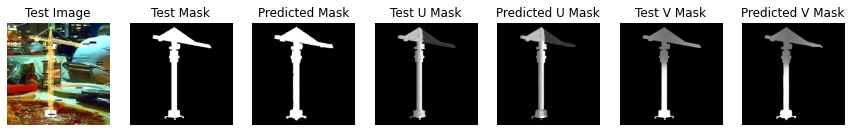

===> Epoch[155/200](0/500): Loss_Mask: 0.0176	Loss_U_Mask: 0.4177	Loss_V_Mask: 0.2243
===> Epoch[155/200](100/500): Loss_Mask: 0.0097	Loss_U_Mask: 0.4562	Loss_V_Mask: 0.2008
===> Epoch[155/200](200/500): Loss_Mask: 0.0152	Loss_U_Mask: 0.5552	Loss_V_Mask: 0.2388
===> Epoch[155/200](300/500): Loss_Mask: 0.0126	Loss_U_Mask: 0.4975	Loss_V_Mask: 0.2113
===> Epoch[155/200](400/500): Loss_Mask: 0.0103	Loss_U_Mask: 0.4483	Loss_V_Mask: 0.1970
===> Epoch[155/200](500/500): Loss_Mask: 0.0079	Loss_U_Mask: 0.4286	Loss_V_Mask: 0.1796
Val_Loss_Mask: 0.0269	Val_U_Loss_Mask: 0.4204	Val_V_Loss_Mask: 0.1809


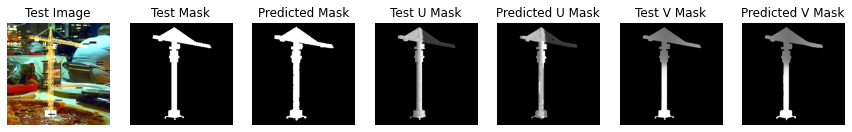

===> Epoch[156/200](0/500): Loss_Mask: 0.0160	Loss_U_Mask: 0.5296	Loss_V_Mask: 0.1947
===> Epoch[156/200](100/500): Loss_Mask: 0.0136	Loss_U_Mask: 0.4969	Loss_V_Mask: 0.1998
===> Epoch[156/200](200/500): Loss_Mask: 0.0098	Loss_U_Mask: 0.5152	Loss_V_Mask: 0.2104
===> Epoch[156/200](300/500): Loss_Mask: 0.0112	Loss_U_Mask: 0.4350	Loss_V_Mask: 0.1995
===> Epoch[156/200](400/500): Loss_Mask: 0.0198	Loss_U_Mask: 0.5031	Loss_V_Mask: 0.2468
===> Epoch[156/200](500/500): Loss_Mask: 0.0099	Loss_U_Mask: 0.4219	Loss_V_Mask: 0.2015
Val_Loss_Mask: 0.0279	Val_U_Loss_Mask: 0.4115	Val_V_Loss_Mask: 0.1830


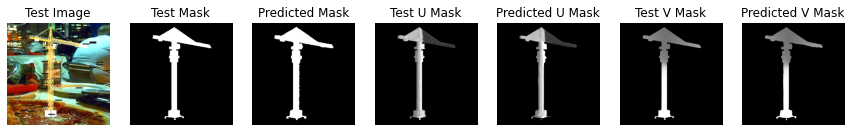

===> Epoch[157/200](0/500): Loss_Mask: 0.0140	Loss_U_Mask: 0.4689	Loss_V_Mask: 0.2191
===> Epoch[157/200](100/500): Loss_Mask: 0.0123	Loss_U_Mask: 0.4841	Loss_V_Mask: 0.1935
===> Epoch[157/200](200/500): Loss_Mask: 0.0109	Loss_U_Mask: 0.4217	Loss_V_Mask: 0.1946
===> Epoch[157/200](300/500): Loss_Mask: 0.0104	Loss_U_Mask: 0.4374	Loss_V_Mask: 0.2070
===> Epoch[157/200](400/500): Loss_Mask: 0.0108	Loss_U_Mask: 0.4968	Loss_V_Mask: 0.2073
===> Epoch[157/200](500/500): Loss_Mask: 0.0126	Loss_U_Mask: 0.4835	Loss_V_Mask: 0.2218
Val_Loss_Mask: 0.0276	Val_U_Loss_Mask: 0.4115	Val_V_Loss_Mask: 0.1845


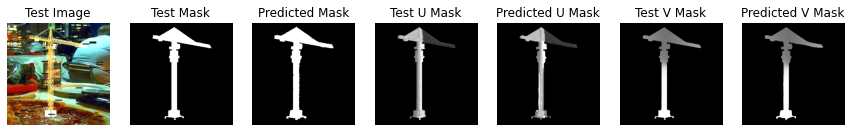

===> Epoch[158/200](0/500): Loss_Mask: 0.0231	Loss_U_Mask: 0.5142	Loss_V_Mask: 0.2130
===> Epoch[158/200](100/500): Loss_Mask: 0.0100	Loss_U_Mask: 0.3876	Loss_V_Mask: 0.1846
===> Epoch[158/200](200/500): Loss_Mask: 0.0115	Loss_U_Mask: 0.4620	Loss_V_Mask: 0.2104
===> Epoch[158/200](300/500): Loss_Mask: 0.0096	Loss_U_Mask: 0.4507	Loss_V_Mask: 0.2036
===> Epoch[158/200](400/500): Loss_Mask: 0.0119	Loss_U_Mask: 0.4966	Loss_V_Mask: 0.2050
===> Epoch[158/200](500/500): Loss_Mask: 0.0098	Loss_U_Mask: 0.4368	Loss_V_Mask: 0.2033
Val_Loss_Mask: 0.0243	Val_U_Loss_Mask: 0.4104	Val_V_Loss_Mask: 0.1775


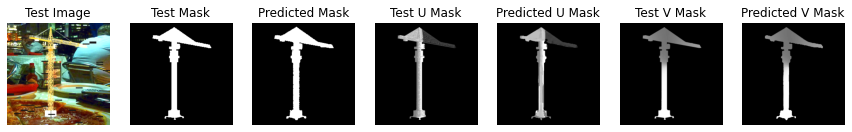

===> Epoch[159/200](0/500): Loss_Mask: 0.0147	Loss_U_Mask: 0.5065	Loss_V_Mask: 0.2026
===> Epoch[159/200](100/500): Loss_Mask: 0.0107	Loss_U_Mask: 0.3868	Loss_V_Mask: 0.1880
===> Epoch[159/200](200/500): Loss_Mask: 0.0093	Loss_U_Mask: 0.3877	Loss_V_Mask: 0.1786
===> Epoch[159/200](300/500): Loss_Mask: 0.0091	Loss_U_Mask: 0.3262	Loss_V_Mask: 0.1775
===> Epoch[159/200](400/500): Loss_Mask: 0.0106	Loss_U_Mask: 0.4412	Loss_V_Mask: 0.2005
===> Epoch[159/200](500/500): Loss_Mask: 0.0109	Loss_U_Mask: 0.5162	Loss_V_Mask: 0.1993
Val_Loss_Mask: 0.0479	Val_U_Loss_Mask: 0.4437	Val_V_Loss_Mask: 0.2204


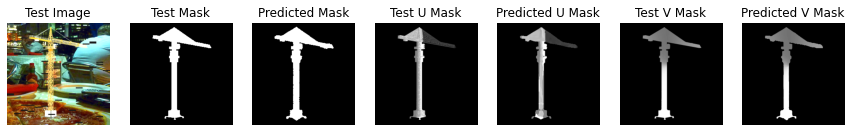

===> Epoch[160/200](0/500): Loss_Mask: 0.0153	Loss_U_Mask: 0.5282	Loss_V_Mask: 0.2084
===> Epoch[160/200](100/500): Loss_Mask: 0.0137	Loss_U_Mask: 0.3979	Loss_V_Mask: 0.2112
===> Epoch[160/200](200/500): Loss_Mask: 0.0095	Loss_U_Mask: 0.4138	Loss_V_Mask: 0.1867
===> Epoch[160/200](300/500): Loss_Mask: 0.0092	Loss_U_Mask: 0.3847	Loss_V_Mask: 0.1886
===> Epoch[160/200](400/500): Loss_Mask: 0.0104	Loss_U_Mask: 0.4837	Loss_V_Mask: 0.2109
===> Epoch[160/200](500/500): Loss_Mask: 0.0100	Loss_U_Mask: 0.5027	Loss_V_Mask: 0.2037
Val_Loss_Mask: 0.0265	Val_U_Loss_Mask: 0.4064	Val_V_Loss_Mask: 0.1779


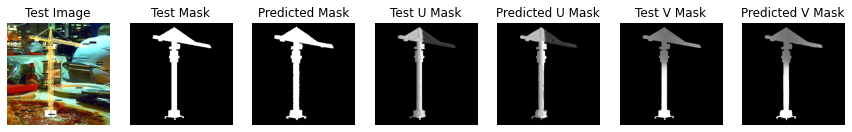

===> Epoch[161/200](0/500): Loss_Mask: 0.0189	Loss_U_Mask: 0.5226	Loss_V_Mask: 0.2308
===> Epoch[161/200](100/500): Loss_Mask: 0.0102	Loss_U_Mask: 0.5031	Loss_V_Mask: 0.1989
===> Epoch[161/200](200/500): Loss_Mask: 0.0091	Loss_U_Mask: 0.3942	Loss_V_Mask: 0.1785
===> Epoch[161/200](300/500): Loss_Mask: 0.0122	Loss_U_Mask: 0.5430	Loss_V_Mask: 0.2239
===> Epoch[161/200](400/500): Loss_Mask: 0.0091	Loss_U_Mask: 0.4649	Loss_V_Mask: 0.1887
===> Epoch[161/200](500/500): Loss_Mask: 0.0101	Loss_U_Mask: 0.4003	Loss_V_Mask: 0.2020
Val_Loss_Mask: 0.0337	Val_U_Loss_Mask: 0.4144	Val_V_Loss_Mask: 0.1922


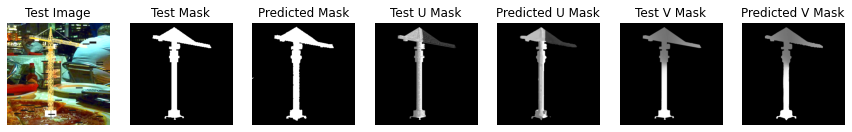

===> Epoch[162/200](0/500): Loss_Mask: 0.0111	Loss_U_Mask: 0.4445	Loss_V_Mask: 0.1924
===> Epoch[162/200](100/500): Loss_Mask: 0.0120	Loss_U_Mask: 0.5069	Loss_V_Mask: 0.2064
===> Epoch[162/200](200/500): Loss_Mask: 0.0101	Loss_U_Mask: 0.4290	Loss_V_Mask: 0.1990
===> Epoch[162/200](300/500): Loss_Mask: 0.0086	Loss_U_Mask: 0.3900	Loss_V_Mask: 0.1953
===> Epoch[162/200](400/500): Loss_Mask: 0.0095	Loss_U_Mask: 0.4451	Loss_V_Mask: 0.1758
===> Epoch[162/200](500/500): Loss_Mask: 0.0180	Loss_U_Mask: 0.3133	Loss_V_Mask: 0.1984
Val_Loss_Mask: 0.0275	Val_U_Loss_Mask: 0.4063	Val_V_Loss_Mask: 0.1728


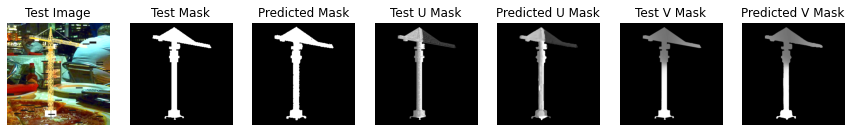

===> Epoch[163/200](0/500): Loss_Mask: 0.0109	Loss_U_Mask: 0.4028	Loss_V_Mask: 0.1743
===> Epoch[163/200](100/500): Loss_Mask: 0.0113	Loss_U_Mask: 0.4968	Loss_V_Mask: 0.1983
===> Epoch[163/200](200/500): Loss_Mask: 0.0207	Loss_U_Mask: 0.4553	Loss_V_Mask: 0.2314
===> Epoch[163/200](300/500): Loss_Mask: 0.0108	Loss_U_Mask: 0.4898	Loss_V_Mask: 0.2035
===> Epoch[163/200](400/500): Loss_Mask: 0.0105	Loss_U_Mask: 0.5073	Loss_V_Mask: 0.2002
===> Epoch[163/200](500/500): Loss_Mask: 0.0108	Loss_U_Mask: 0.4258	Loss_V_Mask: 0.2001
Val_Loss_Mask: 0.0302	Val_U_Loss_Mask: 0.4284	Val_V_Loss_Mask: 0.1887


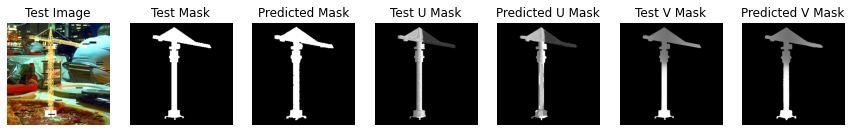

===> Epoch[164/200](0/500): Loss_Mask: 0.0185	Loss_U_Mask: 0.5152	Loss_V_Mask: 0.2003
===> Epoch[164/200](100/500): Loss_Mask: 0.0090	Loss_U_Mask: 0.4967	Loss_V_Mask: 0.2038
===> Epoch[164/200](200/500): Loss_Mask: 0.0098	Loss_U_Mask: 0.4996	Loss_V_Mask: 0.2141
===> Epoch[164/200](300/500): Loss_Mask: 0.0104	Loss_U_Mask: 0.5113	Loss_V_Mask: 0.2110
===> Epoch[164/200](400/500): Loss_Mask: 0.0167	Loss_U_Mask: 0.5260	Loss_V_Mask: 0.2212
===> Epoch[164/200](500/500): Loss_Mask: 0.0097	Loss_U_Mask: 0.4435	Loss_V_Mask: 0.1962
Val_Loss_Mask: 0.0307	Val_U_Loss_Mask: 0.4192	Val_V_Loss_Mask: 0.1879


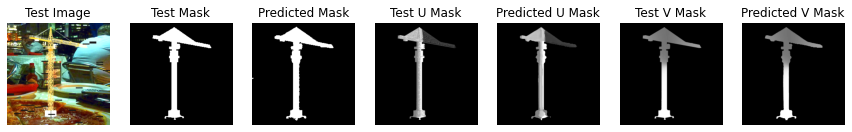

===> Epoch[165/200](0/500): Loss_Mask: 0.0128	Loss_U_Mask: 0.5315	Loss_V_Mask: 0.1978
===> Epoch[165/200](100/500): Loss_Mask: 0.0117	Loss_U_Mask: 0.4344	Loss_V_Mask: 0.2197
===> Epoch[165/200](200/500): Loss_Mask: 0.0094	Loss_U_Mask: 0.4823	Loss_V_Mask: 0.1985
===> Epoch[165/200](300/500): Loss_Mask: 0.0160	Loss_U_Mask: 0.3980	Loss_V_Mask: 0.1992
===> Epoch[165/200](400/500): Loss_Mask: 0.0085	Loss_U_Mask: 0.4322	Loss_V_Mask: 0.1889
===> Epoch[165/200](500/500): Loss_Mask: 0.0153	Loss_U_Mask: 0.4726	Loss_V_Mask: 0.2105
Val_Loss_Mask: 0.0248	Val_U_Loss_Mask: 0.4135	Val_V_Loss_Mask: 0.1774


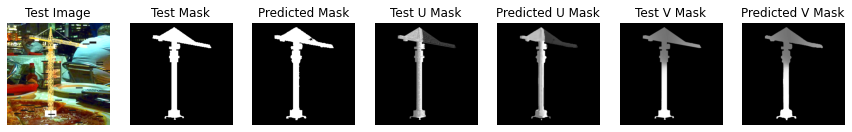

===> Epoch[166/200](0/500): Loss_Mask: 0.0251	Loss_U_Mask: 0.5600	Loss_V_Mask: 0.2247
===> Epoch[166/200](100/500): Loss_Mask: 0.0105	Loss_U_Mask: 0.4325	Loss_V_Mask: 0.2067
===> Epoch[166/200](200/500): Loss_Mask: 0.0078	Loss_U_Mask: 0.3890	Loss_V_Mask: 0.1849
===> Epoch[166/200](300/500): Loss_Mask: 0.0194	Loss_U_Mask: 0.5524	Loss_V_Mask: 0.2397
===> Epoch[166/200](400/500): Loss_Mask: 0.0100	Loss_U_Mask: 0.4911	Loss_V_Mask: 0.2012
===> Epoch[166/200](500/500): Loss_Mask: 0.0113	Loss_U_Mask: 0.4279	Loss_V_Mask: 0.2052
Val_Loss_Mask: 0.0285	Val_U_Loss_Mask: 0.4081	Val_V_Loss_Mask: 0.1809


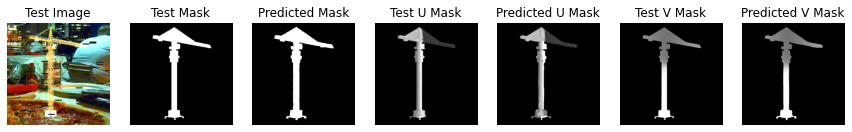

===> Epoch[167/200](0/500): Loss_Mask: 0.0243	Loss_U_Mask: 0.4879	Loss_V_Mask: 0.2132
===> Epoch[167/200](100/500): Loss_Mask: 0.0087	Loss_U_Mask: 0.3102	Loss_V_Mask: 0.1904
===> Epoch[167/200](200/500): Loss_Mask: 0.0123	Loss_U_Mask: 0.4518	Loss_V_Mask: 0.2025
===> Epoch[167/200](300/500): Loss_Mask: 0.0085	Loss_U_Mask: 0.4394	Loss_V_Mask: 0.1903
===> Epoch[167/200](400/500): Loss_Mask: 0.0090	Loss_U_Mask: 0.3682	Loss_V_Mask: 0.1755
===> Epoch[167/200](500/500): Loss_Mask: 0.0116	Loss_U_Mask: 0.4599	Loss_V_Mask: 0.2151
Val_Loss_Mask: 0.0302	Val_U_Loss_Mask: 0.4160	Val_V_Loss_Mask: 0.1889


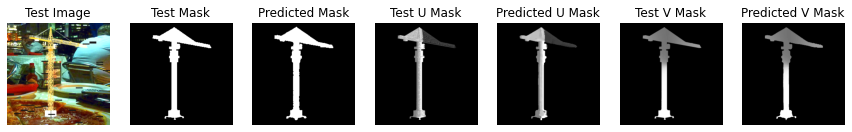

===> Epoch[168/200](0/500): Loss_Mask: 0.0131	Loss_U_Mask: 0.4447	Loss_V_Mask: 0.2014
===> Epoch[168/200](100/500): Loss_Mask: 0.0094	Loss_U_Mask: 0.5025	Loss_V_Mask: 0.1887
===> Epoch[168/200](200/500): Loss_Mask: 0.0176	Loss_U_Mask: 0.4909	Loss_V_Mask: 0.2301
===> Epoch[168/200](300/500): Loss_Mask: 0.0093	Loss_U_Mask: 0.4003	Loss_V_Mask: 0.1931
===> Epoch[168/200](400/500): Loss_Mask: 0.0134	Loss_U_Mask: 0.4327	Loss_V_Mask: 0.1946
===> Epoch[168/200](500/500): Loss_Mask: 0.0157	Loss_U_Mask: 0.4126	Loss_V_Mask: 0.2042
Val_Loss_Mask: 0.0257	Val_U_Loss_Mask: 0.4089	Val_V_Loss_Mask: 0.1777


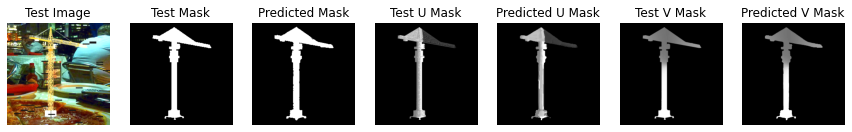

===> Epoch[169/200](0/500): Loss_Mask: 0.0184	Loss_U_Mask: 0.5148	Loss_V_Mask: 0.2322
===> Epoch[169/200](100/500): Loss_Mask: 0.0126	Loss_U_Mask: 0.4197	Loss_V_Mask: 0.1913
===> Epoch[169/200](200/500): Loss_Mask: 0.0106	Loss_U_Mask: 0.4267	Loss_V_Mask: 0.2135
===> Epoch[169/200](300/500): Loss_Mask: 0.0292	Loss_U_Mask: 0.4217	Loss_V_Mask: 0.2223
===> Epoch[169/200](400/500): Loss_Mask: 0.0095	Loss_U_Mask: 0.4091	Loss_V_Mask: 0.1853
===> Epoch[169/200](500/500): Loss_Mask: 0.0112	Loss_U_Mask: 0.3651	Loss_V_Mask: 0.1963
Val_Loss_Mask: 0.0301	Val_U_Loss_Mask: 0.4158	Val_V_Loss_Mask: 0.1849


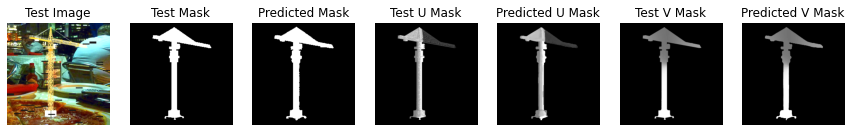

===> Epoch[170/200](0/500): Loss_Mask: 0.0147	Loss_U_Mask: 0.3880	Loss_V_Mask: 0.1870
===> Epoch[170/200](100/500): Loss_Mask: 0.0103	Loss_U_Mask: 0.4096	Loss_V_Mask: 0.2057
===> Epoch[170/200](200/500): Loss_Mask: 0.0102	Loss_U_Mask: 0.5420	Loss_V_Mask: 0.1996
===> Epoch[170/200](300/500): Loss_Mask: 0.0203	Loss_U_Mask: 0.5716	Loss_V_Mask: 0.2612
===> Epoch[170/200](400/500): Loss_Mask: 0.0101	Loss_U_Mask: 0.4838	Loss_V_Mask: 0.1987
===> Epoch[170/200](500/500): Loss_Mask: 0.0111	Loss_U_Mask: 0.4272	Loss_V_Mask: 0.1991
Val_Loss_Mask: 0.0299	Val_U_Loss_Mask: 0.4210	Val_V_Loss_Mask: 0.1820


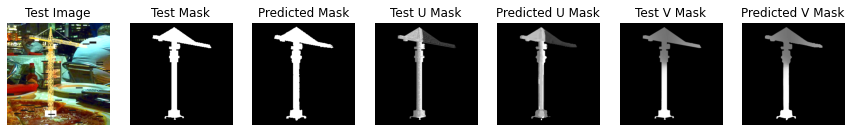

===> Epoch[171/200](0/500): Loss_Mask: 0.0175	Loss_U_Mask: 0.4549	Loss_V_Mask: 0.2129
===> Epoch[171/200](100/500): Loss_Mask: 0.0137	Loss_U_Mask: 0.4479	Loss_V_Mask: 0.2151
===> Epoch[171/200](200/500): Loss_Mask: 0.0084	Loss_U_Mask: 0.5011	Loss_V_Mask: 0.1981
===> Epoch[171/200](300/500): Loss_Mask: 0.0233	Loss_U_Mask: 0.5204	Loss_V_Mask: 0.2040
===> Epoch[171/200](400/500): Loss_Mask: 0.0112	Loss_U_Mask: 0.5043	Loss_V_Mask: 0.2257
===> Epoch[171/200](500/500): Loss_Mask: 0.0121	Loss_U_Mask: 0.4607	Loss_V_Mask: 0.2118
Val_Loss_Mask: 0.0281	Val_U_Loss_Mask: 0.4132	Val_V_Loss_Mask: 0.1814


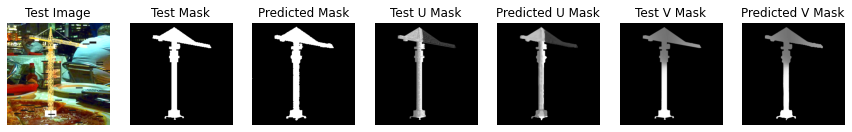

===> Epoch[172/200](0/500): Loss_Mask: 0.0129	Loss_U_Mask: 0.4683	Loss_V_Mask: 0.1896
===> Epoch[172/200](100/500): Loss_Mask: 0.0102	Loss_U_Mask: 0.4125	Loss_V_Mask: 0.1905
===> Epoch[172/200](200/500): Loss_Mask: 0.0096	Loss_U_Mask: 0.4248	Loss_V_Mask: 0.1969
===> Epoch[172/200](300/500): Loss_Mask: 0.0098	Loss_U_Mask: 0.4375	Loss_V_Mask: 0.2085
===> Epoch[172/200](400/500): Loss_Mask: 0.0083	Loss_U_Mask: 0.3759	Loss_V_Mask: 0.1805
===> Epoch[172/200](500/500): Loss_Mask: 0.0101	Loss_U_Mask: 0.5291	Loss_V_Mask: 0.2031
Val_Loss_Mask: 0.0241	Val_U_Loss_Mask: 0.4015	Val_V_Loss_Mask: 0.1736


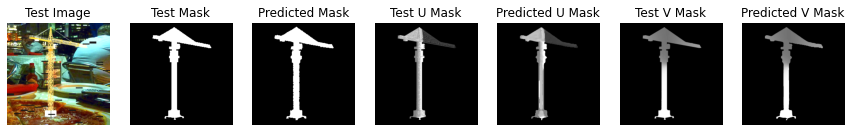

===> Epoch[173/200](0/500): Loss_Mask: 0.0118	Loss_U_Mask: 0.3981	Loss_V_Mask: 0.1899
===> Epoch[173/200](100/500): Loss_Mask: 0.0092	Loss_U_Mask: 0.4040	Loss_V_Mask: 0.1874
===> Epoch[173/200](200/500): Loss_Mask: 0.0141	Loss_U_Mask: 0.4245	Loss_V_Mask: 0.2053
===> Epoch[173/200](300/500): Loss_Mask: 0.0096	Loss_U_Mask: 0.4097	Loss_V_Mask: 0.1995
===> Epoch[173/200](400/500): Loss_Mask: 0.0107	Loss_U_Mask: 0.4325	Loss_V_Mask: 0.1995
===> Epoch[173/200](500/500): Loss_Mask: 0.0155	Loss_U_Mask: 0.4306	Loss_V_Mask: 0.2166
Val_Loss_Mask: 0.0259	Val_U_Loss_Mask: 0.4045	Val_V_Loss_Mask: 0.1776


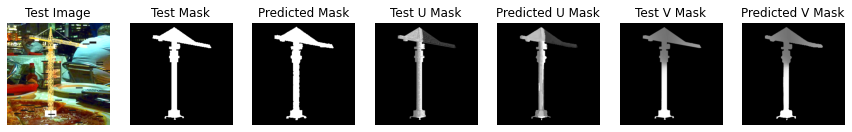

===> Epoch[174/200](0/500): Loss_Mask: 0.0214	Loss_U_Mask: 0.3926	Loss_V_Mask: 0.2147
===> Epoch[174/200](100/500): Loss_Mask: 0.0099	Loss_U_Mask: 0.4487	Loss_V_Mask: 0.2001
===> Epoch[174/200](200/500): Loss_Mask: 0.0094	Loss_U_Mask: 0.4920	Loss_V_Mask: 0.2022
===> Epoch[174/200](300/500): Loss_Mask: 0.0104	Loss_U_Mask: 0.4646	Loss_V_Mask: 0.1915
===> Epoch[174/200](400/500): Loss_Mask: 0.0109	Loss_U_Mask: 0.4566	Loss_V_Mask: 0.1973
===> Epoch[174/200](500/500): Loss_Mask: 0.0115	Loss_U_Mask: 0.4245	Loss_V_Mask: 0.1933
Val_Loss_Mask: 0.0586	Val_U_Loss_Mask: 0.4649	Val_V_Loss_Mask: 0.2543


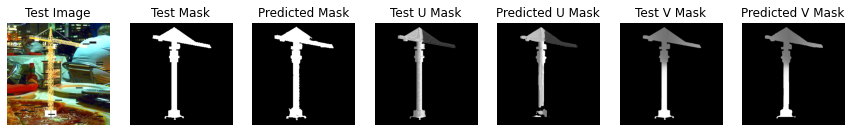

===> Epoch[175/200](0/500): Loss_Mask: 0.0137	Loss_U_Mask: 0.4405	Loss_V_Mask: 0.1916
===> Epoch[175/200](100/500): Loss_Mask: 0.0134	Loss_U_Mask: 0.4593	Loss_V_Mask: 0.1963
===> Epoch[175/200](200/500): Loss_Mask: 0.0099	Loss_U_Mask: 0.4294	Loss_V_Mask: 0.2023
===> Epoch[175/200](300/500): Loss_Mask: 0.0102	Loss_U_Mask: 0.5146	Loss_V_Mask: 0.2106
===> Epoch[175/200](400/500): Loss_Mask: 0.0099	Loss_U_Mask: 0.4376	Loss_V_Mask: 0.2080
===> Epoch[175/200](500/500): Loss_Mask: 0.0097	Loss_U_Mask: 0.4761	Loss_V_Mask: 0.1882
Val_Loss_Mask: 0.0276	Val_U_Loss_Mask: 0.4076	Val_V_Loss_Mask: 0.1784


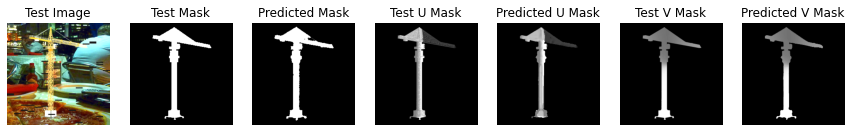

===> Epoch[176/200](0/500): Loss_Mask: 0.0193	Loss_U_Mask: 0.4942	Loss_V_Mask: 0.2118
===> Epoch[176/200](100/500): Loss_Mask: 0.0084	Loss_U_Mask: 0.3761	Loss_V_Mask: 0.1896
===> Epoch[176/200](200/500): Loss_Mask: 0.0113	Loss_U_Mask: 0.4576	Loss_V_Mask: 0.1928
===> Epoch[176/200](300/500): Loss_Mask: 0.0137	Loss_U_Mask: 0.4235	Loss_V_Mask: 0.2047
===> Epoch[176/200](400/500): Loss_Mask: 0.0091	Loss_U_Mask: 0.3699	Loss_V_Mask: 0.1971
===> Epoch[176/200](500/500): Loss_Mask: 0.0132	Loss_U_Mask: 0.4763	Loss_V_Mask: 0.1920
Val_Loss_Mask: 0.0257	Val_U_Loss_Mask: 0.4151	Val_V_Loss_Mask: 0.1785


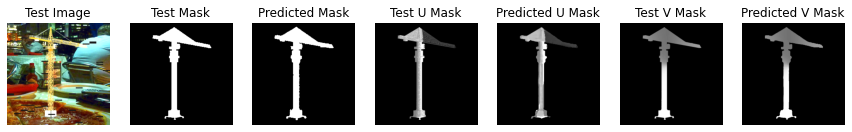

===> Epoch[177/200](0/500): Loss_Mask: 0.0161	Loss_U_Mask: 0.4828	Loss_V_Mask: 0.2162
===> Epoch[177/200](100/500): Loss_Mask: 0.0087	Loss_U_Mask: 0.4880	Loss_V_Mask: 0.1807
===> Epoch[177/200](200/500): Loss_Mask: 0.0124	Loss_U_Mask: 0.4417	Loss_V_Mask: 0.1893
===> Epoch[177/200](300/500): Loss_Mask: 0.0121	Loss_U_Mask: 0.4891	Loss_V_Mask: 0.2164
===> Epoch[177/200](400/500): Loss_Mask: 0.0174	Loss_U_Mask: 0.4951	Loss_V_Mask: 0.2176
===> Epoch[177/200](500/500): Loss_Mask: 0.0110	Loss_U_Mask: 0.4639	Loss_V_Mask: 0.1948
Val_Loss_Mask: 0.0274	Val_U_Loss_Mask: 0.4122	Val_V_Loss_Mask: 0.1819


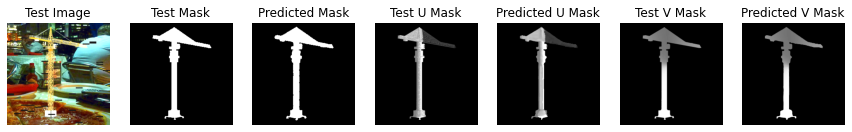

===> Epoch[178/200](0/500): Loss_Mask: 0.0113	Loss_U_Mask: 0.3101	Loss_V_Mask: 0.1792
===> Epoch[178/200](100/500): Loss_Mask: 0.0076	Loss_U_Mask: 0.3609	Loss_V_Mask: 0.1901
===> Epoch[178/200](200/500): Loss_Mask: 0.0095	Loss_U_Mask: 0.4526	Loss_V_Mask: 0.1887
===> Epoch[178/200](300/500): Loss_Mask: 0.0126	Loss_U_Mask: 0.5311	Loss_V_Mask: 0.2049
===> Epoch[178/200](400/500): Loss_Mask: 0.0102	Loss_U_Mask: 0.4726	Loss_V_Mask: 0.1944
===> Epoch[178/200](500/500): Loss_Mask: 0.0123	Loss_U_Mask: 0.4379	Loss_V_Mask: 0.2268
Val_Loss_Mask: 0.0277	Val_U_Loss_Mask: 0.4196	Val_V_Loss_Mask: 0.1831


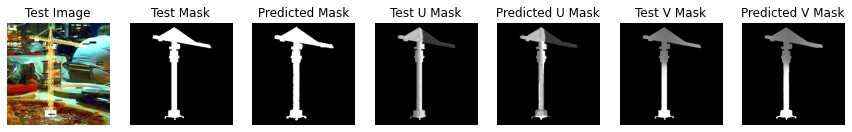

===> Epoch[179/200](0/500): Loss_Mask: 0.0128	Loss_U_Mask: 0.5238	Loss_V_Mask: 0.1967
===> Epoch[179/200](100/500): Loss_Mask: 0.0113	Loss_U_Mask: 0.5016	Loss_V_Mask: 0.2031
===> Epoch[179/200](200/500): Loss_Mask: 0.0127	Loss_U_Mask: 0.4389	Loss_V_Mask: 0.2123
===> Epoch[179/200](300/500): Loss_Mask: 0.0233	Loss_U_Mask: 0.4147	Loss_V_Mask: 0.2194
===> Epoch[179/200](400/500): Loss_Mask: 0.0089	Loss_U_Mask: 0.4491	Loss_V_Mask: 0.1873
===> Epoch[179/200](500/500): Loss_Mask: 0.0110	Loss_U_Mask: 0.3604	Loss_V_Mask: 0.2022
Val_Loss_Mask: 0.0263	Val_U_Loss_Mask: 0.4119	Val_V_Loss_Mask: 0.1816


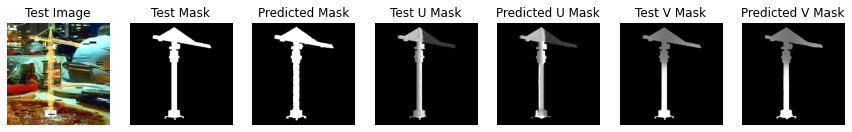

===> Epoch[180/200](0/500): Loss_Mask: 0.0131	Loss_U_Mask: 0.4891	Loss_V_Mask: 0.1945
===> Epoch[180/200](100/500): Loss_Mask: 0.0114	Loss_U_Mask: 0.4788	Loss_V_Mask: 0.2089
===> Epoch[180/200](200/500): Loss_Mask: 0.0122	Loss_U_Mask: 0.4249	Loss_V_Mask: 0.1936
===> Epoch[180/200](300/500): Loss_Mask: 0.0095	Loss_U_Mask: 0.4752	Loss_V_Mask: 0.2027
===> Epoch[180/200](400/500): Loss_Mask: 0.0151	Loss_U_Mask: 0.4824	Loss_V_Mask: 0.2134
===> Epoch[180/200](500/500): Loss_Mask: 0.0132	Loss_U_Mask: 0.5073	Loss_V_Mask: 0.2159
Val_Loss_Mask: 0.0281	Val_U_Loss_Mask: 0.4121	Val_V_Loss_Mask: 0.1762


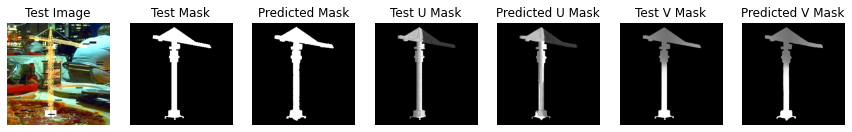

===> Epoch[181/200](0/500): Loss_Mask: 0.0185	Loss_U_Mask: 0.5025	Loss_V_Mask: 0.2141
===> Epoch[181/200](100/500): Loss_Mask: 0.0132	Loss_U_Mask: 0.4894	Loss_V_Mask: 0.2229
===> Epoch[181/200](200/500): Loss_Mask: 0.0163	Loss_U_Mask: 0.4892	Loss_V_Mask: 0.2326
===> Epoch[181/200](300/500): Loss_Mask: 0.0087	Loss_U_Mask: 0.3920	Loss_V_Mask: 0.1881
===> Epoch[181/200](400/500): Loss_Mask: 0.0079	Loss_U_Mask: 0.3801	Loss_V_Mask: 0.1909
===> Epoch[181/200](500/500): Loss_Mask: 0.0096	Loss_U_Mask: 0.4826	Loss_V_Mask: 0.2071
Val_Loss_Mask: 0.0283	Val_U_Loss_Mask: 0.4061	Val_V_Loss_Mask: 0.1765


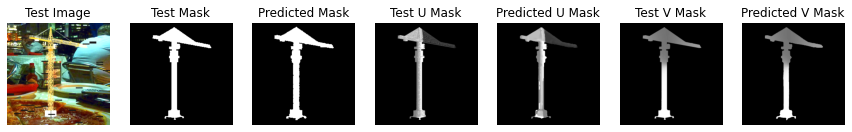

===> Epoch[182/200](0/500): Loss_Mask: 0.0143	Loss_U_Mask: 0.4043	Loss_V_Mask: 0.1890
===> Epoch[182/200](100/500): Loss_Mask: 0.0192	Loss_U_Mask: 0.4206	Loss_V_Mask: 0.2307
===> Epoch[182/200](200/500): Loss_Mask: 0.0123	Loss_U_Mask: 0.5161	Loss_V_Mask: 0.2006
===> Epoch[182/200](300/500): Loss_Mask: 0.0096	Loss_U_Mask: 0.5054	Loss_V_Mask: 0.1855
===> Epoch[182/200](400/500): Loss_Mask: 0.0093	Loss_U_Mask: 0.4205	Loss_V_Mask: 0.1995
===> Epoch[182/200](500/500): Loss_Mask: 0.0118	Loss_U_Mask: 0.4383	Loss_V_Mask: 0.2007
Val_Loss_Mask: 0.0262	Val_U_Loss_Mask: 0.4109	Val_V_Loss_Mask: 0.1817


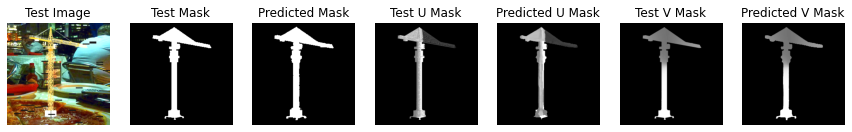

===> Epoch[183/200](0/500): Loss_Mask: 0.0193	Loss_U_Mask: 0.5160	Loss_V_Mask: 0.2302
===> Epoch[183/200](100/500): Loss_Mask: 0.0159	Loss_U_Mask: 0.4997	Loss_V_Mask: 0.2355
===> Epoch[183/200](200/500): Loss_Mask: 0.0145	Loss_U_Mask: 0.4775	Loss_V_Mask: 0.2211
===> Epoch[183/200](300/500): Loss_Mask: 0.0111	Loss_U_Mask: 0.4312	Loss_V_Mask: 0.2069
===> Epoch[183/200](400/500): Loss_Mask: 0.0135	Loss_U_Mask: 0.5156	Loss_V_Mask: 0.2116
===> Epoch[183/200](500/500): Loss_Mask: 0.0109	Loss_U_Mask: 0.4491	Loss_V_Mask: 0.1961
Val_Loss_Mask: 0.0269	Val_U_Loss_Mask: 0.4037	Val_V_Loss_Mask: 0.1789


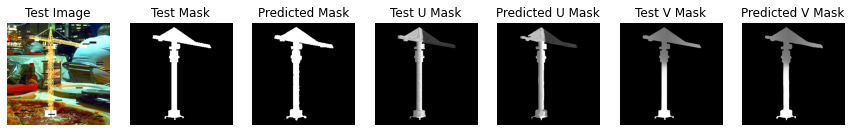

===> Epoch[184/200](0/500): Loss_Mask: 0.0131	Loss_U_Mask: 0.4315	Loss_V_Mask: 0.1811
===> Epoch[184/200](100/500): Loss_Mask: 0.0264	Loss_U_Mask: 0.4509	Loss_V_Mask: 0.2427
===> Epoch[184/200](200/500): Loss_Mask: 0.0102	Loss_U_Mask: 0.4784	Loss_V_Mask: 0.2040
===> Epoch[184/200](300/500): Loss_Mask: 0.0106	Loss_U_Mask: 0.4785	Loss_V_Mask: 0.2026
===> Epoch[184/200](400/500): Loss_Mask: 0.0116	Loss_U_Mask: 0.4466	Loss_V_Mask: 0.1941
===> Epoch[184/200](500/500): Loss_Mask: 0.0095	Loss_U_Mask: 0.4863	Loss_V_Mask: 0.1977
Val_Loss_Mask: 0.0268	Val_U_Loss_Mask: 0.4178	Val_V_Loss_Mask: 0.1790


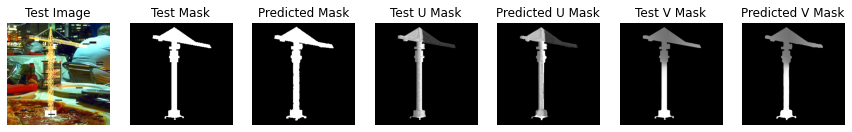

===> Epoch[185/200](0/500): Loss_Mask: 0.0136	Loss_U_Mask: 0.4970	Loss_V_Mask: 0.1945
===> Epoch[185/200](100/500): Loss_Mask: 0.0088	Loss_U_Mask: 0.4561	Loss_V_Mask: 0.2010
===> Epoch[185/200](200/500): Loss_Mask: 0.0136	Loss_U_Mask: 0.3750	Loss_V_Mask: 0.2035
===> Epoch[185/200](300/500): Loss_Mask: 0.0127	Loss_U_Mask: 0.5280	Loss_V_Mask: 0.2312
===> Epoch[185/200](400/500): Loss_Mask: 0.0103	Loss_U_Mask: 0.5154	Loss_V_Mask: 0.2016
===> Epoch[185/200](500/500): Loss_Mask: 0.0104	Loss_U_Mask: 0.5133	Loss_V_Mask: 0.2072
Val_Loss_Mask: 0.0352	Val_U_Loss_Mask: 0.4153	Val_V_Loss_Mask: 0.1898


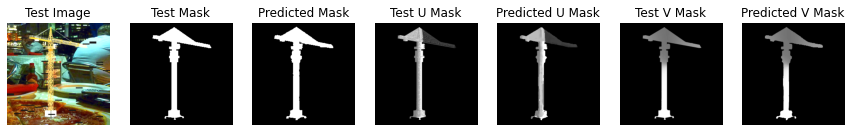

===> Epoch[186/200](0/500): Loss_Mask: 0.0126	Loss_U_Mask: 0.4400	Loss_V_Mask: 0.2031
===> Epoch[186/200](100/500): Loss_Mask: 0.0123	Loss_U_Mask: 0.4264	Loss_V_Mask: 0.2092
===> Epoch[186/200](200/500): Loss_Mask: 0.0156	Loss_U_Mask: 0.5215	Loss_V_Mask: 0.2368
===> Epoch[186/200](300/500): Loss_Mask: 0.0084	Loss_U_Mask: 0.4765	Loss_V_Mask: 0.1915
===> Epoch[186/200](400/500): Loss_Mask: 0.0090	Loss_U_Mask: 0.4994	Loss_V_Mask: 0.2037
===> Epoch[186/200](500/500): Loss_Mask: 0.0116	Loss_U_Mask: 0.4749	Loss_V_Mask: 0.2013
Val_Loss_Mask: 0.0272	Val_U_Loss_Mask: 0.4248	Val_V_Loss_Mask: 0.1808


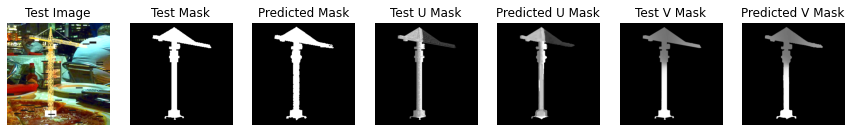

===> Epoch[187/200](0/500): Loss_Mask: 0.0179	Loss_U_Mask: 0.5402	Loss_V_Mask: 0.2018
===> Epoch[187/200](100/500): Loss_Mask: 0.0313	Loss_U_Mask: 0.4924	Loss_V_Mask: 0.2523
===> Epoch[187/200](200/500): Loss_Mask: 0.0098	Loss_U_Mask: 0.3931	Loss_V_Mask: 0.1982
===> Epoch[187/200](300/500): Loss_Mask: 0.0174	Loss_U_Mask: 0.3669	Loss_V_Mask: 0.2030
===> Epoch[187/200](400/500): Loss_Mask: 0.0128	Loss_U_Mask: 0.5170	Loss_V_Mask: 0.2129
===> Epoch[187/200](500/500): Loss_Mask: 0.0094	Loss_U_Mask: 0.5268	Loss_V_Mask: 0.2114
Val_Loss_Mask: 0.0260	Val_U_Loss_Mask: 0.4128	Val_V_Loss_Mask: 0.1780


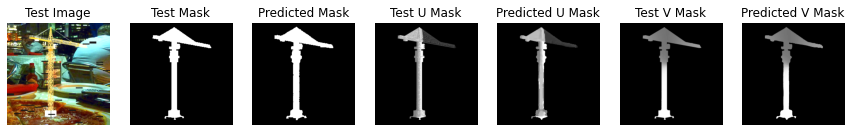

===> Epoch[188/200](0/500): Loss_Mask: 0.0112	Loss_U_Mask: 0.4550	Loss_V_Mask: 0.1879
===> Epoch[188/200](100/500): Loss_Mask: 0.0141	Loss_U_Mask: 0.4632	Loss_V_Mask: 0.2141
===> Epoch[188/200](200/500): Loss_Mask: 0.0098	Loss_U_Mask: 0.4260	Loss_V_Mask: 0.1826
===> Epoch[188/200](300/500): Loss_Mask: 0.0103	Loss_U_Mask: 0.5247	Loss_V_Mask: 0.2272
===> Epoch[188/200](400/500): Loss_Mask: 0.0113	Loss_U_Mask: 0.4896	Loss_V_Mask: 0.1957
===> Epoch[188/200](500/500): Loss_Mask: 0.0109	Loss_U_Mask: 0.5121	Loss_V_Mask: 0.1943
Val_Loss_Mask: 0.0263	Val_U_Loss_Mask: 0.4143	Val_V_Loss_Mask: 0.1828


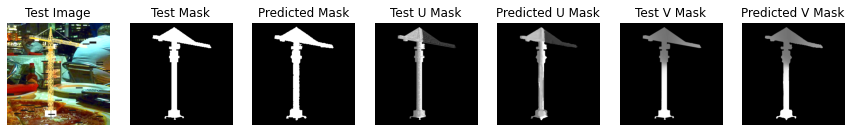

===> Epoch[189/200](0/500): Loss_Mask: 0.0173	Loss_U_Mask: 0.4788	Loss_V_Mask: 0.2008
===> Epoch[189/200](100/500): Loss_Mask: 0.0090	Loss_U_Mask: 0.3931	Loss_V_Mask: 0.1940
===> Epoch[189/200](200/500): Loss_Mask: 0.0106	Loss_U_Mask: 0.5002	Loss_V_Mask: 0.1957
===> Epoch[189/200](300/500): Loss_Mask: 0.0100	Loss_U_Mask: 0.4627	Loss_V_Mask: 0.1866
===> Epoch[189/200](400/500): Loss_Mask: 0.0120	Loss_U_Mask: 0.4581	Loss_V_Mask: 0.2098
===> Epoch[189/200](500/500): Loss_Mask: 0.0123	Loss_U_Mask: 0.4794	Loss_V_Mask: 0.2079
Val_Loss_Mask: 0.0256	Val_U_Loss_Mask: 0.4041	Val_V_Loss_Mask: 0.1768


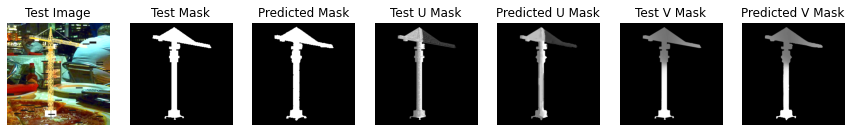

===> Epoch[190/200](0/500): Loss_Mask: 0.0133	Loss_U_Mask: 0.4528	Loss_V_Mask: 0.1903
===> Epoch[190/200](100/500): Loss_Mask: 0.0128	Loss_U_Mask: 0.4825	Loss_V_Mask: 0.1891
===> Epoch[190/200](200/500): Loss_Mask: 0.0113	Loss_U_Mask: 0.4785	Loss_V_Mask: 0.1952
===> Epoch[190/200](300/500): Loss_Mask: 0.0087	Loss_U_Mask: 0.4511	Loss_V_Mask: 0.1865
===> Epoch[190/200](400/500): Loss_Mask: 0.0150	Loss_U_Mask: 0.5293	Loss_V_Mask: 0.2263
===> Epoch[190/200](500/500): Loss_Mask: 0.0107	Loss_U_Mask: 0.5485	Loss_V_Mask: 0.2025
Val_Loss_Mask: 0.0214	Val_U_Loss_Mask: 0.4050	Val_V_Loss_Mask: 0.1709


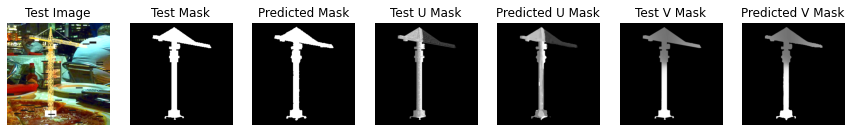

===> Epoch[191/200](0/500): Loss_Mask: 0.0130	Loss_U_Mask: 0.4954	Loss_V_Mask: 0.2031
===> Epoch[191/200](100/500): Loss_Mask: 0.0115	Loss_U_Mask: 0.4365	Loss_V_Mask: 0.1997
===> Epoch[191/200](200/500): Loss_Mask: 0.0178	Loss_U_Mask: 0.4415	Loss_V_Mask: 0.2185
===> Epoch[191/200](300/500): Loss_Mask: 0.0099	Loss_U_Mask: 0.4581	Loss_V_Mask: 0.1983
===> Epoch[191/200](400/500): Loss_Mask: 0.0096	Loss_U_Mask: 0.4261	Loss_V_Mask: 0.1910
===> Epoch[191/200](500/500): Loss_Mask: 0.0114	Loss_U_Mask: 0.5110	Loss_V_Mask: 0.2132
Val_Loss_Mask: 0.0273	Val_U_Loss_Mask: 0.4063	Val_V_Loss_Mask: 0.1819


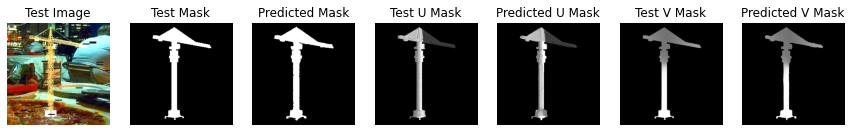

===> Epoch[192/200](0/500): Loss_Mask: 0.0200	Loss_U_Mask: 0.4946	Loss_V_Mask: 0.2436
===> Epoch[192/200](100/500): Loss_Mask: 0.0096	Loss_U_Mask: 0.5150	Loss_V_Mask: 0.1998
===> Epoch[192/200](200/500): Loss_Mask: 0.0075	Loss_U_Mask: 0.4123	Loss_V_Mask: 0.1835
===> Epoch[192/200](300/500): Loss_Mask: 0.0097	Loss_U_Mask: 0.4860	Loss_V_Mask: 0.1974
===> Epoch[192/200](400/500): Loss_Mask: 0.0099	Loss_U_Mask: 0.5094	Loss_V_Mask: 0.2075
===> Epoch[192/200](500/500): Loss_Mask: 0.0090	Loss_U_Mask: 0.4703	Loss_V_Mask: 0.1957
Val_Loss_Mask: 0.0273	Val_U_Loss_Mask: 0.4070	Val_V_Loss_Mask: 0.1771


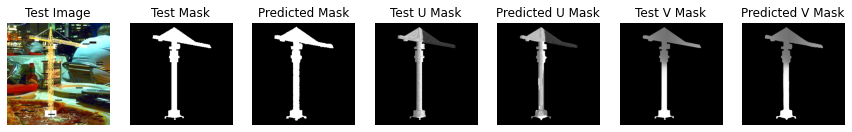

===> Epoch[193/200](0/500): Loss_Mask: 0.0201	Loss_U_Mask: 0.4878	Loss_V_Mask: 0.2113
===> Epoch[193/200](100/500): Loss_Mask: 0.0073	Loss_U_Mask: 0.4436	Loss_V_Mask: 0.1892
===> Epoch[193/200](200/500): Loss_Mask: 0.0155	Loss_U_Mask: 0.4272	Loss_V_Mask: 0.1959
===> Epoch[193/200](300/500): Loss_Mask: 0.0156	Loss_U_Mask: 0.4818	Loss_V_Mask: 0.2081
===> Epoch[193/200](400/500): Loss_Mask: 0.0126	Loss_U_Mask: 0.4862	Loss_V_Mask: 0.2012
===> Epoch[193/200](500/500): Loss_Mask: 0.0091	Loss_U_Mask: 0.4170	Loss_V_Mask: 0.1993
Val_Loss_Mask: 0.0248	Val_U_Loss_Mask: 0.4054	Val_V_Loss_Mask: 0.1775


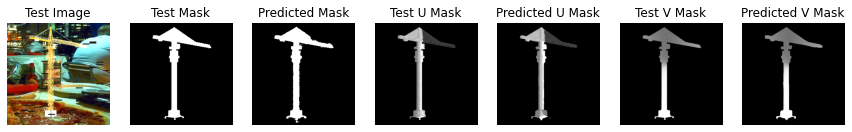

===> Epoch[194/200](0/500): Loss_Mask: 0.0106	Loss_U_Mask: 0.4536	Loss_V_Mask: 0.1802
===> Epoch[194/200](100/500): Loss_Mask: 0.0101	Loss_U_Mask: 0.3940	Loss_V_Mask: 0.1998
===> Epoch[194/200](200/500): Loss_Mask: 0.0087	Loss_U_Mask: 0.3551	Loss_V_Mask: 0.1842
===> Epoch[194/200](300/500): Loss_Mask: 0.0110	Loss_U_Mask: 0.5215	Loss_V_Mask: 0.2057
===> Epoch[194/200](400/500): Loss_Mask: 0.0101	Loss_U_Mask: 0.4752	Loss_V_Mask: 0.2000
===> Epoch[194/200](500/500): Loss_Mask: 0.0141	Loss_U_Mask: 0.3912	Loss_V_Mask: 0.2048
Val_Loss_Mask: 0.0305	Val_U_Loss_Mask: 0.4094	Val_V_Loss_Mask: 0.1869


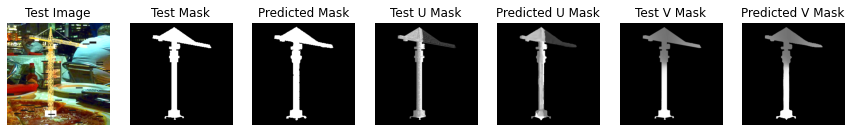

===> Epoch[195/200](0/500): Loss_Mask: 0.0107	Loss_U_Mask: 0.4650	Loss_V_Mask: 0.1907
===> Epoch[195/200](100/500): Loss_Mask: 0.0105	Loss_U_Mask: 0.4742	Loss_V_Mask: 0.1984
===> Epoch[195/200](200/500): Loss_Mask: 0.0109	Loss_U_Mask: 0.4938	Loss_V_Mask: 0.2035
===> Epoch[195/200](300/500): Loss_Mask: 0.0121	Loss_U_Mask: 0.5226	Loss_V_Mask: 0.2198
===> Epoch[195/200](400/500): Loss_Mask: 0.0119	Loss_U_Mask: 0.4411	Loss_V_Mask: 0.1940
===> Epoch[195/200](500/500): Loss_Mask: 0.0120	Loss_U_Mask: 0.5306	Loss_V_Mask: 0.2189
Val_Loss_Mask: 0.0276	Val_U_Loss_Mask: 0.4065	Val_V_Loss_Mask: 0.1762


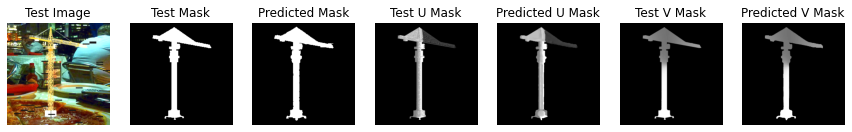

===> Epoch[196/200](0/500): Loss_Mask: 0.0183	Loss_U_Mask: 0.5297	Loss_V_Mask: 0.2126
===> Epoch[196/200](100/500): Loss_Mask: 0.0156	Loss_U_Mask: 0.4890	Loss_V_Mask: 0.2276
===> Epoch[196/200](200/500): Loss_Mask: 0.0123	Loss_U_Mask: 0.4403	Loss_V_Mask: 0.2062
===> Epoch[196/200](300/500): Loss_Mask: 0.0113	Loss_U_Mask: 0.4738	Loss_V_Mask: 0.2060
===> Epoch[196/200](400/500): Loss_Mask: 0.0142	Loss_U_Mask: 0.4788	Loss_V_Mask: 0.2081
===> Epoch[196/200](500/500): Loss_Mask: 0.0125	Loss_U_Mask: 0.4713	Loss_V_Mask: 0.2238
Val_Loss_Mask: 0.0276	Val_U_Loss_Mask: 0.4157	Val_V_Loss_Mask: 0.1828


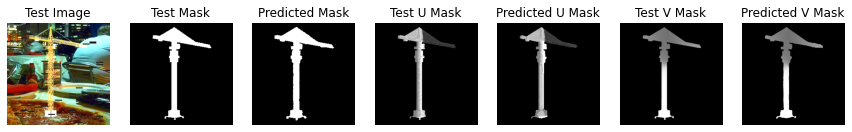

===> Epoch[197/200](0/500): Loss_Mask: 0.0113	Loss_U_Mask: 0.4321	Loss_V_Mask: 0.1830
===> Epoch[197/200](100/500): Loss_Mask: 0.0246	Loss_U_Mask: 0.5111	Loss_V_Mask: 0.2401
===> Epoch[197/200](200/500): Loss_Mask: 0.0145	Loss_U_Mask: 0.4857	Loss_V_Mask: 0.2090
===> Epoch[197/200](300/500): Loss_Mask: 0.0088	Loss_U_Mask: 0.4212	Loss_V_Mask: 0.1957
===> Epoch[197/200](400/500): Loss_Mask: 0.0097	Loss_U_Mask: 0.3818	Loss_V_Mask: 0.1793
===> Epoch[197/200](500/500): Loss_Mask: 0.0144	Loss_U_Mask: 0.5439	Loss_V_Mask: 0.2181
Val_Loss_Mask: 0.0289	Val_U_Loss_Mask: 0.4114	Val_V_Loss_Mask: 0.1782


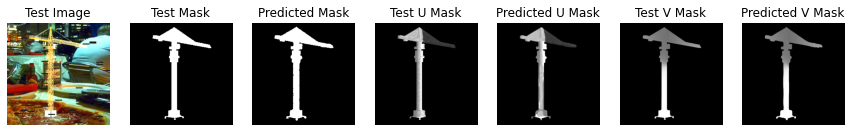

===> Epoch[198/200](0/500): Loss_Mask: 0.0116	Loss_U_Mask: 0.4777	Loss_V_Mask: 0.1976
===> Epoch[198/200](100/500): Loss_Mask: 0.0092	Loss_U_Mask: 0.4552	Loss_V_Mask: 0.2048
===> Epoch[198/200](200/500): Loss_Mask: 0.0101	Loss_U_Mask: 0.4839	Loss_V_Mask: 0.2061
===> Epoch[198/200](300/500): Loss_Mask: 0.0084	Loss_U_Mask: 0.4555	Loss_V_Mask: 0.1972
===> Epoch[198/200](400/500): Loss_Mask: 0.0099	Loss_U_Mask: 0.4743	Loss_V_Mask: 0.1965
===> Epoch[198/200](500/500): Loss_Mask: 0.0152	Loss_U_Mask: 0.4612	Loss_V_Mask: 0.2153
Val_Loss_Mask: 0.0263	Val_U_Loss_Mask: 0.4061	Val_V_Loss_Mask: 0.1739


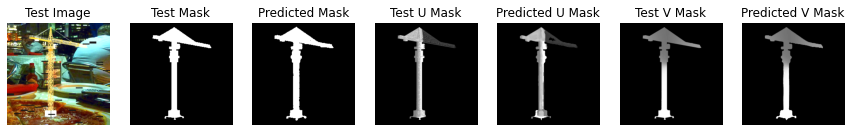

===> Epoch[199/200](0/500): Loss_Mask: 0.0131	Loss_U_Mask: 0.4664	Loss_V_Mask: 0.2074
===> Epoch[199/200](100/500): Loss_Mask: 0.0094	Loss_U_Mask: 0.4621	Loss_V_Mask: 0.1945
===> Epoch[199/200](200/500): Loss_Mask: 0.0119	Loss_U_Mask: 0.4002	Loss_V_Mask: 0.2009
===> Epoch[199/200](300/500): Loss_Mask: 0.0119	Loss_U_Mask: 0.5116	Loss_V_Mask: 0.2136
===> Epoch[199/200](400/500): Loss_Mask: 0.0163	Loss_U_Mask: 0.4696	Loss_V_Mask: 0.2116
===> Epoch[199/200](500/500): Loss_Mask: 0.0134	Loss_U_Mask: 0.4123	Loss_V_Mask: 0.2007
Val_Loss_Mask: 0.0257	Val_U_Loss_Mask: 0.4113	Val_V_Loss_Mask: 0.1759


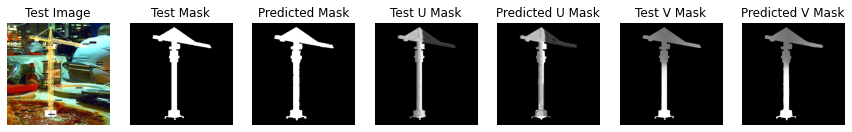

===> Epoch[200/200](0/500): Loss_Mask: 0.0170	Loss_U_Mask: 0.4765	Loss_V_Mask: 0.2100
===> Epoch[200/200](100/500): Loss_Mask: 0.0090	Loss_U_Mask: 0.3996	Loss_V_Mask: 0.1891
===> Epoch[200/200](200/500): Loss_Mask: 0.0093	Loss_U_Mask: 0.3858	Loss_V_Mask: 0.1780
===> Epoch[200/200](300/500): Loss_Mask: 0.0125	Loss_U_Mask: 0.4878	Loss_V_Mask: 0.1999
===> Epoch[200/200](400/500): Loss_Mask: 0.0082	Loss_U_Mask: 0.4153	Loss_V_Mask: 0.1938
===> Epoch[200/200](500/500): Loss_Mask: 0.0077	Loss_U_Mask: 0.3922	Loss_V_Mask: 0.1911
Val_Loss_Mask: 0.0256	Val_U_Loss_Mask: 0.4083	Val_V_Loss_Mask: 0.1736


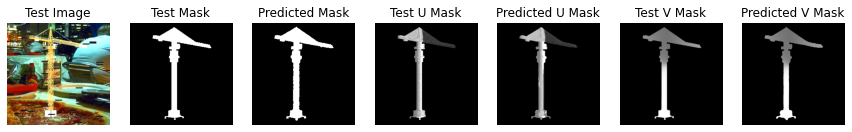

In [14]:
train_avg_mask_losses = []
val_avg_mask_losses = []
train_avg_u_mask_losses = []
val_avg_u_mask_losses = []
train_avg_v_mask_losses = []
val_avg_v_mask_losses = []


for epoch in range(params['epoch_count'], params['epochs'] + 1):
    # train
    correspondence_block.to(device).train()
    cut_num = 500 # 1epoch = cut_num x batch_size
    
    train_mask_losses = []
    val_mask_losses = []
    train_u_mask_losses = []
    val_u_mask_losses = []
    train_v_mask_losses = []
    val_v_mask_losses = []
    
    for iteration, (batch) in enumerate(train_data_loader):
        
        image, mask, u_mask, v_mask = batch[0].to(device), batch[1].to(device), batch[2].to(device), batch[3].to(device)
        mask_pred, u_mask_pred, v_mask_pred = correspondence_block(image)

        optimizer.zero_grad()
 
        #loss
        loss_m = criterion_m(mask_pred.type(torch.double), mask.type(torch.long))
        loss_u = criterion_u(u_mask_pred.type(torch.double), u_mask)
        loss_v = criterion_v(v_mask_pred.type(torch.double), v_mask)
        loss = loss_m + loss_u + loss_v
        
        loss.backward()
        optimizer.step()
        
        # loss values
        train_mask_losses.append(loss_m.item())
        train_u_mask_losses.append(loss_u.item())
        train_v_mask_losses.append(loss_v.item())

        if iteration % params['log_interval'] == 0:
            print("===> Epoch[{}/{}]({}/{}): Loss_Mask: {:.4f}\tLoss_U_Mask: {:.4f}\tLoss_V_Mask: {:.4f}".format(
                epoch, params['epochs'],iteration, cut_num, loss_m.item(), loss_u.item(), loss_v.item()))
        
        if iteration == cut_num:
            break
        
    # avg loss values for plot
    train_avg_mask_loss = torch.mean(torch.FloatTensor(train_mask_losses)) 
    train_avg_u_mask_loss = torch.mean(torch.FloatTensor(train_u_mask_losses))
    train_avg_v_mask_loss = torch.mean(torch.FloatTensor(train_v_mask_losses))
    train_avg_mask_losses.append(train_avg_mask_loss.item())
    train_avg_u_mask_losses.append(train_avg_u_mask_loss.item())
    train_avg_v_mask_losses.append(train_avg_v_mask_loss.item())

    correspondence_block.to(device).eval()
    
    with torch.no_grad():
        for iteration, (batch) in enumerate(val_data_loader):
            
            image, mask, u_mask, v_mask = batch[0].to(device), batch[1].to(device), batch[2].to(device), batch[3].to(device)
            mask_pred, u_mask_pred, v_mask_pred = correspondence_block(image)

            #loss
            loss_m = criterion_m(mask_pred.type(torch.double), mask.type(torch.long))
            loss_u = criterion_u(u_mask_pred.type(torch.double), u_mask)
            loss_v = criterion_v(v_mask_pred.type(torch.double), v_mask)
            loss = loss_m + loss_u + loss_v

            val_mask_losses.append(loss_m.item())
            val_u_mask_losses.append(loss_u.item())
            val_v_mask_losses.append(loss_v.item())
    
    # avg loss values for plot
    val_avg_mask_loss = torch.mean(torch.FloatTensor(val_mask_losses))
    val_avg_u_mask_loss = torch.mean(torch.FloatTensor(val_u_mask_losses))
    val_avg_v_mask_loss = torch.mean(torch.FloatTensor(val_v_mask_losses))
    val_avg_mask_losses.append(val_avg_mask_loss.item())
    val_avg_u_mask_losses.append(val_avg_u_mask_loss.item())
    val_avg_v_mask_losses.append(val_avg_v_mask_loss.item())
    
    print("Val_Loss_Mask: {:.4f}\tVal_U_Loss_Mask: {:.4f}\tVal_V_Loss_Mask: {:.4f}".format(val_avg_mask_loss.item(),
            val_avg_u_mask_loss.item(), val_avg_v_mask_loss.item()))
    
    # Show result for test image
    image = val_image.to(device)
    mask = val_mask.to(device)
    u_mask = val_u_mask.to(device)
    v_mask = val_v_mask.to(device)
    mask_pred, u_mask_pred, v_mask_pred = correspondence_block(image)
    
    plot_train_result([image, mask, mask_pred, u_mask, u_mask_pred, v_mask, v_mask_pred], epoch, save=False)
    
    # Save weight
    if epoch % 1 == 0:
        torch.save(correspondence_block.state_dict(), checkpoint_path+'/cpb-%s.pt'%epoch)

In [15]:
print('Mask Loss :',np.array(val_avg_mask_losses).argmin()+1, val_avg_mask_losses[np.array(val_avg_mask_losses).argmin()],
      '\tU Mask Loss :',np.array(val_avg_u_mask_losses).argmin()+1, val_avg_u_mask_losses[np.array(val_avg_u_mask_losses).argmin()],
      '\tV Mask Loss :',np.array(val_avg_v_mask_losses).argmin()+1, val_avg_v_mask_losses[np.array(val_avg_v_mask_losses).argmin()])

Mask Loss : 190 0.02141021005809307 	U Mask Loss : 119 0.398998886346817 	V Mask Loss : 190 0.17092983424663544


# Loss Curve

In [23]:
csvfile=open('./loss/train_u_mask_loss_cpb_unet2.csv','w', newline="")
csvwriter = csv.writer(csvfile)

for row in np.array(train_avg_u_mask_losses).reshape(len(train_avg_u_mask_losses),1):
    csvwriter.writerow(row)
    
csvfile.close()

csvfile=open('./loss/val_u_mask_loss_cpb_unet2.csv','w', newline="")
csvwriter = csv.writer(csvfile)

for row in np.array(val_avg_u_mask_losses).reshape(len(val_avg_u_mask_losses),1):
    csvwriter.writerow(row)
    
csvfile.close()
                    
csvfile=open('./loss/train_v_mask_loss_cpb_unet2.csv','w', newline="")
csvwriter = csv.writer(csvfile)

for row in np.array(train_avg_v_mask_losses).reshape(len(train_avg_v_mask_losses),1):
    csvwriter.writerow(row)
    
csvfile.close()

csvfile=open('./loss/val_v_mask_loss_cpb_unet2.csv','w', newline="")
csvwriter = csv.writer(csvfile)

for row in np.array(val_avg_v_mask_losses).reshape(len(val_avg_v_mask_losses),1):
    csvwriter.writerow(row)
    
csvfile.close()

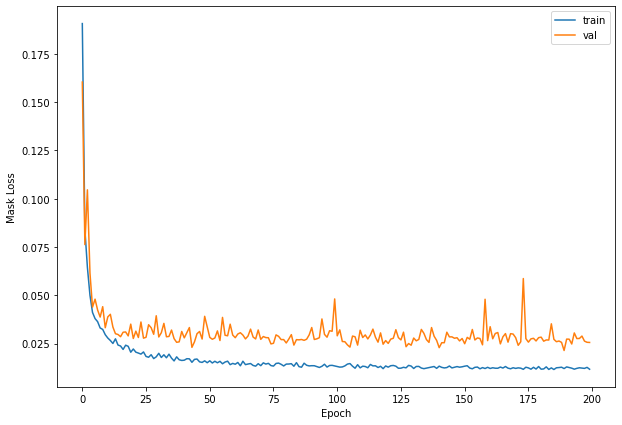

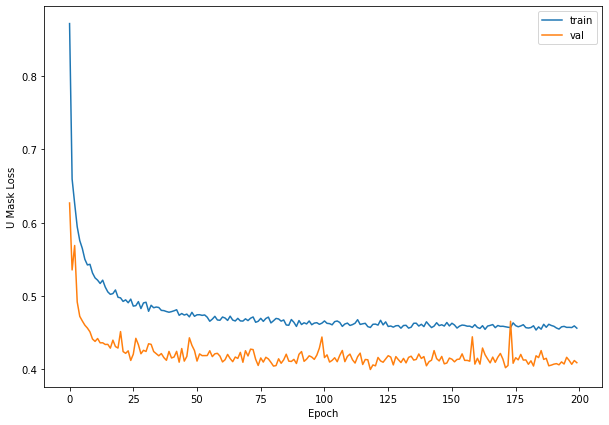

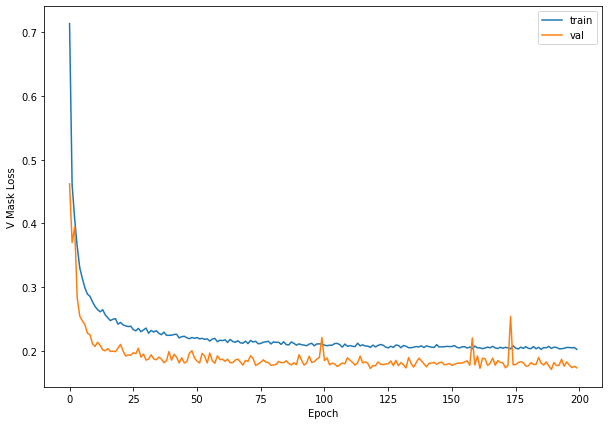

In [16]:
plt.figure(figsize=(10,7))
plt.plot(train_avg_mask_losses, label='train')
plt.plot(val_avg_mask_losses, label='val')
plt.xlabel('Epoch')
plt.ylabel('Mask Loss')
plt.legend()

plt.figure(figsize=(10,7))
plt.plot(train_avg_u_mask_losses, label='train')
plt.plot(val_avg_u_mask_losses, label='val')
plt.xlabel('Epoch')
plt.ylabel('U Mask Loss')
plt.legend()

plt.figure(figsize=(10,7))
plt.plot(train_avg_v_mask_losses, label='train')
plt.plot(val_avg_v_mask_losses, label='val')
plt.xlabel('Epoch')
plt.ylabel('V Mask Loss')
plt.legend()

# Restore Checkpoint

In [25]:
weight_dict = torch.load(checkpoint_path+'/cpb-190.pt')

In [26]:
correspondence_block.load_state_dict(weight_dict)

<All keys matched successfully>

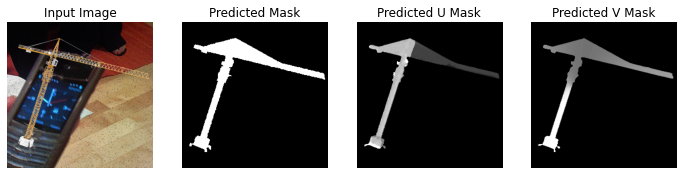

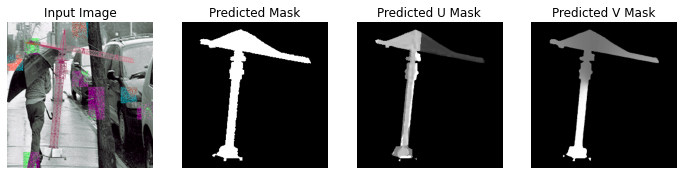

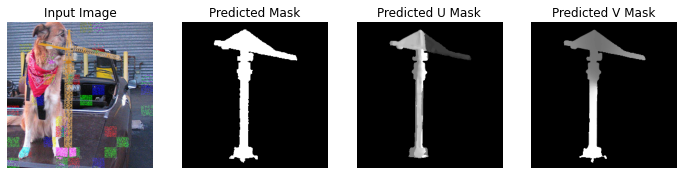

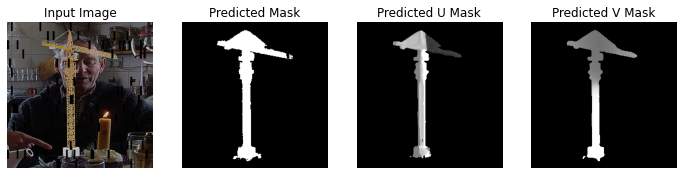

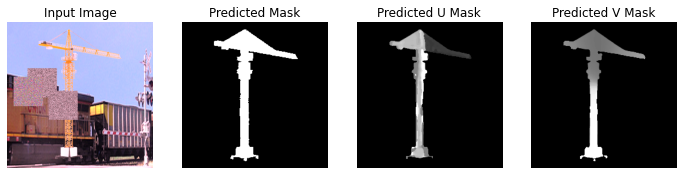

...

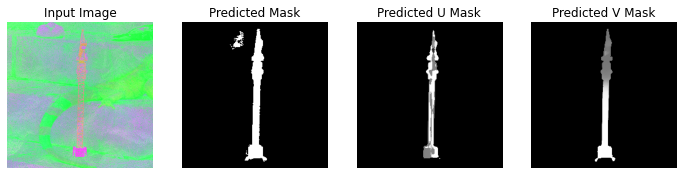

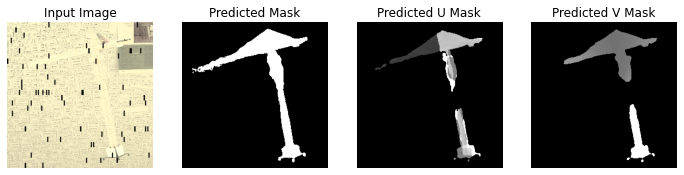

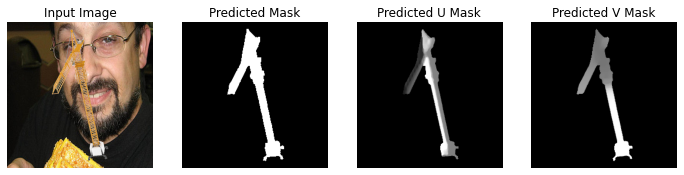

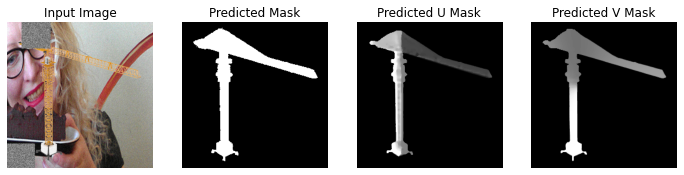

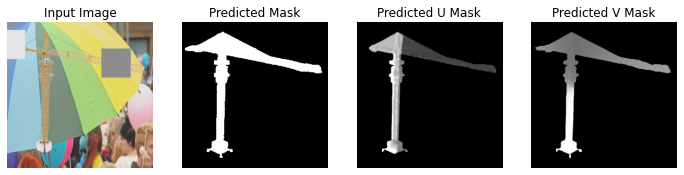

In [27]:
for path in train_image_paths[:50]:
    visualization(correspondence_block, path)

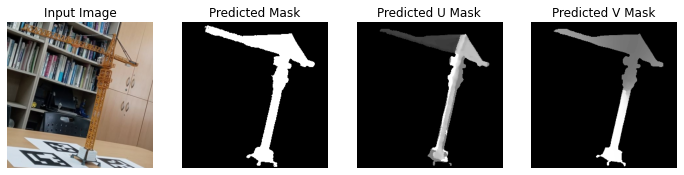

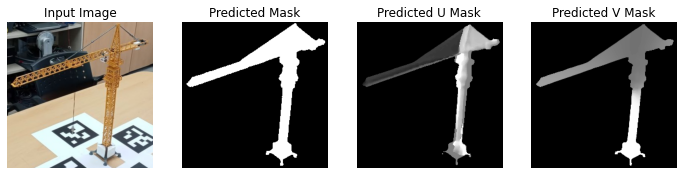

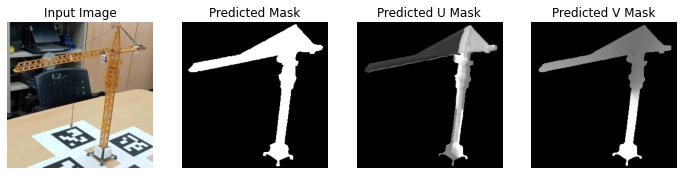

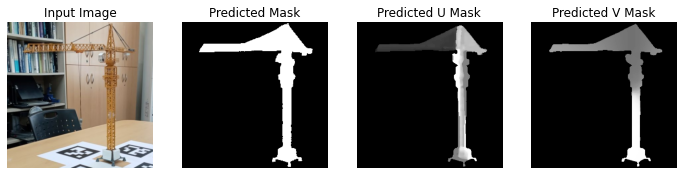

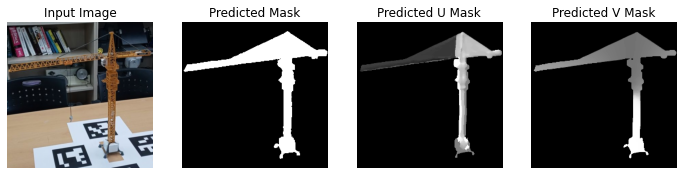

...

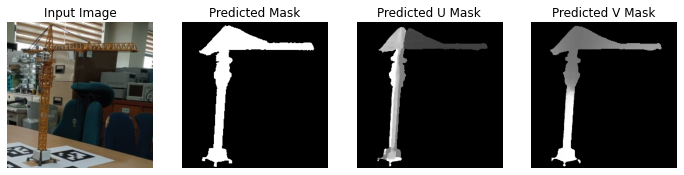

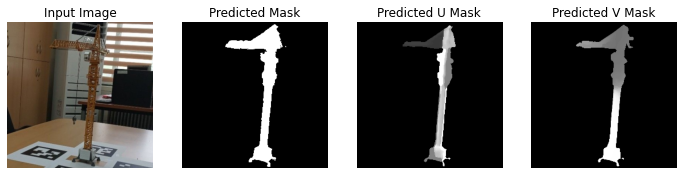

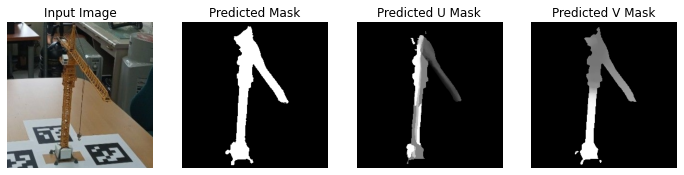

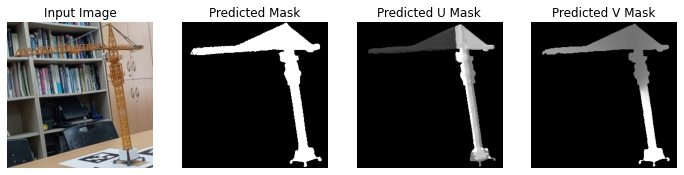

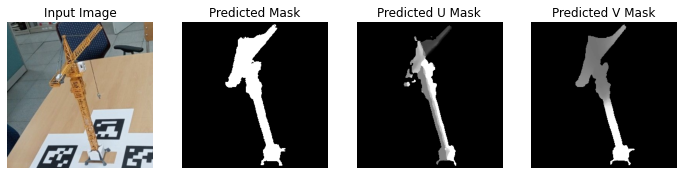

In [28]:
test_path = glob('C:/Users/IVCL/Desktop/crane/real_image_crop/*.png')
for path in test_path:
    visualization(correspondence_block, path)